<a href="https://colab.research.google.com/github/inagetsutomu/lab/blob/main/SampleRotateOblique.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# モジュール

In [1]:
from google.colab import drive
drive.mount('./drive')
drive_root_dir="./drive/My Drive"
import os
!ls
os.chdir(drive_root_dir)

Mounted at ./drive
drive  sample_data


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import itertools
import os
import cv2
import random
import time
from PIL import Image
from tqdm import tqdm
import tensorflow as tf
import mainLAB.image_rotate as tfa
from datetime import datetime
import re
import scipy.ndimage as ndimage
from skimage import data, img_as_float
from skimage.restoration import denoise_nl_means, estimate_sigma
from skimage.metrics import peak_signal_noise_ratio
from skimage.util import random_noise
from skimage.restoration import unwrap_phase
from skimage.util import view_as_windows
from skimage import io, color, filters
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, Input, Activation, BatchNormalization, Dense, MaxPooling2D, Conv2DTranspose

# 自作関数

In [3]:
output_gif = "animated.gif"

In [4]:
def save_gif(dir, flame=1000,loop=0):
    image_folder = dir + "/images"
    output_dir = os.path.join(dir, "animation.gif")
    # 拡張子が .png または .tif の画像を読み込む（昇順でソート）
    image_files = sorted([f for f in os.listdir(image_folder) if f.endswith(('.png', '.tif', '.jpg'))],
                         key=extract_number)

    # フルパスに変換して画像を読み込み
    images = [Image.open(os.path.join(image_folder, f)) for f in image_files]

    # GIFとして保存（ループあり、各フレーム200ms）
    images[0].save(output_dir,
                save_all=True,
                append_images=images[1:],
                duration=flame,   # 各フレーム表示時間（ms）
                loop=loop)



# 数値をキーにして自然順でソート
def extract_number(filename):
    match = re.search(r'\d+', filename)
    return int(match.group()) if match else -1

# 2次元配列を画像で保存する関数
def save_tif(data,title,path):
    data=Image.fromarray(data)
    data.save("./"+ path + "/" + title + ".tif")

def img_coherent(pupil, noise=True, defocus=0.0, thetaX=0.0, thetaY=0.0):
    object_img = obA * np.exp(obP * 1j)
    object_imgFT = np.fft.fftshift(np.fft.fft2(object_img))
    imSeqLowFT = object_imgFT * pupil
    exp_field = np.fft.ifft2(np.fft.ifftshift(imSeqLowFT))
    exp_field = ASM_tf(exp_field, pixel_size, defocus, xlambda)
    exp_intensity = np.abs(exp_field)**2

    if noise:
      scale = np.max(exp_intensity)
      exp_intensity = photon * exp_intensity/scale
      exp_intensity = np.abs(addGaussianNoise(exp_intensity))
      exp_intensity = exp_intensity/photon*scale

      #ノイズ処理
      exp_intensity = np.expand_dims(exp_intensity, axis=-1)
      sigma_est = np.mean(estimate_sigma(exp_intensity, channel_axis=-1))
      patch_kw = dict(
          patch_size=5,
          patch_distance=6,
          channel_axis=-1)
      exp_intensity = denoise_nl_means(
          exp_intensity, h=0.6 * sigma_est, sigma=sigma_est, fast_mode=True, **patch_kw)
      exp_intensity /= np.max(exp_intensity)
      return exp_intensity


def img_microscope(pupil):
    object_img = obA * np.exp(obP * 1j)
    object_imgFT = np.fft.fftshift(np.fft.fft2(object_img))
    imSeqLowFT = object_imgFT * pupil
    exp_field = np.fft.ifft2(np.fft.ifftshift(imSeqLowFT))
    exp_intensity = np.abs(exp_field)**2
    return exp_intensity

def psf(pupil):
  exp_field = np.fft.fftshift(np.fft.fft2(np.fft.fftshift(pupil)))
  exp_intensity = np.abs(exp_field)**2
  return exp_intensity

# 最終的な推定画像に使う合成開口のローパスフィルター
def lowpass(img):
    return abs(np.fft.ifft2(np.fft.ifftshift( AS_mask * np.fft.fftshift(np.fft.fft2(img)) )))

# ガウシアンノイズを与える関数
def addGaussianNoise(src):
    row,col= src.shape
    mean = 0
    sigma = np.sqrt(src)
    gauss = np.random.normal(mean,sigma,(row,col))
    gauss = gauss.reshape(row,col)
    noisy = src + gauss
    return noisy

# 2Dフーリエ変換
def FT(f):
    return np.fft.fftshift(np.fft.fft2(np.fft.fftshift(f)))

# 2D逆フーリエ変換
def iFT(f):
    return np.fft.fftshift(np.fft.ifft2(np.fft.fftshift(f)))

# 平面波展開（TensorFlow用）
def ASM_tf(input_field, pixel_size, dz, xlambda):
    input_shape = input_field.shape
    # 周波数座標
    dfx = 1.0 / (pixel_size * input_shape[1])
    dfy = 1.0 / (pixel_size * input_shape[0])
    fx = np.arange(-input_shape[1] / 2, input_shape[1] / 2) * dfx
    fy = np.arange(-input_shape[0] / 2, input_shape[0] / 2) * dfy
    fx = tf.constant(fx, dtype=tf.float32)
    fy = tf.constant(fy, dtype=tf.float32)
    fx_mesh, fy_mesh = tf.meshgrid(fx, fy)
    fz2 = 1.0 / xlambda ** 2 - fx_mesh ** 2 - fy_mesh ** 2
    fz2 = tf.where(fz2 > 0.0, fz2, 0.0)
    fz = tf.sqrt(fz2)
    # 伝達関数Hの計算
    H_phase = 2 * np.pi * fz * dz
    H = tf.complex(tf.cos(H_phase), tf.sin(H_phase))

    # 伝搬計算本体
    fft_input = tf.signal.fftshift(tf.signal.fft2d(input_field))
    fft_output = fft_input * H
    output = tf.signal.ifft2d(tf.signal.ifftshift(fft_output))
    return output

# Legendre多項式の基底関数を作成する関数．引数：(最大次数，X_mesh, Y_mesh)
def legendre2D( deg, X, Y ):
    m,n     = X.shape
    npol    = int(0.5*(deg+1)*(deg+2))
    B       = np.zeros((npol,m,n))
    for i in np.arange(deg+1):
        for k in np.arange(i+1):
            cx                  = np.random.rand(i+1) * 2 -1
            cy                  = np.random.rand(i+1) * 2 -1
            cx[i-k]             = 1
            cy[k]               = 1
            B[int(i*(i+1)/2)+k] = np.polynomial.legendre.legval(X,cx)*np.polynomial.legendre.legval(Y,cy)
    B[0] = 0*B[0]
    B[1] = 0*B[1]
    B[2] = 0*B[2]
    return B

# Legendre多項式の基底関数を作成する関数．引数：(最大次数，X_mesh, Y_mesh)
def legendreBasis2D( deg, X, Y ):
    m,n     = X.shape
    npol    = int(0.5*(deg+1)*(deg+2))
    B       = np.zeros((npol,m,n))
    for i in np.arange(deg+1):
        for k in np.arange(i+1):
            cx                  = np.zeros(i+1)
            cy                  = np.zeros(i+1)
            cx[i-k]             = 1
            cy[k]               = 1
            B[int(i*(i+1)/2)+k] = np.polynomial.legendre.legval(X,cx)*np.polynomial.legendre.legval(Y,cy)
    B[0] = 0*B[0]
    B[1] = 0*B[1]
    B[2] = 0*B[2]
    return B

# 基底関数と係数から波面を作る関数
def polyEval2D( coef, basis ):
    coef = np.array(coef)
    coef = np.expand_dims(np.expand_dims(coef, -1), -1)
    pupil = np.sum(coef*basis, axis=0)
    # coef = tf.reshape(coef, [-1, 1, 1])
    # pupil = tf.reduce_sum(basis*coef, axis=0)
    return pupil

# 位置ずれ補正用Legendre多項式（１次関数のみ）
def Legendre_shift(z,x,y):
    out = 5*z[0]*(1.7321*x) + \
          5*z[1]*(1.7321*y)
    return out

# SSIMでLossを計算する関数．（普通にMSEなどでlossをとるよりSSIMでとる方が推定がうまくいく場合が多い．）
def ssim_loss(y_true, y_pred):
    ssim = tf.image.ssim(y_true, y_pred, max_val=1, filter_size=11, filter_sigma=1.5, k1=0.01, k2=0.03 )
    return ssim

def generate_coef_with_norm(norm, mode):
    numbers = np.random.rand(mode) * 2 * norm - norm
    current_norm = np.linalg.norm(numbers)
    numbers = numbers * (norm / current_norm)
    return numbers.tolist()


def make_wavefront(coef):# 瞳関数の作成
    pupil = np.array(polyEval2D(coef, B)) * CTF
    # pupil = np.clip(pupil, -np.pi, np.pi)
    pupil = (np.cos(pupil) + 1.0j*np.sin(pupil)) * CTF
    return pupil

def make_wavefront_oblique(coef, theta_x, theta_y, pixel_size=16*1e-9, m=512, NA=1.5e-3, xlambda=(12.4/9.884)*1e-10):# 瞳関数の作成
    aperture = pixel_size * m * 2.0 * np.tan(NA)/xlambda     # [pixel]

    shift_x = pixel_size * m * 2.0 * np.tan(theta_x)/xlambda     # [pixel]
    shift_x = int(shift_x)

    shift_y = pixel_size * m * 2.0 * np.tan(theta_y)/xlambda     # [pixel]
    shift_y = int(shift_y)

    # 開口マスク作成
    CTF = np.zeros((n,m))
    CTF[n//2-int(aperture//2) : n//2 + int(aperture//2),
        m//2-int(aperture//2) : m//2+int(aperture//2)] = 1.0
    # plt.subplot(1,2,1)
    # plt.title("CTF")
    # plt.imshow(CTF)
    # plt.show()
    # plt.imshow(np.array(polyEval2D(coef, B)))
    # plt.colorbar()
    # plt.show()

    pupil = np.array(polyEval2D(coef, B)) * CTF
    # pupil = np.clip(pupil, -np.pi, np.pi)
    pupil = (np.cos(pupil) + 1.0j*np.sin(pupil)) * CTF
    pupil = np.roll(pupil, (shift_x, shift_y), axis = (0, 1))
    return pupil


def ssim_culc(pupil, angle = 2*np.pi/4):
    rot_A = np.array(tfa.rotate(obA, tf.constant(-1.0*0)))
    rot_P = np.array(tfa.rotate(obP, tf.constant(-1.0*0)))
    # コヒーレント結像
    object_img = rot_A * np.exp(rot_P * 1j)
    object_imgFT = np.fft.fftshift(np.fft.fft2(object_img))
    imSeqLowFT = object_imgFT * pupil
    exp_field = np.fft.ifft2(np.fft.ifftshift(imSeqLowFT))
    exp_intensity = np.abs(exp_field)**2
    img_out = np.sqrt(exp_intensity)
    img_out = img_out #[imax//2-int(363//2) : imax//2+int(363//2),jmax//2-int(363//2) : jmax//2+int(363//2)]
    # plt.imshow(img_out,cmap='gray')
    # plt.colorbar()
    # plt.show()

    rot_A = np.array(tfa.rotate(obA, tf.constant(-1.0*angle)))
    rot_P = np.array(tfa.rotate(obP, tf.constant(-1.0*angle)))
    # コヒーレント結像
    object_rot = rot_A * np.exp(rot_P * 1j)
    object_rotFT = np.fft.fftshift(np.fft.fft2(object_rot))
    imSeqLow_rotFT = object_rotFT * pupil
    exp_field_rot = np.fft.ifft2(np.fft.ifftshift(imSeqLow_rotFT))
    exp_intensity_rot = np.abs(exp_field_rot)**2
    img_rot = np.sqrt(exp_intensity_rot)
    img_rot = img_rot #[imax//2-int(363//2) : imax//2+int(363//2),jmax//2-int(363//2) : jmax//2+int(363//2)]
    img_rot = np.array(tfa.rotate(img_rot, tf.constant(angle)))
    # plt.imshow(img_rot,cmap='gray')
    # plt.colorbar()
    # plt.show()
    img_cul0 = tf.expand_dims(img_out, axis=-1)
    img_cul1 = tf.expand_dims(img_rot, axis=-1)
    score = ssim_loss(img_cul0, img_cul1).numpy()
    return score.item()

def rms_calculate(pupil):
  return np.sqrt(np.mean(np.angle(pupil[n//2-int(aperture//2) : n//2+int(aperture//2),m//2-int(aperture//2) : m//2+int(aperture//2)])**2))

def ssim_culc2_8_filter(pupil,rot_angle=20,crop_size=256):
  img_total = np.zeros((crop_size, crop_size))
  angle = 2*np.pi/(360/rot_angle)
  angle_num = int(360/rot_angle)
  img_list = []
  angle_list=[]
  for i in range(angle_num):
    angle_list.append(i*rot_angle)
    rot_A = np.array(tfa.rotate(obA, tf.constant(-1.0 * i * angle)))
    rot_P = np.array(tfa.rotate(obP, tf.constant(-1.0 * i * angle)))
    # コヒーレント結像
    object_img = rot_A * np.exp(rot_P * 1j)
    object_imgFT = np.fft.fftshift(np.fft.fft2(object_img))
    imSeqLowFT = object_imgFT * pupil
    exp_field = np.fft.ifft2(np.fft.ifftshift(imSeqLowFT))

    # 面ブレを考慮したデフォーカスを与える．
    dz = -40.0 *1e-6
    exp_field = ASM_tf(exp_field, pixel_size, dz, xlambda)


    exp_intensity = np.abs(exp_field)**2
    scale = np.max(exp_intensity)
    exp_intensity = photon * exp_intensity/scale
    exp_intensity = np.abs(addGaussianNoise(exp_intensity))
    exp_intensity = exp_intensity/photon*scale

    # exp_intensity = ndimage.median_filter(exp_intensity)

    #ノイズ除去
    exp_intensity = np.expand_dims(exp_intensity, axis=-1)
    sigma_est = np.mean(estimate_sigma(exp_intensity, channel_axis=-1))

    patch_kw = dict(
        patch_size=5,  # 5x5 patches
        patch_distance=6,  # 13x13 search area
        channel_axis=-1,
    )

    # fast algorithm, sigma provided
    exp_intensity = denoise_nl_means(
        exp_intensity, h=0.6 * sigma_est, sigma=sigma_est, fast_mode=True, **patch_kw
    )

    exp_intensity = np.array(tfa.rotate(exp_intensity, tf.constant(i * angle)))
    img_out = exp_intensity[imax//2-int(crop_size//2) : imax//2+int(crop_size//2),
                            jmax//2-int(crop_size//2) : jmax//2+int(crop_size//2)]
    img_list.append(img_out)
    img_total += img_out
  img_total /= angle_num
  # plt.imshow(img_total, cmap="gray")
  # plt.colorbar()
  # plt.show()


  #スコアの計算
  score_list=[]
  img_total_culc = tf.expand_dims(img_total, axis=-1)

  for img in img_list:
    img_culc = tf.expand_dims(img, axis=-1)
    score = tf.image.ssim(img_total_culc, img_culc, max_val=1, filter_size=11, filter_sigma=1.5, k1=0.01, k2=0.03)
    score_list.append(score.numpy())
  score_arr = np.array(score_list)
  score_sigma = np.std(score_arr)
  return np.mean(score_list)

  #コントラスト計算
  # img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
  # cont = np.std(np.abs(img_dif))
  # return cont



def sliding_variance(arr: np.ndarray,
                     window_shape: tuple[int,int],
                     step: int = 1) -> np.ndarray:
    """
    arr: 2D の入力配列
    window_shape: (wh, ww) ウィンドウの高さと幅
    step: ウィンドウを動かすピクセル数
    return: 各ウィンドウ位置の分散マップ
    """
    wh, ww = window_shape
    # view_as_windows でスライド窓を作成
    windows = view_as_windows(arr, window_shape, step=step)
    # windows の形は (out_h, out_w, wh, ww)
    # 各 (wh,ww) の分散をとる
    var_map = windows.var(axis=(2,3))
    return var_map

# 例:
img = np.random.rand(100, 100)
var_sliding = sliding_variance(img, (10, 10), step=5)
print(var_sliding.shape)  # -> ((100-10)//5+1, (100-10)//5+1)


(19, 19)


In [5]:
def FT(f):
    return np.fft.fftshift(np.fft.fft2(np.fft.fftshift(f)))
def iFT(f):
    return np.fft.fftshift(np.fft.ifft2(np.fft.fftshift(f)))

def img_random(img, angle, center, size):
#   error=(random.randrange(-1,2,2)*random.uniform(0,center[0]*5//100),random.randrange(-1,2,2)*random.uniform(0,center[1]*5//100))#位置ずれ
  error=(random.randrange(-1,2,2)*random.uniform(0,center[0]*0),random.randrange(-1,2,2)*random.uniform(0,center[1]*0))#位置ずれなし
  rot_mat = cv2.getRotationMatrix2D((int(center[0]),int(center[1])), angle, 1.0) #cv.getRotationMatrix2D(center回転中心, angle回転角度(度), scale（拡大倍率）)
  rot_mat[0][2] += -center[0]+error[0]+size[0]/2 #（x軸について）-(元画像内での中心位置)+誤差+(切り抜きたいサイズの中心)
  rot_mat[1][2] += -center[1]+error[1]+size[1]/2 #（y軸について）同上
  return cv2.warpAffine(img, rot_mat, size)

def ASM_pytorch(input_field, pixel_size, dz, xlambda):
    # NumPy配列をPyTorchテンソルに変換
    input_field = torch.tensor(input_field, dtype=torch.complex64)

    input_shape = input_field.shape
    # 周波数座標
    dfx = 1.0 / (pixel_size * input_shape[1])
    dfy = 1.0 / (pixel_size * input_shape[0])
    fx = np.arange(-input_shape[1] / 2, input_shape[1] / 2) * dfx
    fy = np.arange(-input_shape[0] / 2, input_shape[0] / 2) * dfy
    fx = torch.tensor(fx, dtype=torch.float32)
    fy = torch.tensor(fy, dtype=torch.float32)
    fx_mesh, fy_mesh = torch.meshgrid(fx, fy)
    fz2 = 1.0 / xlambda ** 2 - fx_mesh ** 2 - fy_mesh ** 2
    fz2 = torch.where(fz2 > 0.0, fz2, torch.tensor(0.0))
    fz = torch.sqrt(fz2)
    # 伝達関数Hの計算
    H_phase = 2 * np.pi * fz * dz
    H = torch.complex(torch.cos(H_phase), torch.sin(H_phase))

    # 伝搬計算本体
    fft_input = torch.fft.fftshift(torch.fft.fft2(input_field))
    fft_output = fft_input * H
    output = torch.fft.ifft2(torch.fft.ifftshift(fft_output))

    # PyTorchテンソルをNumPy配列に変換して返す
    return output.cpu().numpy()

def addGaussianNoise(src):
    row,col= src.shape
    mean = 0
    sigma = np.sqrt(src)
    gauss = np.random.normal(mean,sigma,(row,col))
    gauss = gauss.reshape(row,col)
    noisy = src + gauss
    return noisy

def noise(exp_intensity,photon):
    scale = np.max(exp_intensity)
    exp_intensity = photon * exp_intensity/scale
    exp_intensity = np.abs(addGaussianNoise(exp_intensity))
    exp_intensity = exp_intensity/photon*scale
    return exp_intensity

def applyGaussianBlur(src, sigma):
    # Apply Gaussian filter using scipy
    blurred = gaussian_filter(src, sigma=sigma)
    return blurred

def defocus_noise(max_value, error_rate):
    """
    スカラー値に指定された割合のランダムな誤差を追加する。

    Parameters:
    value (float): 元のスカラー値
    error_rate (float): 誤差の割合 (デフォルトは2%)

    Returns:
    float: 誤差を追加した値
    """
    # ノイズを生成
    noise = np.random.normal(0, error_rate)

    # ノイズを追加
    value_with_error = max_value*noise

    return value_with_error

def img_save(img,name,folder):
  if not os.path.exists(folder):  # ディレクトリが存在しない場合、作成する。
    os.makedirs(folder)
  Image.fromarray(img).save(folder+"/"+name+".tif")

def Legendre_aberration(z,x,y):

    if len(z) != 21:
        z.extend([0.0 for i in range(21-len(z))])
    out = 0*z[0] + \
          0*z[1]*(1.7321*x) + \
          0*z[2]*(1.7321*y) + \
          z[3]*(3.3541*x**2-1.1180) + \
          z[4]*(3.0*x*y) + \
          z[5]*(3.3541*y**2-1.1180) + \
          z[6]*(6.6144*x**3-3.9686*x) + \
          z[7]*(5.8095*y*x**2-1.9365*y) + \
          z[8]*(5.8095*x*y**2-1.9365*x) + \
          z[9]*(6.6144*y**3-3.9686*y) + \
          z[10]*(13.125*x**4-11.25*x**2+1.125) + \
          z[11]*(11.4564*x**3*y-6.8739*x*y) + \
          z[12]*(11.25*x**2*y**2-3.75*x**2-3.75*y**2+1.25) + \
          z[13]*(11.4564*x*y**3-6.8739*x*y) + \
          z[14]*(13.125*y**4-11.25*y**2+1.125) + \
          z[15]*(26.1184*x**5-29.0205*x**3+6.2187*x) + \
          z[16]*(22.7332*x**4*y-19.4856*x**2*y+1.9486*y) + \
          z[17]*(22.1853*x**3*y**2-7.3951*x**3-13.3112*x*y**2+4.4371*x) + \
          z[18]*(22.1853*y**3*x**2-7.3951*y**3-13.3112*y*x**2+4.4371*y) + \
          z[19]*(22.7332*x*y**4-19.4856*x*y**2+1.9486*x) + \
          z[20]*(26.1184*y**5-29.0205*y**3+6.2187*y)
    return out

def Legendre_basis(x,y):
    basis_list = []
    basis_list.append(0*np.ones(x.shape))
    basis_list.append(0*1.7321*x)
    basis_list.append(0*1.7321*y)
    basis_list.append(3.3541*x**2-1.1180)
    basis_list.append(3.0*x*y)
    basis_list.append(3.3541*y**2-1.1180)
    basis_list.append(6.6144*x**3-3.9686*x)
    basis_list.append(5.8095*y*x**2-1.9365*y)
    basis_list.append(5.8095*x*y**2-1.9365*x)
    basis_list.append(6.6144*y**3-3.9686*y)
    basis_list.append(13.125*x**4-11.25*x**2+1.125)
    basis_list.append(11.4564*x**3*y-6.8739*x*y)
    basis_list.append(11.25*x**2*y**2-3.75*x**2-3.75*y**2+1.25)
    basis_list.append(11.4564*x*y**3-6.8739*x*y)
    basis_list.append(13.125*y**4-11.25*y**2+1.125)
    basis_list.append(26.1184*x**5-29.0205*x**3+6.2187*x)
    basis_list.append(22.7332*x**4*y-19.4856*x**2*y+1.9486*y)
    basis_list.append(22.1853*x**3*y**2-7.3951*x**3-13.3112*x*y**2+4.4371*x)
    basis_list.append(22.1853*y**3*x**2-7.3951*y**3-13.3112*y*x**2+4.4371*y)
    basis_list.append(22.7332*x*y**4-19.4856*x*y**2+1.9486*x)
    basis_list.append(26.1184*y**5-29.0205*y**3+6.2187*y)
    return np.array(basis_list)



In [6]:
def Legendre_basis_6(x, y):
    basis_list = []
    basis_list.append(0*np.ones(x.shape))  # dummy mode 0
    basis_list.append(1.7321*x)
    basis_list.append(1.7321*y)
    basis_list.append(3.3541*x**2-1.1180)
    basis_list.append(3.0*x*y)
    basis_list.append(3.3541*y**2-1.1180)
    basis_list.append(6.6144*x**3-3.9686*x)
    basis_list.append(5.8095*x**2*y-1.9365*y)
    basis_list.append(5.8095*x*y**2-1.9365*x)
    basis_list.append(6.6144*y**3-3.9686*y)
    basis_list.append(13.125*x**4-11.25*x**2+1.125)
    basis_list.append(11.4564*x**3*y-6.8739*x*y)
    basis_list.append(11.25*x**2*y**2 - 3.75*x**2 - 3.75*y**2 + 1.25)
    basis_list.append(11.4564*x*y**3 - 6.8739*x*y)
    basis_list.append(13.125*y**4 - 11.25*y**2 + 1.125)
    basis_list.append(26.1184*x**5 - 29.0205*x**3 + 6.2187*x)
    basis_list.append(22.7332*x**4*y - 19.4856*x**2*y + 1.9486*y)
    basis_list.append(22.1853*x**3*y**2 - 7.3951*x**3 - 13.3112*x*y**2 + 4.4371*x)
    basis_list.append(22.1853*x**2*y**3 - 7.3951*y**3 - 13.3112*x**2*y + 4.4371*y)
    basis_list.append(22.7332*x*y**4 - 19.4856*x*y**2 + 1.9486*x)
    basis_list.append(26.1184*y**5 - 29.0205*y**3 + 6.2187*y)

    basis_list.append(52.0551*x**6 - 70.9843*x**4 + 23.6614*x**2 - 1.1267)  # L_60
    basis_list.append(45.2384*x**5*y - 50.2649*x**3*y + 10.7711*x*y)        # あやふや
    basis_list.append(44.0524*x**4*y**2 - 51.5292*x**2*y**2 + 18.1300*y**2 - 1.0737)  # あやふや
    basis_list.append(37.9628*x**3*y**3 - 30.3709*x*y**3 - 30.3709*x**3*y + 6.0382*x*y)  #あやふや
    basis_list.append(44.0524*x**2*y**4 - 51.5292*x**2*y**2 + 18.1300*x**2 - 1.0737)  # あやふや
    basis_list.append(45.2384*x*y**5 - 50.2649*x*y**3 + 10.7711*x*y)        # あやふや
    basis_list.append(52.0551*y**6 - 70.9843*y**4 + 23.6614*y**2 - 1.1267)  # L_06
    return np.array(basis_list)


# シミュレーション条件の設定

In [7]:
m = 512                 # 画像サイズ（横）
n = 512                 # 画像サイズ（縦）
rot_angle = 2*np.pi/90   # 1step回転角度
noise_flag = True       # ノイズを付与するかどうかのflag

xlambda = (12.4/9.884)*1e-10               # 波長. [m]
pixel_size = 16*1e-9                       # ピクセルサイズ. [m]
NA = 1.5e-3
thickness = 500.0e-9                       # スターチャート厚み. [m]
refraction = -1.96838E-05+4.074499E-06j    # 屈折率．Ta:9.884keV
coef_w = 6     # Legendre多項式の係数幅

photon = 500      # 光子数
max_shift = 6     # 位置ズレ最大. [pixel]
max_defocus = 50  # 最大面ブレ量. [um]

maxD    = 6                    # Legendre多項式の最大次数
mode = (maxD+1)*(maxD+2)//2     # Legendre modeの数
print("Legendre dimension, mode : ", str(maxD) + ", " + str(mode))

target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(10)]   # Legendre多項式の係数

coef = [0.0] * mode
coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target
# coef[21], coef[27] = 2.0, 2.0

epoch = 3000    # 学習エポック数
tp = 100        # 描画エポック数
lr = 0.1        # 学習率

Legendre dimension, mode :  6, 28


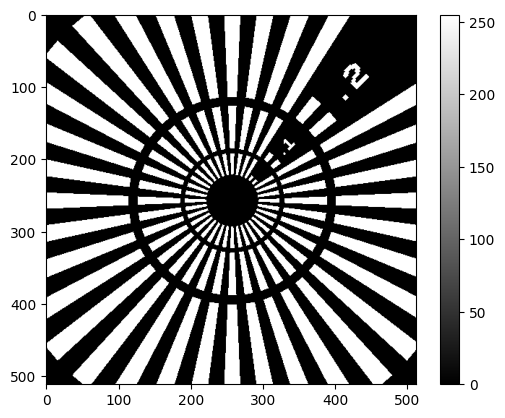

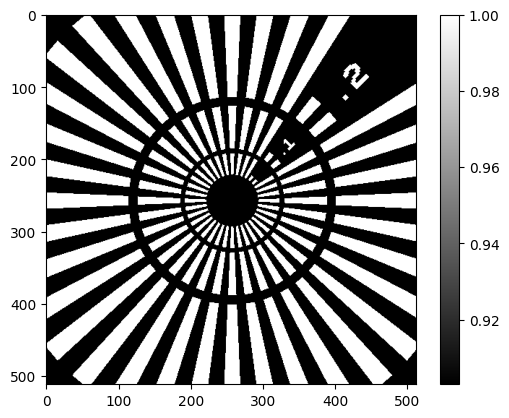

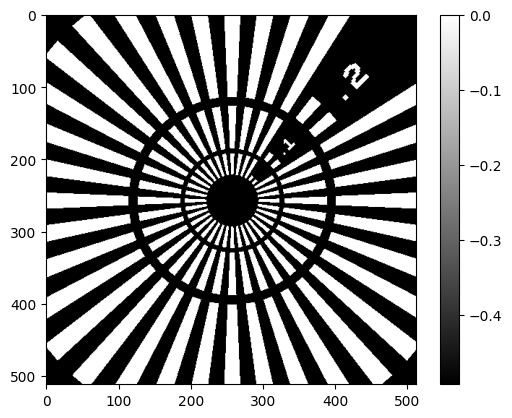

aperture [pix] :  195
[-2.61364973 -2.60342018 -2.59319064 -2.58296109 -2.57273154 -2.56250199
 -2.55227244 -2.54204289 -2.53181334 -2.52158379 -2.51135424 -2.5011247
 -2.49089515 -2.4806656  -2.47043605 -2.4602065  -2.44997695 -2.4397474
 -2.42951785 -2.4192883  -2.40905876 -2.39882921 -2.38859966 -2.37837011
 -2.36814056 -2.35791101 -2.34768146 -2.33745191 -2.32722236 -2.31699282
 -2.30676327 -2.29653372 -2.28630417 -2.27607462 -2.26584507 -2.25561552
 -2.24538597 -2.23515643 -2.22492688 -2.21469733 -2.20446778 -2.19423823
 -2.18400868 -2.17377913 -2.16354958 -2.15332003 -2.14309049 -2.13286094
 -2.12263139 -2.11240184 -2.10217229 -2.09194274 -2.08171319 -2.07148364
 -2.06125409 -2.05102455 -2.040795   -2.03056545 -2.0203359  -2.01010635
 -1.9998768  -1.98964725 -1.9794177  -1.96918815 -1.95895861 -1.94872906
 -1.93849951 -1.92826996 -1.91804041 -1.90781086 -1.89758131 -1.88735176
 -1.87712222 -1.86689267 -1.85666312 -1.84643357 -1.83620402 -1.82597447
 -1.81574492 -1.80551537 -1.795

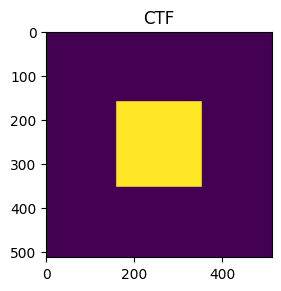

In [8]:
# スターチャート画像の読み込み
img = np.array(Image.open("./image/50nm_star_512pix.tif"))
plt.imshow(img, cmap="gray")
plt.colorbar()
plt.show()
imax, jmax = img.shape
object_img = (img) / np.max(img)
object_img = np.where(object_img==0 , np.exp(1.0j * 2.0 * np.pi / xlambda * refraction * thickness), 1.0)
obA = np.abs(object_img)
obP = np.angle(object_img)
plt.imshow(obA,cmap="gray")
plt.colorbar()
plt.show()
plt.imshow(obP,cmap="gray")
plt.colorbar()
plt.show()

# 開口サイズの計算
aperture = pixel_size * m * 2.0 * np.tan(NA)/xlambda     # [pixel]
print("aperture [pix] : ", int(aperture))
seq = np.linspace(-1.0*n/aperture, 1.0*n/aperture, int(n))
print(seq)


# 開口マスク作成
CTF = np.zeros((n,m))
CTF[n//2-int(aperture//2) : n//2+int(aperture//2),
    m//2-int(aperture//2) : m//2+int(aperture//2)] = 1.0
plt.subplot(1,2,1)
plt.title("CTF")
plt.imshow(CTF)
plt.show()



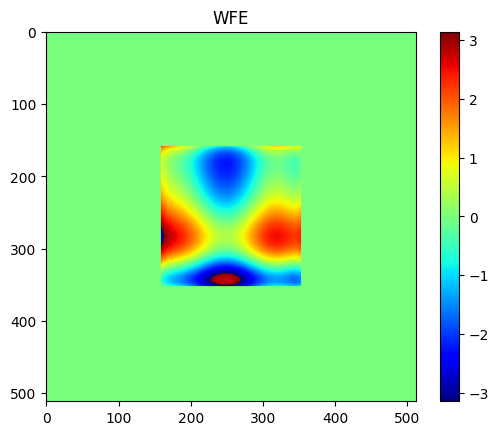

In [9]:
# Legendre波面作成用メッシュグリッド
[x, y] = np.meshgrid(np.linspace(-1.0*n/aperture, 1.0*n/aperture, int(n)), np.linspace(-1.0*m/aperture, 1.0*m/aperture, int(m)))

# Legendre多項式の基底関数
B = legendreBasis2D(maxD, x, y)
# B = Legendre_basis(x,y)

# 瞳関数の作成
pupil = np.array(polyEval2D(coef, B)) * CTF
pupil = (np.cos(pupil) + 1.0j*np.sin(pupil)) * CTF
plt.title("WFE")
plt.imshow(np.angle(pupil),cmap="jet")
plt.colorbar()
plt.show()

# 平面波展開用メッシュグリッド（解析時）
dfx = 1.0 / (pixel_size * m)
dfy = 1.0 / (pixel_size * n)
fx = np.arange(-m/2, m/2) * dfx
fy = np.arange(-n/2, n/2) * dfy
fx = tf.constant(fx, dtype=tf.float32)
fy = tf.constant(fy, dtype=tf.float32)
fx_mesh, fy_mesh = tf.meshgrid(fx, fy)
fz2 = 1.0 / xlambda ** 2 - fx_mesh ** 2 - fy_mesh ** 2
fz2 = tf.where(fz2 > 0.0, fz2, 0.0)
fz = tf.sqrt(fz2)

B = Legendre_basis_6(x, y)

In [10]:
colors = ['blue'] * 28
colors[3], colors[5] = 'red','red'
colors[6], colors[9] = 'blue', 'blue'
colors[10], colors[14] = 'green', 'green'
colors[15], colors[20] = 'yellow', 'yellow'
colors[21], colors[27] = 'purple', 'purple'

# 06606-


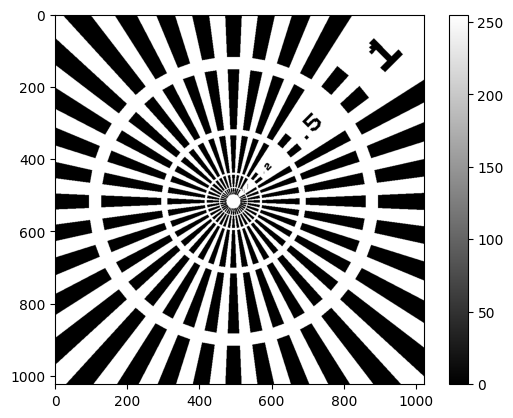

512


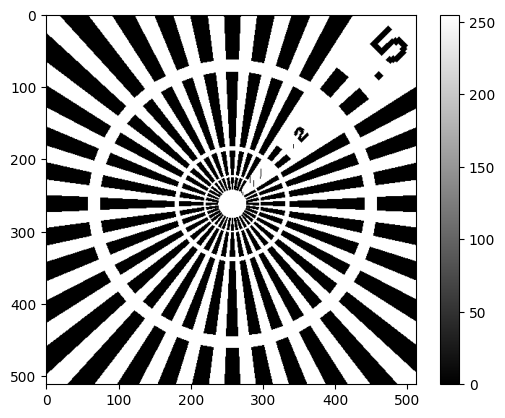

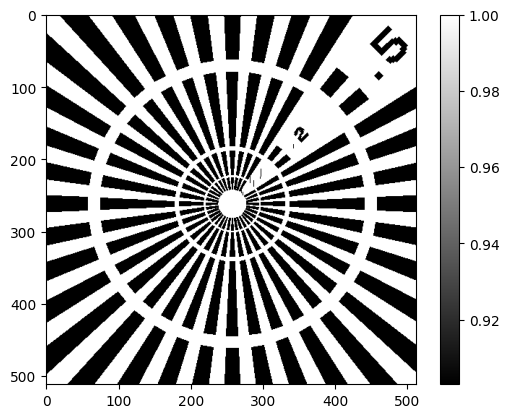

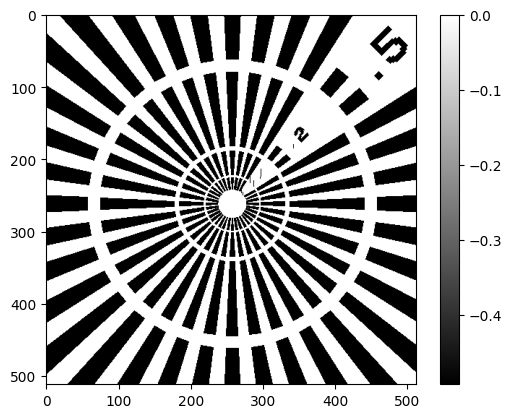

aperture [pix] :  195
[-2.61364973 -2.60342018 -2.59319064 -2.58296109 -2.57273154 -2.56250199
 -2.55227244 -2.54204289 -2.53181334 -2.52158379 -2.51135424 -2.5011247
 -2.49089515 -2.4806656  -2.47043605 -2.4602065  -2.44997695 -2.4397474
 -2.42951785 -2.4192883  -2.40905876 -2.39882921 -2.38859966 -2.37837011
 -2.36814056 -2.35791101 -2.34768146 -2.33745191 -2.32722236 -2.31699282
 -2.30676327 -2.29653372 -2.28630417 -2.27607462 -2.26584507 -2.25561552
 -2.24538597 -2.23515643 -2.22492688 -2.21469733 -2.20446778 -2.19423823
 -2.18400868 -2.17377913 -2.16354958 -2.15332003 -2.14309049 -2.13286094
 -2.12263139 -2.11240184 -2.10217229 -2.09194274 -2.08171319 -2.07148364
 -2.06125409 -2.05102455 -2.040795   -2.03056545 -2.0203359  -2.01010635
 -1.9998768  -1.98964725 -1.9794177  -1.96918815 -1.95895861 -1.94872906
 -1.93849951 -1.92826996 -1.91804041 -1.90781086 -1.89758131 -1.88735176
 -1.87712222 -1.86689267 -1.85666312 -1.84643357 -1.83620402 -1.82597447
 -1.81574492 -1.80551537 -1.795

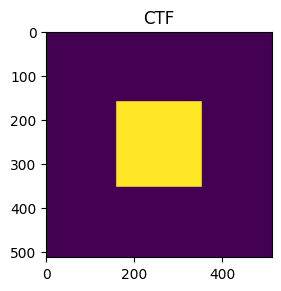

In [ ]:
# スターチャート画像の読み込み
img = np.array(Image.open("./image/50nm_star_1024pix.tif"))
plt.imshow(img, cmap="gray")
plt.colorbar()
plt.show()
imax, jmax = img.shape
img = img[imax//2-256 : imax//2+256,
          jmax//2-256-20 : jmax//2+256-20]
imax, jmax = img.shape
print(imax)
plt.imshow(img, cmap="gray")
plt.colorbar()
plt.show()

object_img = (img) / np.max(img)
object_img = np.where(object_img==0 , np.exp(1.0j * 2.0 * np.pi / xlambda * refraction * thickness), 1.0)
obA = np.abs(object_img)
obP = np.angle(object_img)
plt.imshow(obA,cmap="gray")
plt.colorbar()
plt.show()
plt.imshow(obP,cmap="gray")
plt.colorbar()
plt.show()

# 開口サイズの計算
aperture = pixel_size * m * 2.0 * np.tan(NA)/xlambda     # [pixel]
print("aperture [pix] : ", int(aperture))
seq = np.linspace(-1.0*n/aperture, 1.0*n/aperture, int(n))
print(seq)


# 開口マスク作成
CTF = np.zeros((n,m))
CTF[n//2-int(aperture//2) : n//2+int(aperture//2),
    m//2-int(aperture//2) : m//2+int(aperture//2)] = 1.0
plt.subplot(1,2,1)
plt.title("CTF")
plt.imshow(CTF)
plt.show()



In [11]:

rot_angle = 2
crop_size = 356
# coef = [0.0] * 28
# coef[3], coef[5] = -1.0,-1.0
# coef[10], coef[14] = 0.5, 0.5
# coef[21], coef[27] = 0.5,0.5
theta_x = 0.0
theta_y = 0.0
def ssim_imgList(img_total,img_list):
  score_list=[]
  img_total_culc = tf.expand_dims(img_total, axis=-1)

  for img in img_list:
    img_culc = tf.expand_dims(img, axis=-1)
    score = tf.image.ssim(img_total_culc, img_culc, max_val=1, filter_size=11, filter_sigma=1.5, k1=0.01, k2=0.03)
    score_list.append(score.numpy())
  score_arr = np.array(score_list)
  score_sigma = np.std(score_arr)
  # print(score_sigma)
  # print(np.average(score_arr))
  # plt.plot(angle_list, score_list)
  # plt.show()
  # print(np.std(score_arr))
  return np.average(score_arr), np.std(score_arr)

def score(coef, theta_x, theta_y, defocus = -40e-6, rot_angle = 8,crop_size=356):

  pupil = make_wavefront_oblique(coef, theta_x, theta_y)
  # print(coef)


  img_total = np.zeros((crop_size, crop_size))
  angle = 2*np.pi/(360/rot_angle)
  angle_num = int(360/rot_angle)
  img_list = []
  angle_list=[]
  for i in range(angle_num):
    # if i*rot_angle >=180:
    #   break
    angle_list.append(i*rot_angle)
    rot_A = np.array(tfa.rotate(obA, tf.constant(-1.0 * i * angle)))
    rot_P = np.array(tfa.rotate(obP, tf.constant(-1.0 * i * angle)))
    # コヒーレント結像
    object_img = rot_A * np.exp(rot_P * 1j)
    object_imgFT = np.fft.fftshift(np.fft.fft2(object_img))
    imSeqLowFT = object_imgFT * pupil
    exp_field = np.fft.ifft2(np.fft.ifftshift(imSeqLowFT))


    # 面ブレを考慮したデフォーカスを与える．
    dz = defocus
    exp_field = ASM_tf(exp_field, pixel_size, dz, xlambda)


    exp_intensity = np.abs(exp_field)**2
    exp_intensity = np.abs(exp_field)**2
    scale = np.max(exp_intensity)
    exp_intensity = photon * exp_intensity/scale
    exp_intensity = np.abs(addGaussianNoise(exp_intensity))
    exp_intensity = exp_intensity/photon*scale
    #ノイズ除去
    exp_intensity = np.expand_dims(exp_intensity, axis=-1)
    sigma_est = np.mean(estimate_sigma(exp_intensity, channel_axis=-1))
    patch_kw = dict(
        patch_size=5,  # 5x5 patches
        patch_distance=6,  # 13x13 search area
        channel_axis=-1,
    )
    # fast algorithm, sigma provided
    exp_intensity = denoise_nl_means(
        exp_intensity, h=0.6 * sigma_est, sigma=sigma_est, fast_mode=True, **patch_kw
    )
    exp_intensity = np.array(tfa.rotate(exp_intensity, tf.constant(i * angle)))

    #各画像の描写
    # plt.imshow(exp_intensity, cmap="gray",vmax=2.0, vmin=0.0)
    # plt.colorbar()
    # plt.axis('off')
    # plt.show()


    img_out = exp_intensity[imax//2-int(crop_size//2) : imax//2+int(crop_size//2),
                            jmax//2-int(crop_size//2) : jmax//2+int(crop_size//2)]
    img_out /= np.max(img_out)
    # plt.imshow(img_out, cmap="gray",vmax=1.0, vmin=0.0)
    # plt.colorbar()
    # plt.axis('off')
    # plt.show()
    img_list.append(img_out)
    img_total += img_out
  img_total /= len(img_list)

  # print(rms_calculate(pupil))
  # plt.imshow(img_total, cmap="gray",vmin=0, vmax=2.0)
  # plt.colorbar()
  # plt.axis('off')
  # plt.show()

  # plt.imshow(psf(pupil)[imax//2-int(crop_size//4) : imax//2+int(crop_size//4),
  #                       jmax//2-int(crop_size//4) : jmax//2+int(crop_size//4)], cmap = "jet")
  # plt.axis('off')
  # plt.show()
  score_avg, score_std = ssim_imgList(img_total, img_list)
  return score_avg, score_std,img_total


def defocus_score(coef):
    pupil = make_wavefront(coef)





In [ ]:
coef_w = 0.7
target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(10)]   # Legendre多項式の係数
coef = [0.0] * 28
coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target

[0.0, 0.0, 0.0, -0.17408136933249996, 0.0, 0.31423200811052854, -0.08999505430092619, 0.0, 0.0, -0.04548228575561264, -0.06310307040166502, 0.0, 0.0, 0.0, 0.24654464792255182, -0.004787359590694595, 0.0, 0.0, 0.0, 0.0, 0.09443202285877927, 0.22128701568752118, 0.0, 0.0, 0.0, 0.0, 0.0, 0.33656665161883015]
0.44465437586424567


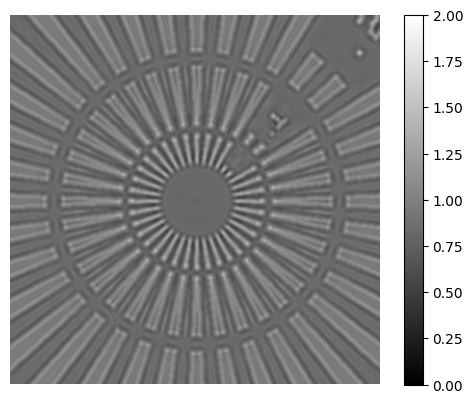

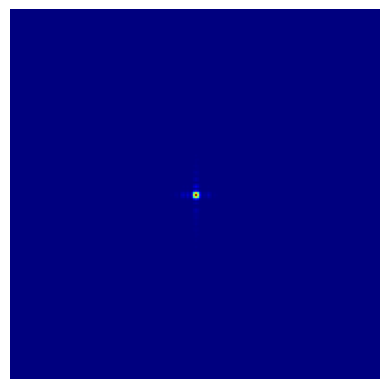

In [ ]:
rot_angle = 2
crop_size = 356
# coef = [0.0] * 28
# coef[3], coef[5] = 0.0,0.0
# coef[10], coef[14] = 1.0, 1.0
# coef[21], coef[27] = 0.5,0.5
theta_x = 3.00e-4
theta_y = 0.00e-4
pupil = make_wavefront_oblique(coef, theta_x, theta_y)
print(coef)


img_total = np.zeros((crop_size, crop_size))
angle = 2*np.pi/(360/rot_angle)
angle_num = int(360/rot_angle)
img_list = []
angle_list=[]
for i in range(angle_num):
  # if i*rot_angle >=180:
  #   break
  angle_list.append(i*rot_angle)
  rot_A = np.array(tfa.rotate(obA, tf.constant(-1.0 * i * angle)))
  rot_P = np.array(tfa.rotate(obP, tf.constant(-1.0 * i * angle)))
  # コヒーレント結像
  object_img = rot_A * np.exp(rot_P * 1j)
  object_imgFT = np.fft.fftshift(np.fft.fft2(object_img))
  imSeqLowFT = object_imgFT * pupil
  exp_field = np.fft.ifft2(np.fft.ifftshift(imSeqLowFT))


  # 面ブレを考慮したデフォーカスを与える．
  dz = 50.0 *1e-6
  # dz = 0.0
  exp_field = ASM_tf(exp_field, pixel_size, dz, xlambda)


  exp_intensity = np.abs(exp_field)**2
  exp_intensity = np.abs(exp_field)**2
  scale = np.max(exp_intensity)
  exp_intensity = photon * exp_intensity/scale
  exp_intensity = np.abs(addGaussianNoise(exp_intensity))
  exp_intensity = exp_intensity/photon*scale
  #ノイズ除去
  exp_intensity = np.expand_dims(exp_intensity, axis=-1)
  sigma_est = np.mean(estimate_sigma(exp_intensity, channel_axis=-1))
  patch_kw = dict(
      patch_size=5,  # 5x5 patches
      patch_distance=6,  # 13x13 search area
      channel_axis=-1,
  )
  # fast algorithm, sigma provided
  exp_intensity = denoise_nl_means(
      exp_intensity, h=0.6 * sigma_est, sigma=sigma_est, fast_mode=True, **patch_kw
  )
  exp_intensity = np.array(tfa.rotate(exp_intensity, tf.constant(i * angle)))
  img_out = exp_intensity[imax//2-int(crop_size//2) : imax//2+int(crop_size//2),
                          jmax//2-int(crop_size//2) : jmax//2+int(crop_size//2)]
  img_list.append(img_out)
  img_total += img_out
img_total /= len(img_list)

print(rms_calculate(pupil))
plt.imshow(img_total, cmap="gray",vmin=0, vmax=2.0)
plt.colorbar()
plt.axis('off')
plt.show()

plt.imshow(psf(pupil)[imax//2-int(crop_size//4) : imax//2+int(crop_size//4),
                      jmax//2-int(crop_size//4) : jmax//2+int(crop_size//4)], cmap = "jet")
plt.axis('off')
plt.show()


0.5006912368374501


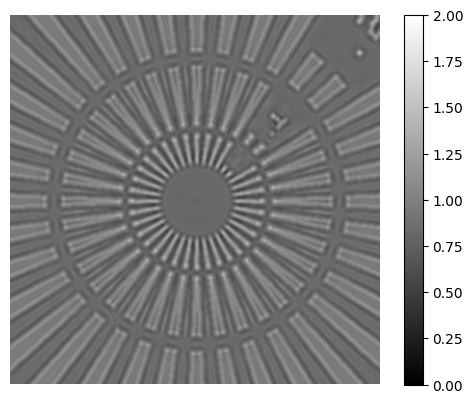

0.671902149175627


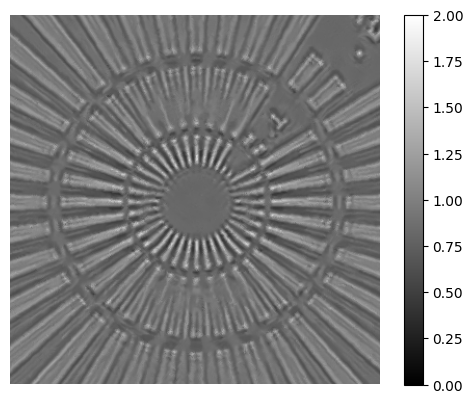

In [ ]:

print((np.max(img_total)-np.min(img_total))/(np.max(img_total)+np.min(img_total)))

# img_total2 = img_total2[:crop_size//2, crop_size//2-1:]
plt.imshow(img_total, cmap="gray",vmax=2.0, vmin=0.0)
plt.colorbar()
plt.axis('off')
plt.show()


print((np.max(img_list[0])-np.min(img_list[0]))/(np.max(img_list[0])+np.min(img_list[0])))

# img_total2 = img_total2[:crop_size//2, crop_size//2-1:]
plt.imshow(img_list[0], cmap="gray",vmax=2.0, vmin=0.0)
plt.colorbar()
plt.axis('off')
plt.show()

0.0254724
0.77877766


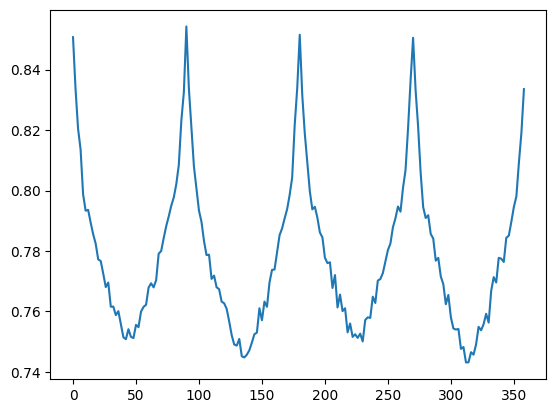

0.0254724


In [ ]:
score_list=[]
img_total_culc = tf.expand_dims(img_total, axis=-1)

for img in img_list:
  img_culc = tf.expand_dims(img, axis=-1)
  score = tf.image.ssim(img_total_culc, img_culc, max_val=1, filter_size=11, filter_sigma=1.5, k1=0.01, k2=0.03)
  score_list.append(score.numpy())
score_arr = np.array(score_list)
score_sigma = np.std(score_arr)
print(score_sigma)
print(np.average(score_arr))
plt.plot(angle_list, score_list)
plt.show()
print(np.std(score_arr))

0.021931347
0.7619493


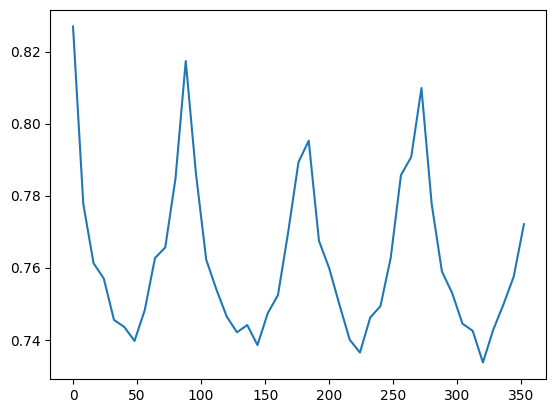

0.021931347


In [ ]:
score_list=[]
img_total_culc = tf.expand_dims(img_total, axis=-1)

for img in img_list:
  img_culc = tf.expand_dims(img, axis=-1)
  score = tf.image.ssim(img_total_culc, img_culc, max_val=1, filter_size=11, filter_sigma=1.5, k1=0.01, k2=0.03)
  score_list.append(score.numpy())
score_arr = np.array(score_list)
score_sigma = np.std(score_arr)
print(score_sigma)
print(np.average(score_arr))
plt.plot(angle_list, score_list)
plt.show()
print(np.std(score_arr))

In [ ]:
rms_list=[]
ave_list = []
std_list = []
c_list = []
d_list = []

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24


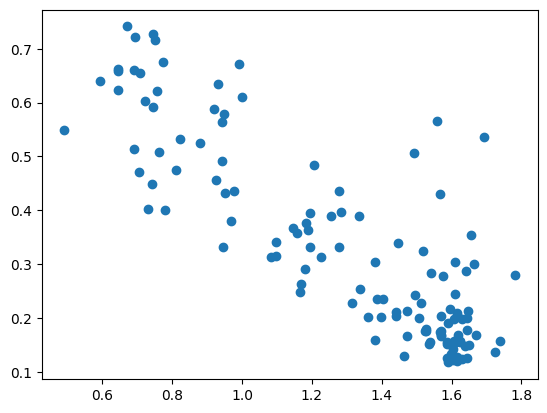

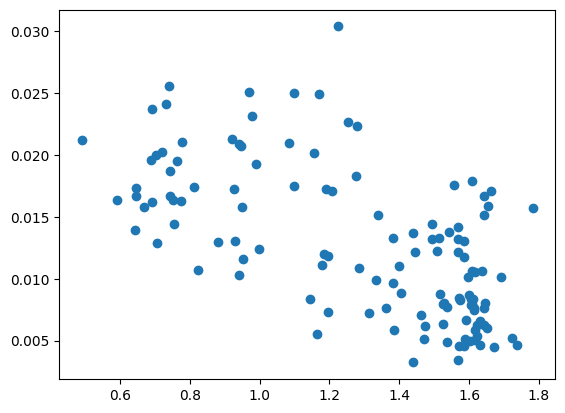

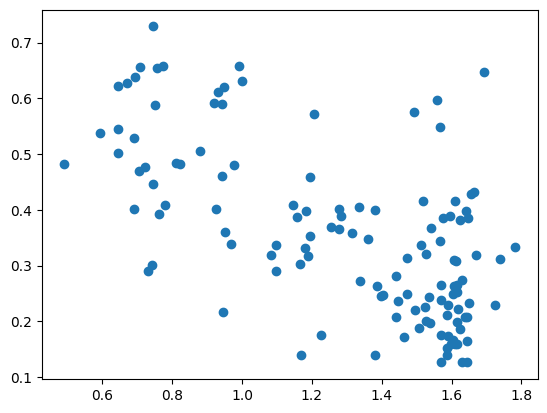

In [ ]:
coef_w = 1.0
theta_x = 3.00e-4
theta_y = 0.00e-4
for i in range(25):
  print(i)
  target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(10)]
  coef = [0.0] * 28
  coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target
  pupil = make_wavefront_oblique(coef, theta_x, theta_y)
  rms = rms_calculate(pupil)
  rms_list.append(rms)
  score_avg, score_std, img_total = score(coef, theta_x, theta_y, defocus=50e-6, rot_angle = 8,crop_size=356)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  ave_list.append(score_avg)
  std_list.append(score_std)
  c_list.append(cont)

plt.scatter(rms_list, ave_list)
plt.show()
plt.scatter(rms_list, std_list)
plt.show()
plt.scatter(rms_list, c_list)
plt.show()


In [ ]:
rms_list2=[]
ave_list2 = []
std_list2 = []
d_list2 = []

0
1
2
3
4
5
6
7
8
9


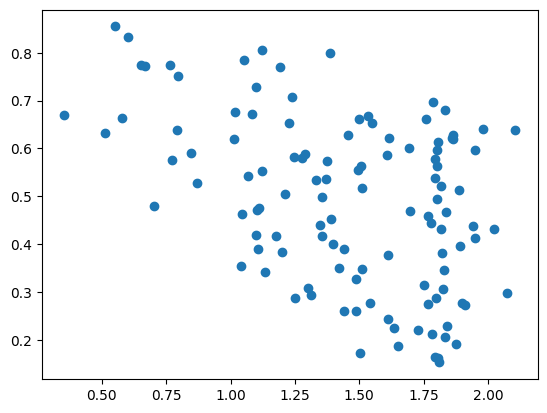

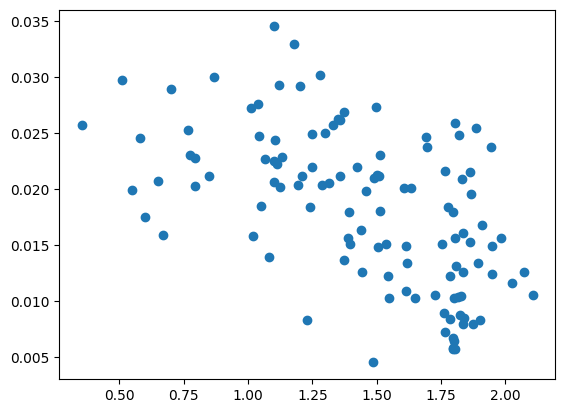

In [ ]:
coef_w = 1.0
for i in range(10):
  print(i)
  target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(6)]
  coef = [0.0] * 28
  coef[3], coef[5], coef[10], coef[14], coef[21], coef[27] = target
  pupil = make_wavefront_oblique(coef, theta_x, theta_y)
  rms = rms_calculate(pupil)
  rms_list2.append(rms)
  score_avg, score_std = score(coef, theta_x, theta_y, defocus=-40e-6, rot_angle = 8,crop_size=356)
  ave_list2.append(score_avg)
  std_list2.append(score_std)

plt.scatter(rms_list2, ave_list2)
plt.show()
plt.scatter(rms_list2, std_list2)
plt.show()


In [ ]:
pupil = make_wavefront_oblique(coef, theta_x, theta_y)
rms = rms_calculate(pupil)
print(rms)

0.5096108692740011


In [ ]:
coef = [0.0]*28

In [ ]:
rms_list=[]
ave_list = []
std_list = []
d_list = []
c_list = []
theta_x = 5.0e-4
theta_y = 0.0e-4
# coef = [0.0] * 28

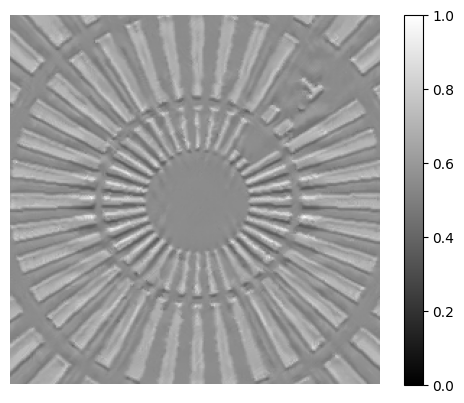

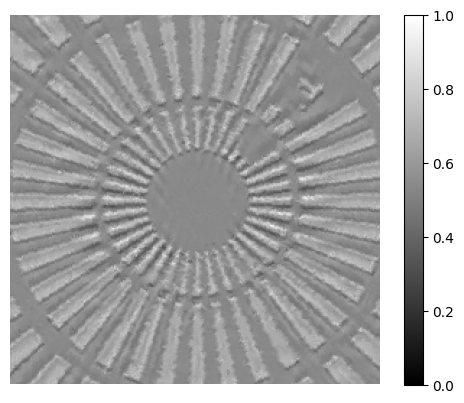

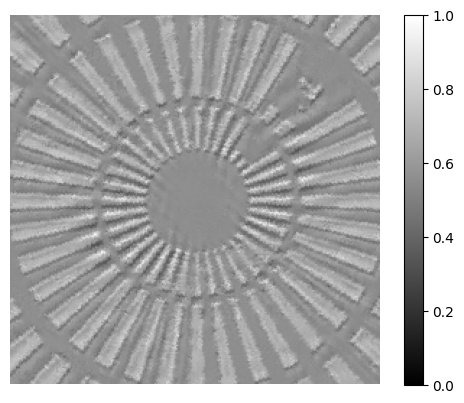

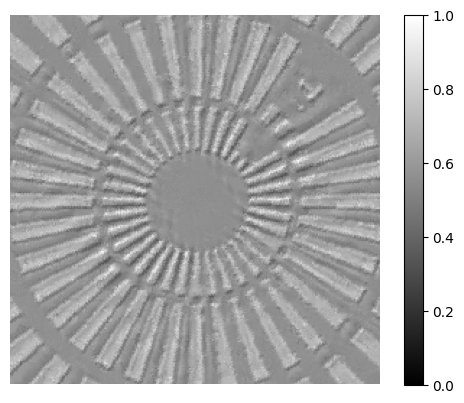

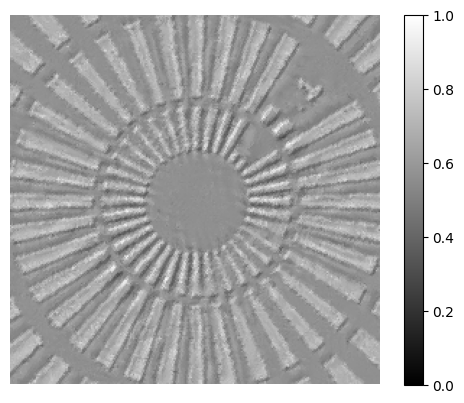

...

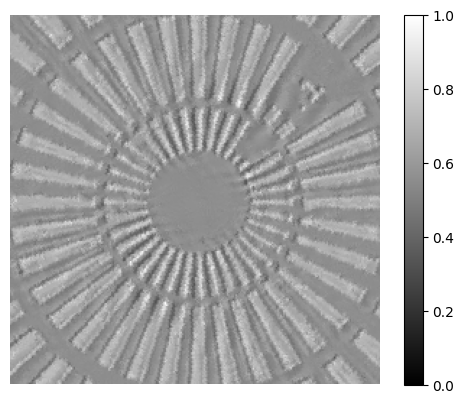

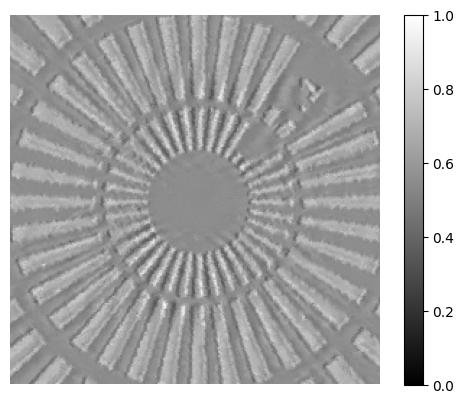

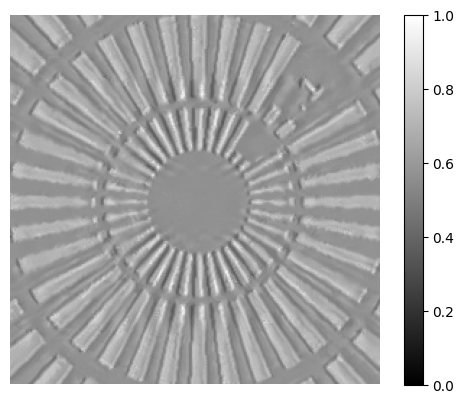

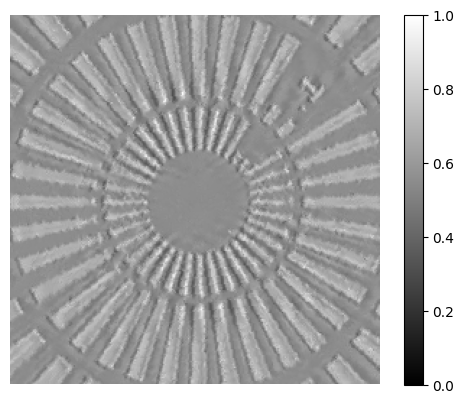

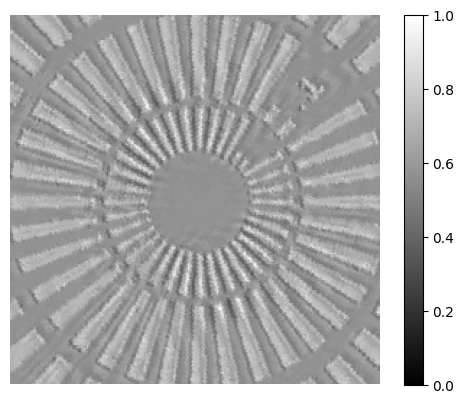

In [ ]:
score_avg, score_std,img_total = score(coef, theta_x, theta_y, defocus = 0e-6, rot_angle = 10,crop_size=256)
img_total /= np.max(img_total)
cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
print(f'平均{score_avg}')
print(f'標準偏差{score_std}')
print(f'コントラスト{cont}')
plt.imshow(img_total, cmap="gray",vmax=1.0, vmin=0.0)
plt.colorbar()
plt.axis('off')
plt.show()
c_list.append(cont)
ave_list.append(score_avg)
std_list.append(score_std)

In [ ]:
# 平均0.7624629735946655
# 標準偏差0.01748107373714447
# コントラスト0.5855194619212374

-0.0001
平均0.2714734375476837
標準偏差0.008421199396252632
コントラスト0.3503778412492242


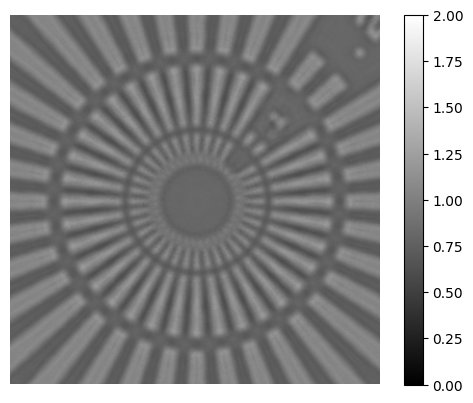

-9e-05
平均0.2513907253742218
標準偏差0.009305530227720737
コントラスト0.3306531682692046


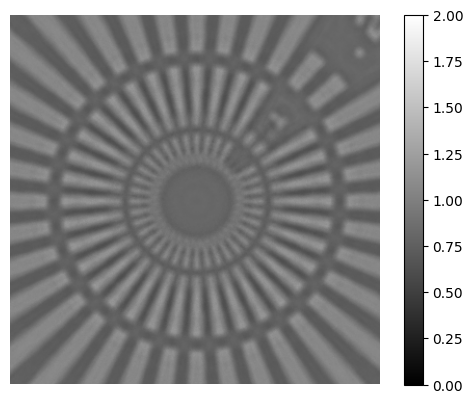

-8e-05
平均0.2553768455982208
標準偏差0.008545227348804474
コントラスト0.3369348228912649


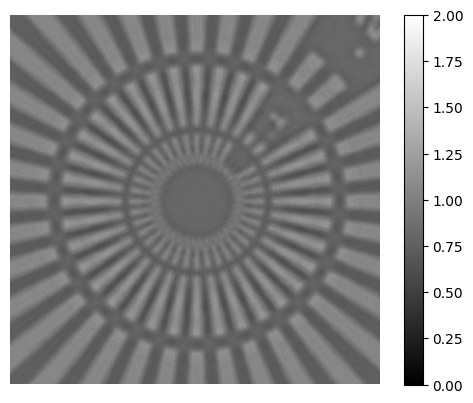

-7.000000000000001e-05
平均0.23892070353031158
標準偏差0.008879503235220909
コントラスト0.3376578520772147


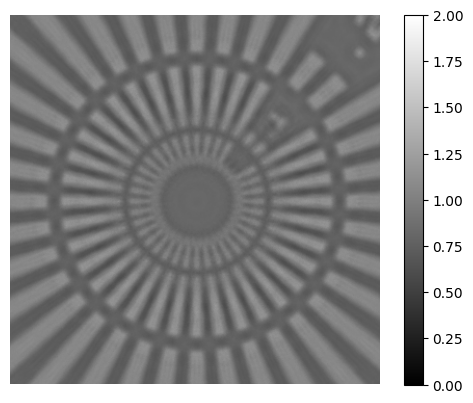

-6.000000000000001e-05
平均0.22752058506011963
標準偏差0.010335088707506657
コントラスト0.33707100416687535


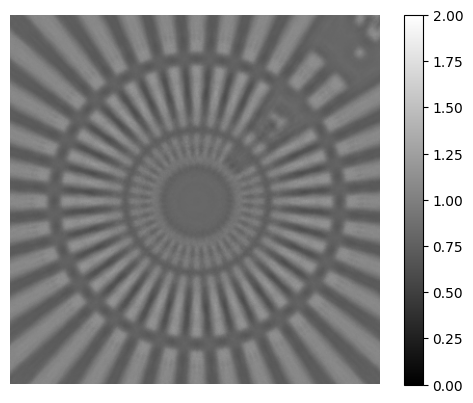

-5.000000000000001e-05
平均0.2232082337141037
標準偏差0.010435311123728752
コントラスト0.33367215921987253


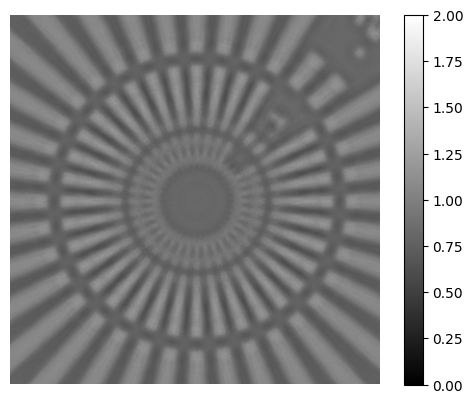

-4.000000000000001e-05
平均0.22177067399024963
標準偏差0.012482044287025928
コントラスト0.3320926573714548


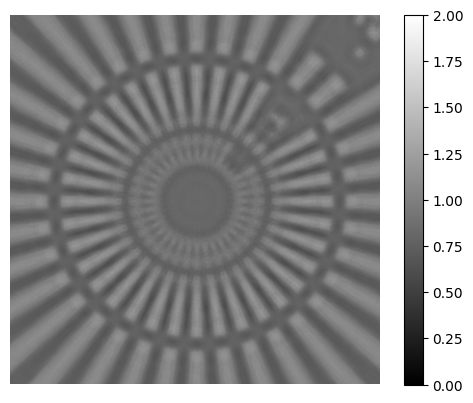

-3.000000000000001e-05
平均0.2148747593164444
標準偏差0.013767587020993233
コントラスト0.32521561806195354


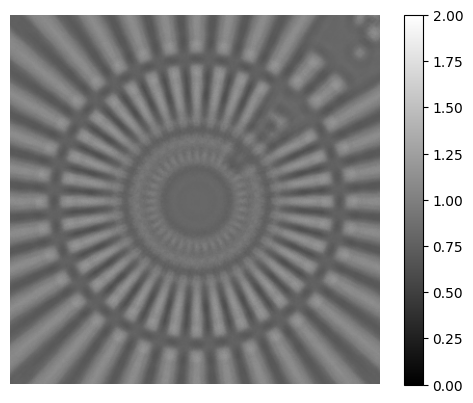

-2.0000000000000012e-05
平均0.21409015357494354
標準偏差0.01397679839283228
コントラスト0.328976573897656


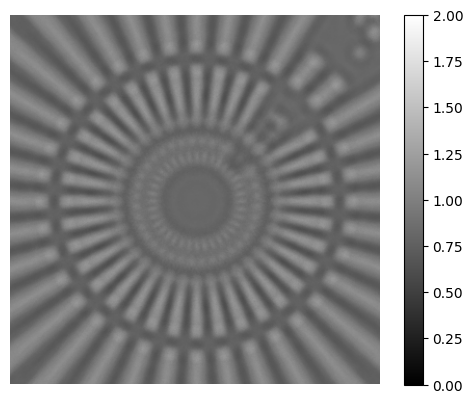

-1.0000000000000011e-05
平均0.21846908330917358
標準偏差0.014057050459086895
コントラスト0.3332905746938565


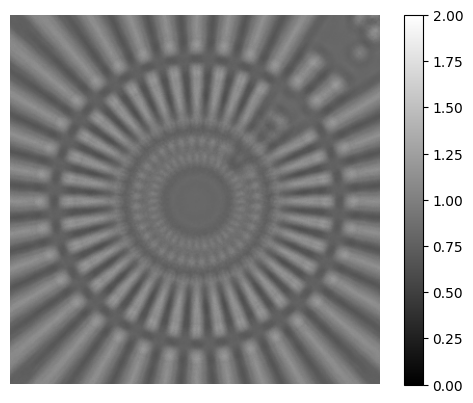

-1.0164395367051604e-20
平均0.22430521249771118
標準偏差0.013911399990320206
コントラスト0.33479576845795356


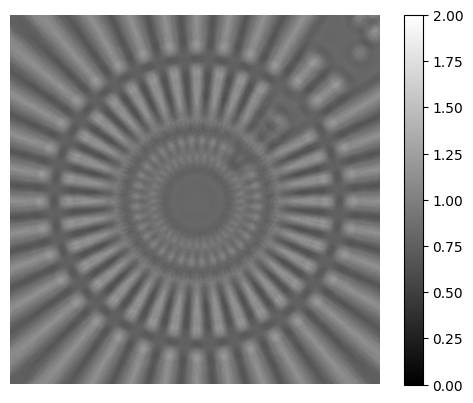

9.99999999999999e-06
平均0.22918596863746643
標準偏差0.013611759059131145
コントラスト0.3288124919084341


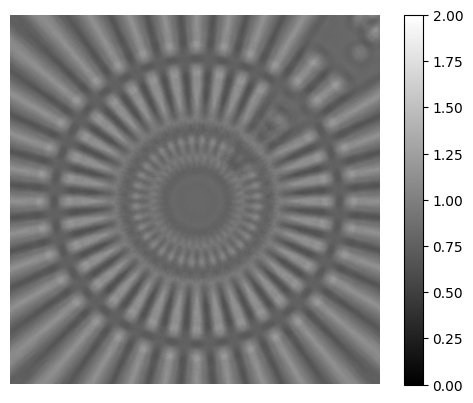

1.999999999999999e-05
平均0.23671381175518036
標準偏差0.013295439071953297
コントラスト0.3421772713143533


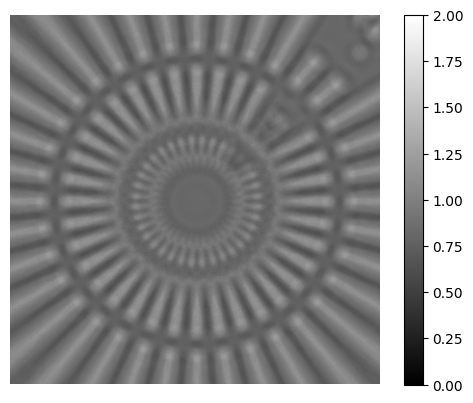

2.999999999999999e-05
平均0.2468317449092865
標準偏差0.01299148891121149
コントラスト0.34581034363793867


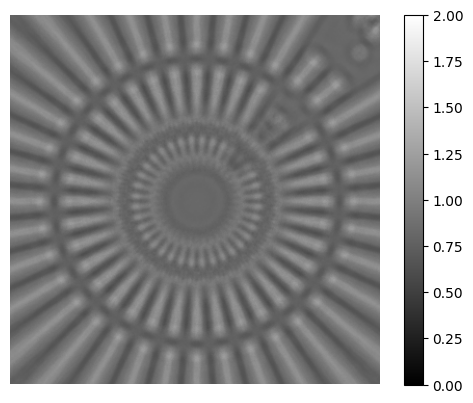

3.999999999999999e-05
平均0.25603431463241577
標準偏差0.012215846218168736
コントラスト0.35352606291306193


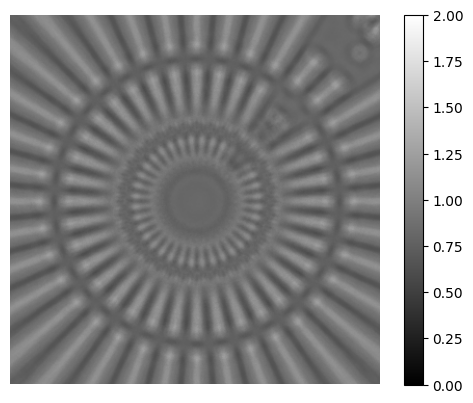

4.999999999999999e-05
平均0.26238876581192017
標準偏差0.01024391409009695
コントラスト0.35848217133412746


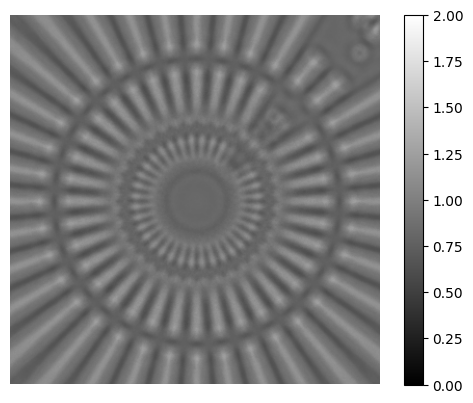

5.999999999999999e-05


KeyboardInterrupt: 

In [ ]:
defocus = -100e-6
for i in range(20):
  print(defocus)
  d_list.append(defocus)
  score_avg, score_std,img_total = score(coef, theta_x, theta_y, defocus = defocus, rot_angle = 8,crop_size=356)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  print(f'平均{score_avg}')
  print(f'標準偏差{score_std}')
  print(f'コントラスト{cont}')
  plt.imshow(img_total, cmap="gray",vmax=2.0, vmin=0.0)
  plt.colorbar()
  plt.axis('off')
  plt.show()
  c_list.append(cont)
  ave_list.append(score_avg)
  std_list.append(score_std)
  defocus += 10e-6
plt.plot(d_list, ave_list)
plt.show()
plt.plot(d_list, std_list)
plt.show()
plt.plot(d_list, c_list)
plt.show()

-0.0001
平均0.6810353398323059
標準偏差0.02196374349296093
コントラスト0.5695080518451401


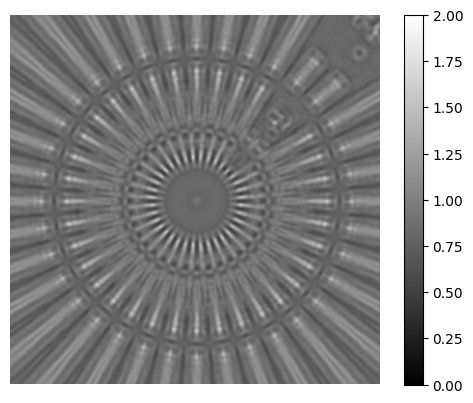

-9.5e-05
平均0.6881134510040283
標準偏差0.02208751253783703
コントラスト0.5845817260380087


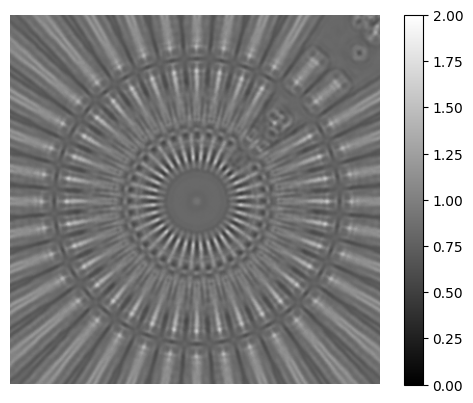

-9e-05
平均0.6804332137107849
標準偏差0.02270161174237728
コントラスト0.5339244369654238


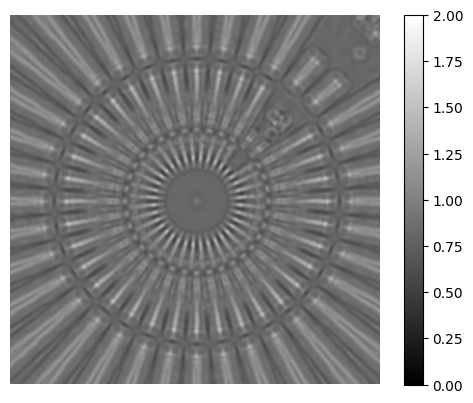

-8.5e-05
平均0.681628942489624
標準偏差0.022588949650526047
コントラスト0.5251329852408726


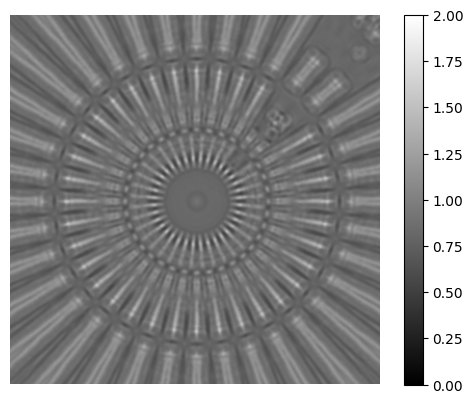

-8e-05
平均0.6736100316047668
標準偏差0.022268299013376236
コントラスト0.531621297210202


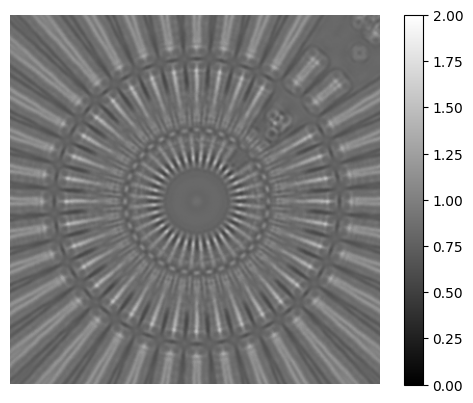

-7.500000000000001e-05
平均0.6830785870552063
標準偏差0.022923074662685394
コントラスト0.4547144258396698


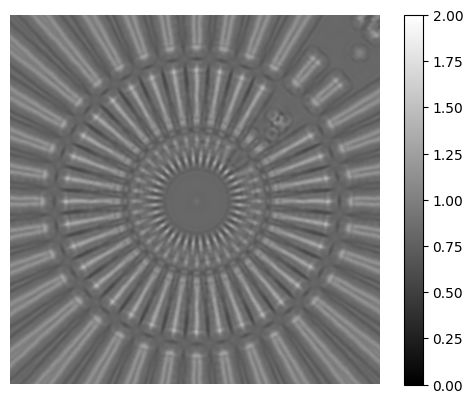

-7.000000000000001e-05
平均0.673466145992279
標準偏差0.02247653901576996
コントラスト0.4436905157620694


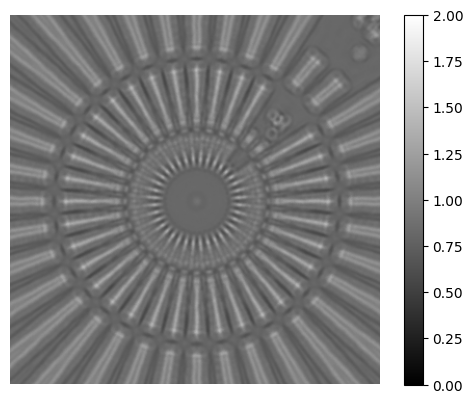

-6.500000000000001e-05
平均0.6677823066711426
標準偏差0.024698158726096153
コントラスト0.4062358388286622


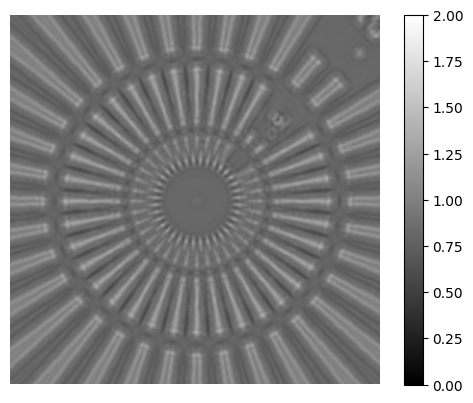

-6.000000000000001e-05
平均0.6749903559684753
標準偏差0.02445933409035206
コントラスト0.4021842894064466


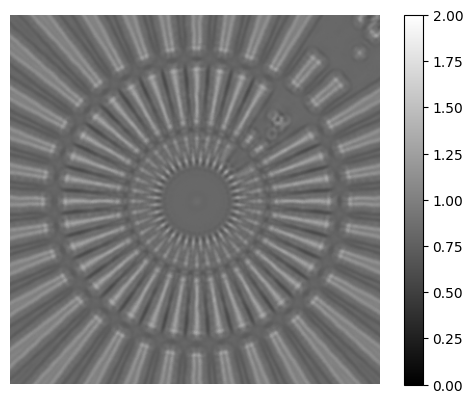

-5.500000000000001e-05
平均0.6829935312271118
標準偏差0.025317957624793053
コントラスト0.3943067719061474


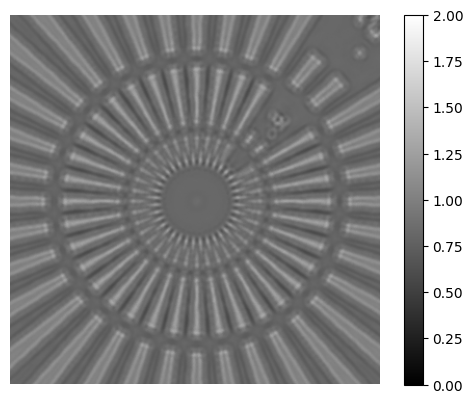

-5.000000000000001e-05
平均0.6903923749923706
標準偏差0.02599819004535675
コントラスト0.3767039672811441


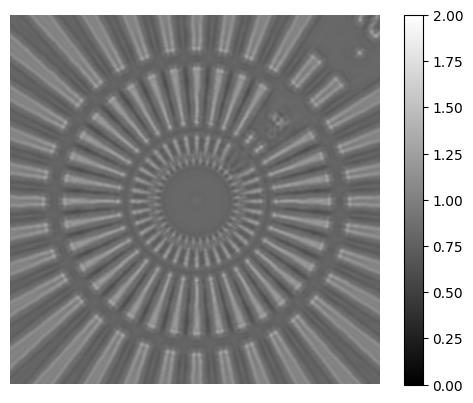

-4.500000000000001e-05
平均0.7118485569953918
標準偏差0.024298449978232384
コントラスト0.44905689731134674


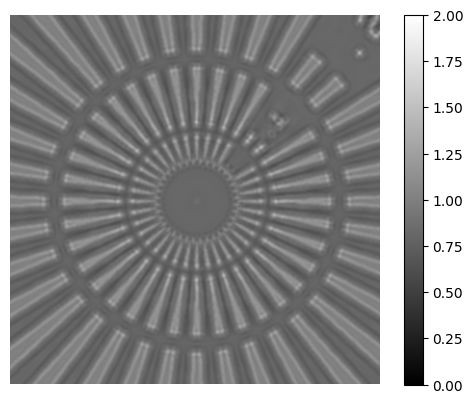

-4.000000000000001e-05
平均0.7045724987983704
標準偏差0.025716092437505722
コントラスト0.4160470649957316


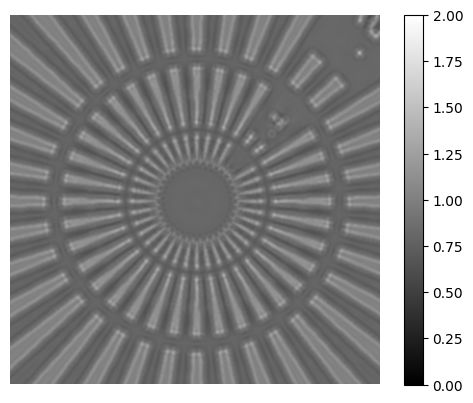

-3.500000000000001e-05
平均0.7191691994667053
標準偏差0.024160651490092278
コントラスト0.4576583154113765


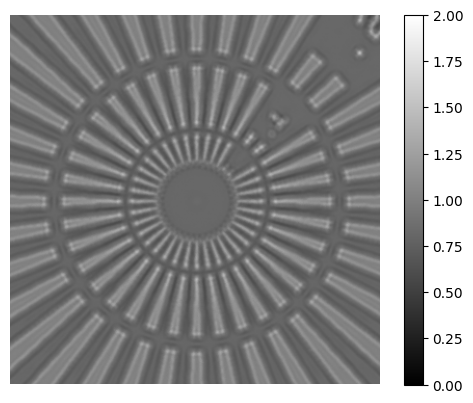

-3.000000000000001e-05
平均0.7195299863815308
標準偏差0.022535819560289383
コントラスト0.4513070938735951


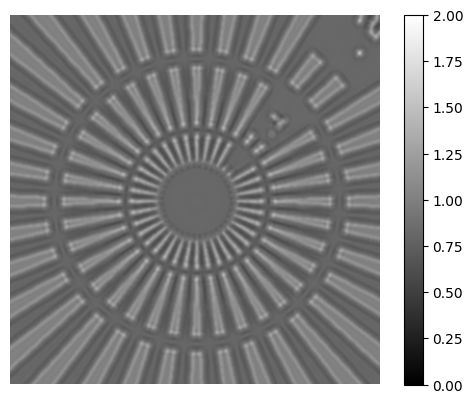

-2.500000000000001e-05
平均0.7119309902191162
標準偏差0.02284044586122036
コントラスト0.47501535304272335


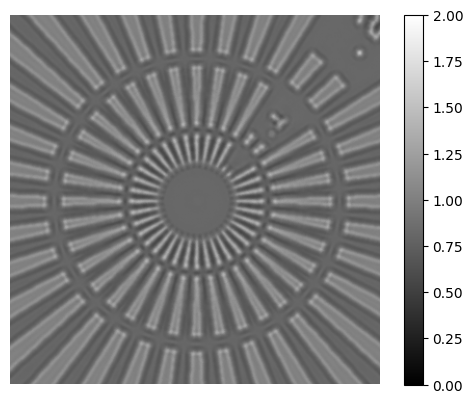

-2.0000000000000012e-05
平均0.7097306847572327
標準偏差0.021865658462047577
コントラスト0.49110377832674157


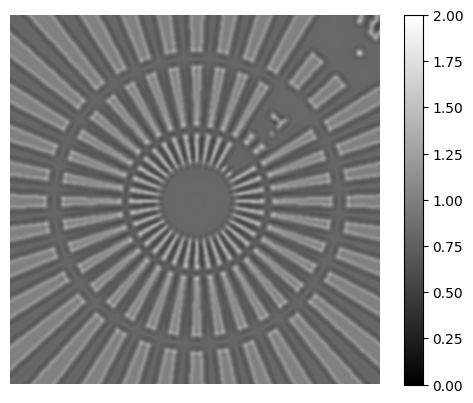

-1.5000000000000012e-05
平均0.7258899211883545
標準偏差0.020935365930199623
コントラスト0.5146018028705637


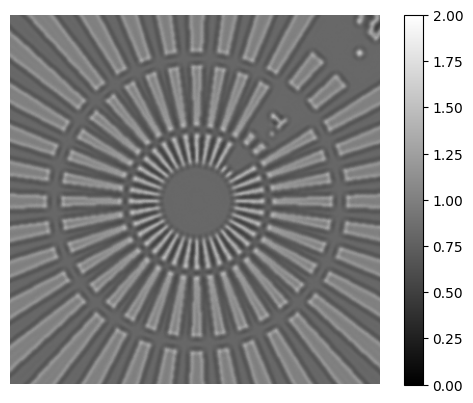

-1.0000000000000013e-05
平均0.7387391924858093
標準偏差0.02073054574429989
コントラスト0.5254696599558574


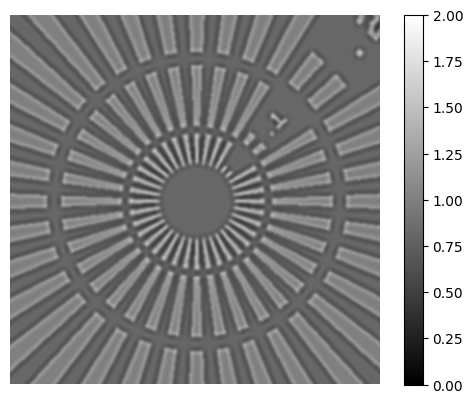

-5.000000000000012e-06
平均0.7604398727416992
標準偏差0.020022602751851082
コントラスト0.5475295273867241


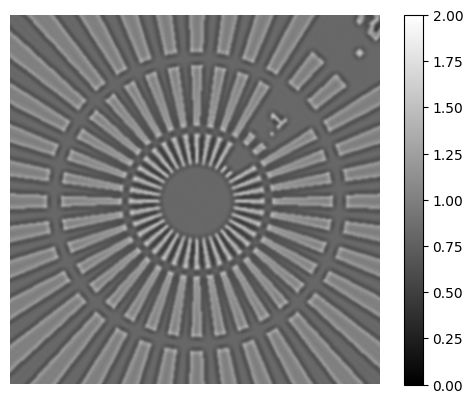

-1.1858461261560205e-20
平均0.7806404829025269
標準偏差0.020334681496024132
コントラスト0.564762745694868


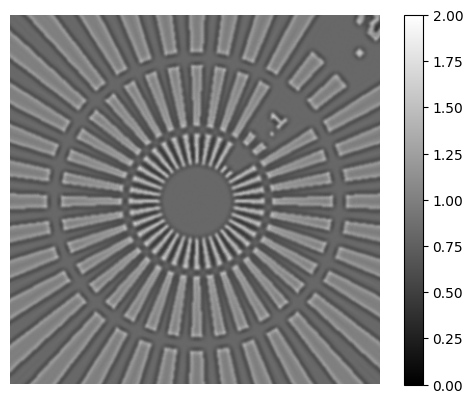

4.9999999999999886e-06
平均0.7970057129859924
標準偏差0.020509639754891396
コントラスト0.5848825974100326


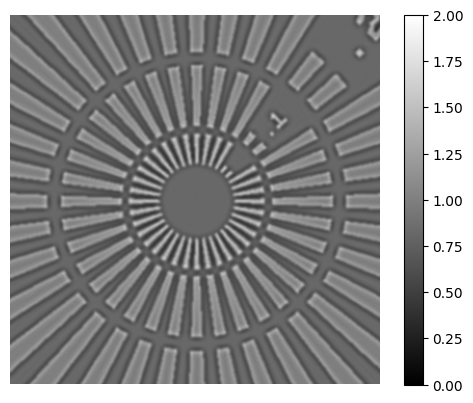

9.999999999999989e-06
平均0.8079541325569153
標準偏差0.020379554480314255
コントラスト0.60432559034211


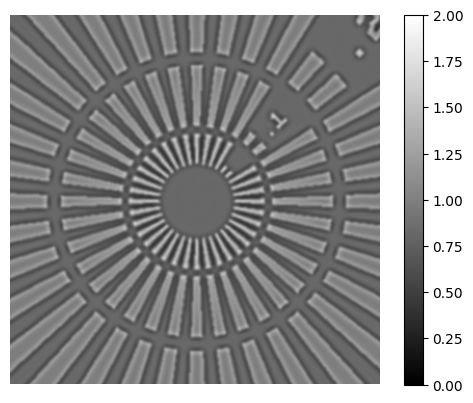

1.4999999999999989e-05
平均0.8118888139724731
標準偏差0.019500868394970894
コントラスト0.6113604404546767


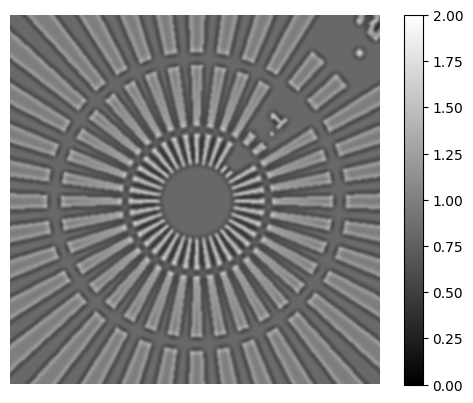

1.9999999999999988e-05
平均0.8120488524436951
標準偏差0.019162047654390335
コントラスト0.6327054411001346


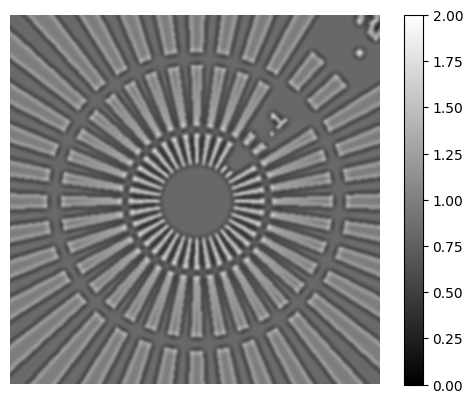

2.4999999999999988e-05
平均0.8094789981842041
標準偏差0.01904463768005371
コントラスト0.6463176296018166


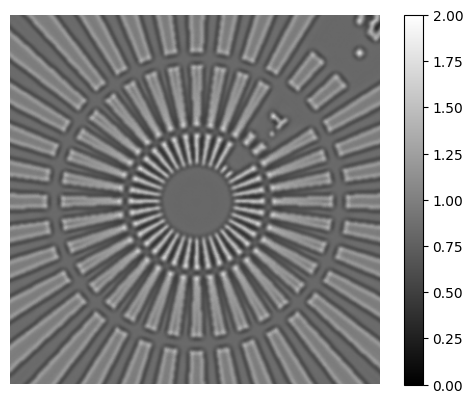

2.9999999999999987e-05
平均0.8058454990386963
標準偏差0.018888656049966812
コントラスト0.6513044297088729


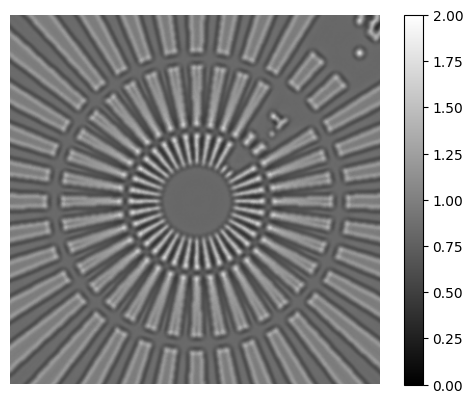

3.499999999999999e-05
平均0.8012582659721375
標準偏差0.01848525181412697
コントラスト0.6572681134913934


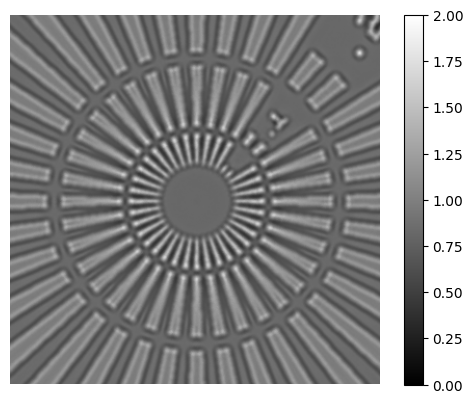

3.999999999999999e-05
平均0.7962160110473633
標準偏差0.018127799034118652
コントラスト0.661300827825226


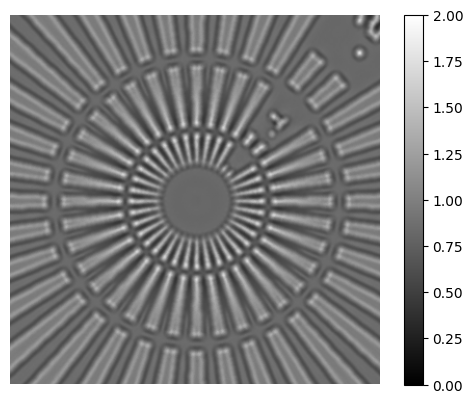

4.499999999999999e-05
平均0.7939110398292542
標準偏差0.017682408913969994
コントラスト0.6579137610020077


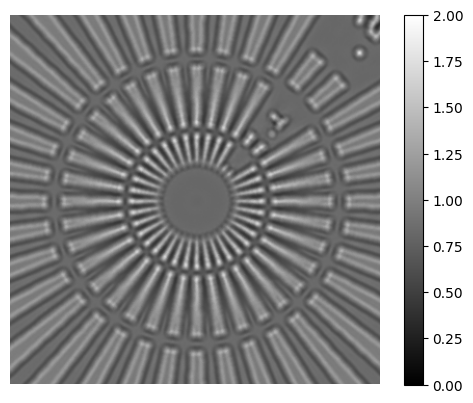

4.999999999999999e-05
平均0.789848268032074
標準偏差0.017417432740330696
コントラスト0.6879343060918965


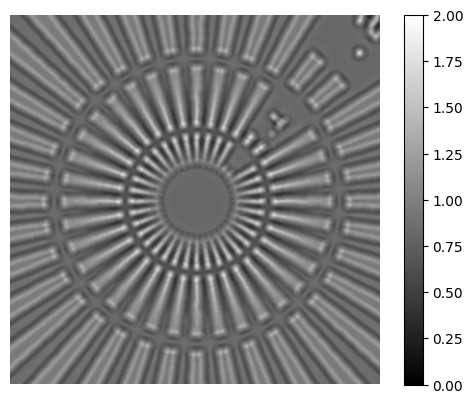

5.499999999999999e-05
平均0.7751492261886597
標準偏差0.01735074818134308
コントラスト0.6964731704931744


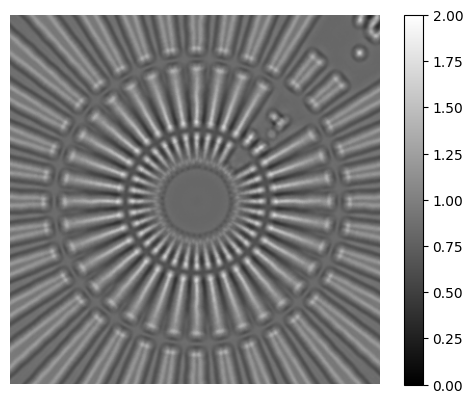

5.999999999999999e-05
平均0.778222918510437
標準偏差0.01701461337506771
コントラスト0.6991437046944966


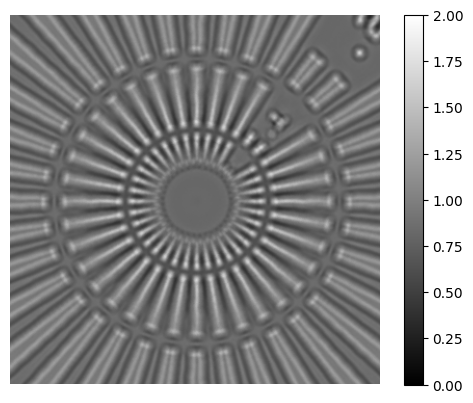

6.5e-05
平均0.7813040614128113
標準偏差0.016840748488903046
コントラスト0.6954480028087293


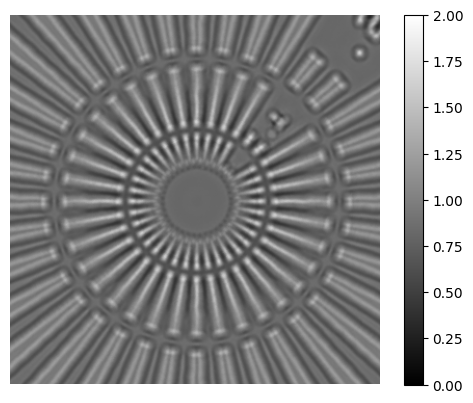

7e-05
平均0.7705533504486084
標準偏差0.01736954040825367
コントラスト0.7039217603463445


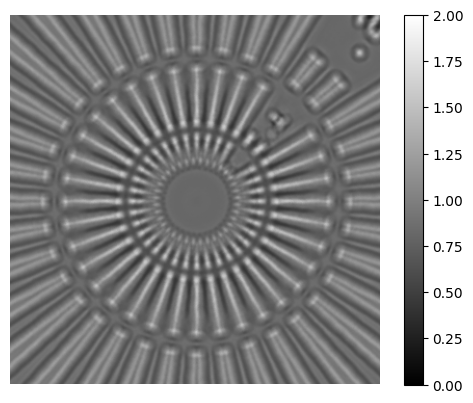

7.5e-05
平均0.7787294387817383
標準偏差0.01651000790297985
コントラスト0.7054889051227287


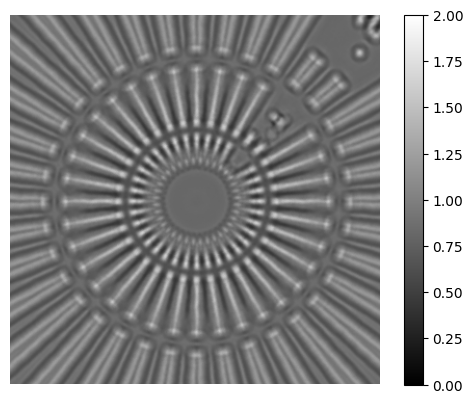

7.999999999999999e-05
平均0.7734865546226501
標準偏差0.017035167664289474
コントラスト0.7471197369179687


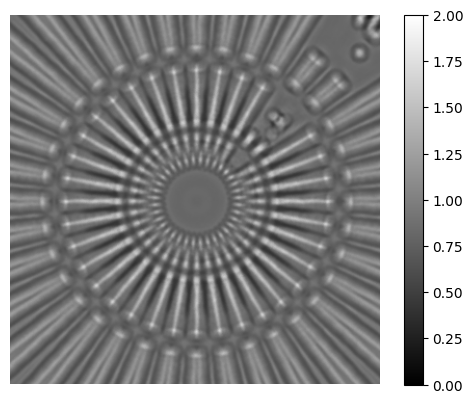

8.499999999999999e-05
平均0.7679370641708374
標準偏差0.017033828422427177
コントラスト0.7400471971362498


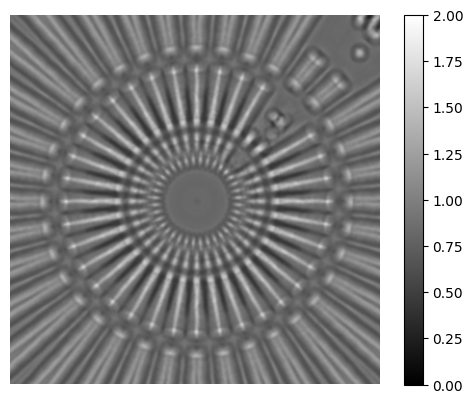

8.999999999999999e-05
平均0.7683613896369934
標準偏差0.016917701810598373
コントラスト0.7353975555828979


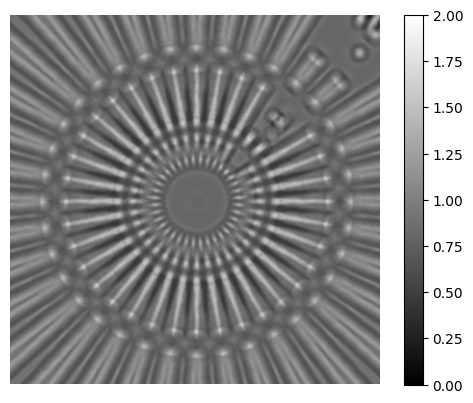

9.499999999999999e-05
平均0.7652913331985474
標準偏差0.017177298665046692
コントラスト0.7150560042875489


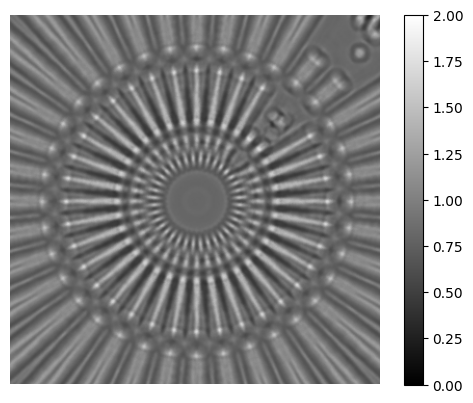

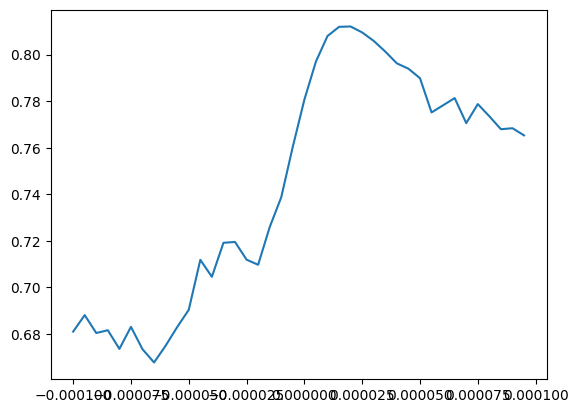

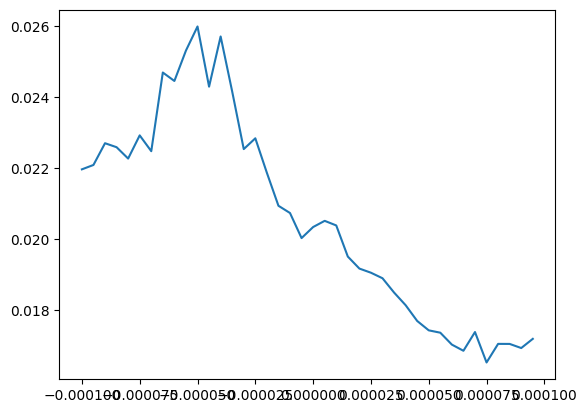

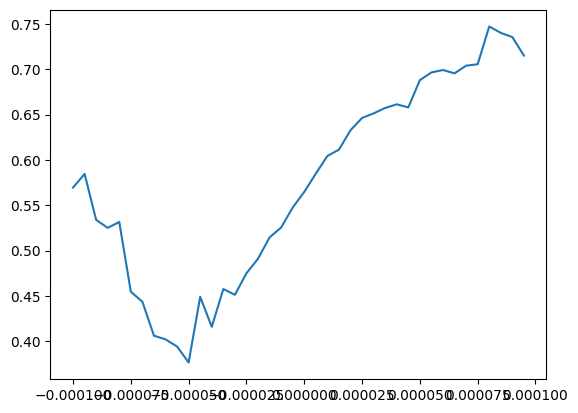

In [ ]:
defocus = -100e-6
for i in range(40):
  print(defocus)
  d_list.append(defocus)
  score_avg, score_std,img_total = score(coef, theta_x, theta_y, defocus = defocus, rot_angle = 8,crop_size=356)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  print(f'平均{score_avg}')
  print(f'標準偏差{score_std}')
  print(f'コントラスト{cont}')
  plt.imshow(img_total, cmap="gray",vmax=2.0, vmin=0.0)
  plt.colorbar()
  plt.axis('off')
  plt.show()
  c_list.append(cont)
  ave_list.append(score_avg)
  std_list.append(score_std)
  defocus += 5e-6
plt.plot(d_list, ave_list)
plt.show()
plt.plot(d_list, std_list)
plt.show()
plt.plot(d_list, c_list)
plt.show()

In [ ]:
coef

[0.0,
 0.0,
 0.0,
 -0.3005203736312992,
 0.0,
 -0.10735658468188947,
 -0.18794521605755385,
 0.0,
 0.0,
 0.33506672538983007,
 -0.23365197423513911,
 0.0,
 0.0,
 0.0,
 0.136272341933793,
 -0.3183125397069107,
 0.0,
 0.0,
 0.0,
 0.0,
 -0.15596104226920915,
 0.01832696310826243,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.12545634556775398]

In [ ]:
coef_w = 0.6
target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(10)]   # Legendre多項式の係数
# coef = [0.0] * 28
coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target
# coef[6], coef[9] = 1.0, 1.0

pupil0 = make_wavefront(coef)
print(rms_calculate(pupil0))

0.3378779394569324


In [ ]:
pupil = make_wavefront(coef)
rms = rms_calculate(pupil)
print(rms)
print(coef)

0.3378779394569324
[0.0, 0.0, 0.0, -0.03657730458015396, 0.0, 0.07476940765700424, -0.11003388789813243, 0.0, 0.0, 0.02285332608338908, 0.07604976932075946, 0.0, 0.0, 0.0, -0.08609675280341089, 0.09837740182385785, 0.0, 0.0, 0.0, 0.0, -0.22642899379463183, 0.1617941578318564, 0.0, 0.0, 0.0, 0.0, 0.0, 0.018381562704333165]


In [ ]:
rms_list=[]
ave_list = []
std_list = []
d_list = []
c_list = []
theta_x = 7.0e-4
theta_y = 0.0e-4

-0.0001
0.017678487422244323
平均0.019734255130693174
標準偏差0.017678487422244323
コントラスト0.4183880185778371


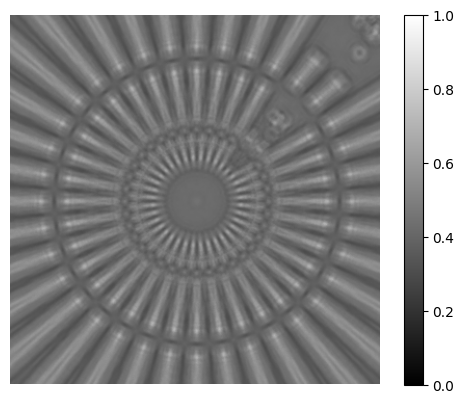

-9e-05
0.018351908911508393
平均0.020313512501026622
標準偏差0.018351908911508393
コントラスト0.4252357763736667


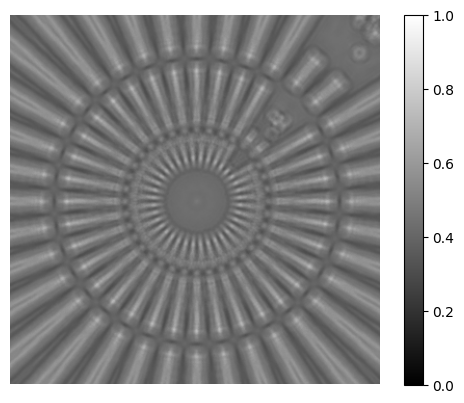

-8e-05
0.019120562874061296
平均0.021372400229649983
標準偏差0.019120562874061296
コントラスト0.43070784398304085


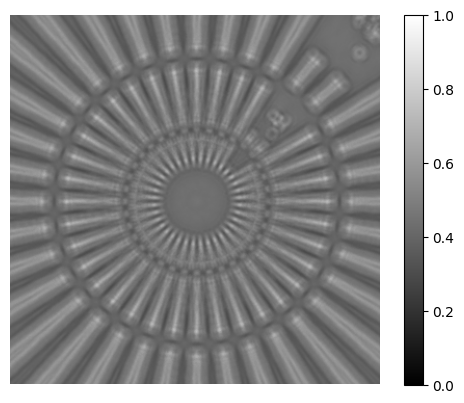

-7.000000000000001e-05
0.019338748352466607
平均0.022240356691131242
標準偏差0.019338748352466607
コントラスト0.4209068989813165


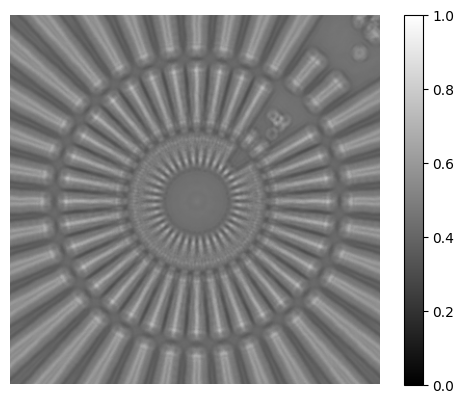

-6.000000000000001e-05
0.019674129359409646
平均0.022863539940414228
標準偏差0.019674129359409646
コントラスト0.4100943223076419


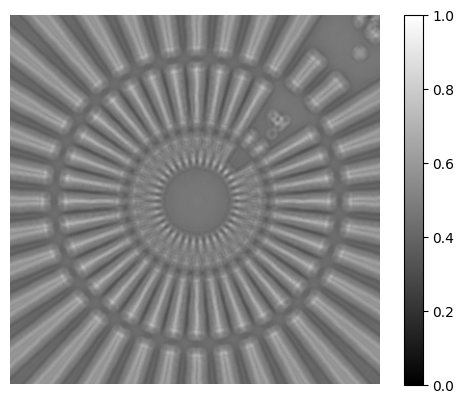

-5.000000000000001e-05
0.019612498543805507
平均0.022578905276048347
標準偏差0.019612498543805507
コントラスト0.3808732300958156


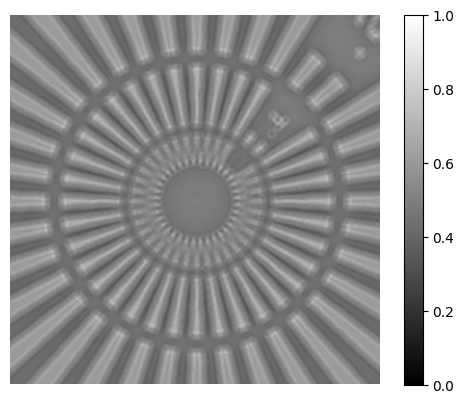

-4.000000000000001e-05
0.01926491580486581
平均0.02167097541026453
標準偏差0.01926491580486581
コントラスト0.3658256219204749


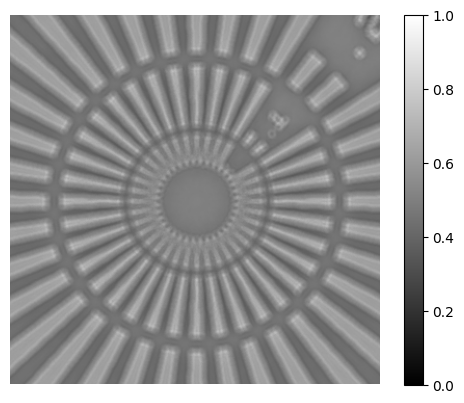

-3.000000000000001e-05
0.020145534487133028
平均0.021098150027471545
標準偏差0.020145534487133028
コントラスト0.37536756210395883


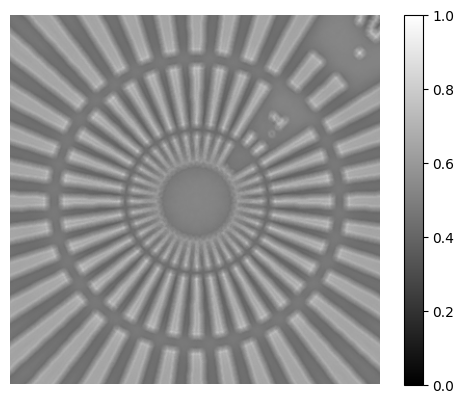

-2.0000000000000012e-05
0.02124674495975066
平均0.02116320228067382
標準偏差0.02124674495975066
コントラスト0.3406147996423504


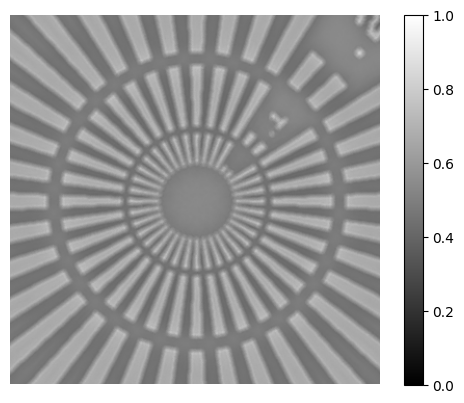

-1.0000000000000011e-05
0.02365478468969158
平均0.022424060034300617
標準偏差0.02365478468969158
コントラスト0.3250635605704628


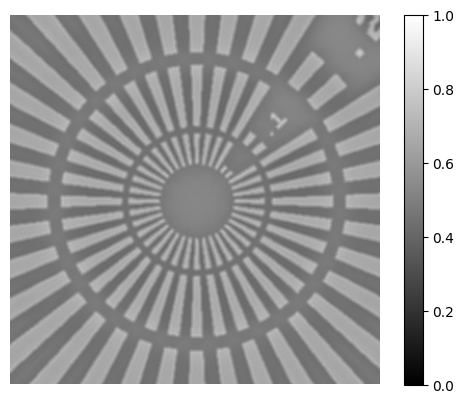

-1.0164395367051604e-20
0.032028634610631636
平均0.02800362430346983
標準偏差0.032028634610631636
コントラスト0.32068491356882056


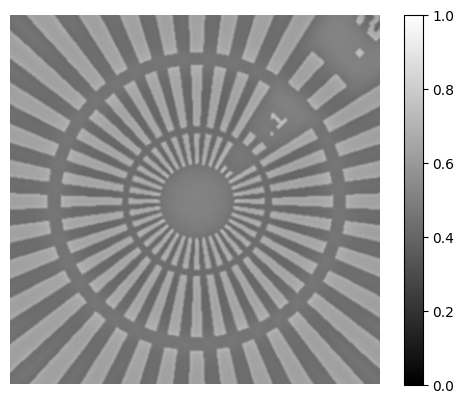

9.99999999999999e-06
0.028999885225116033
平均0.026780962580407398
標準偏差0.028999885225116033
コントラスト0.35551557363512115


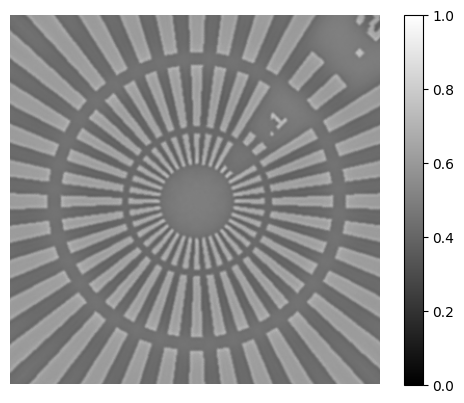

1.999999999999999e-05
0.025356918711542924
平均0.024610381838300707
標準偏差0.025356918711542924
コントラスト0.4134028357788298


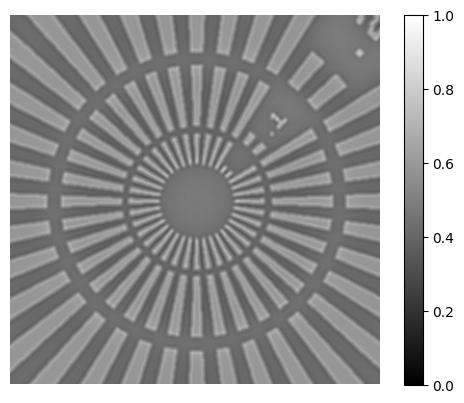

2.999999999999999e-05
0.022798671640886368
平均0.02366283823456145
標準偏差0.022798671640886368
コントラスト0.4520428040314705


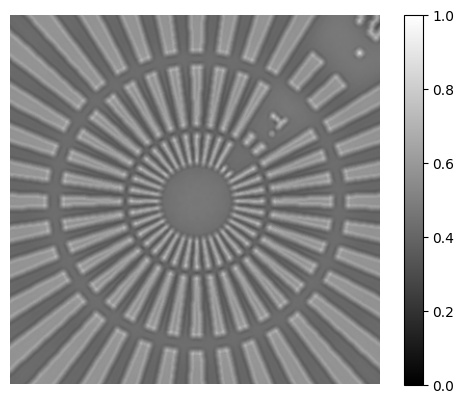

3.999999999999999e-05
0.021224554910624083
平均0.022891602813924133
標準偏差0.021224554910624083
コントラスト0.47588242514904316


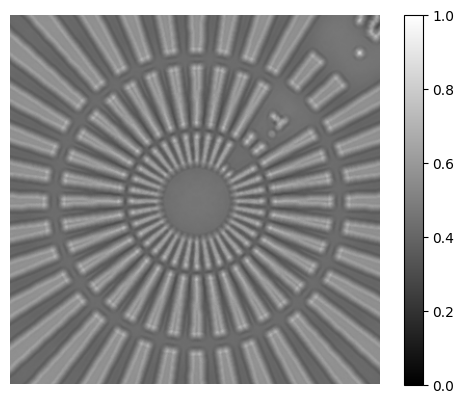

4.999999999999999e-05
0.020684987694302197
平均0.023218883951136332
標準偏差0.020684987694302197
コントラスト0.47320041365975296


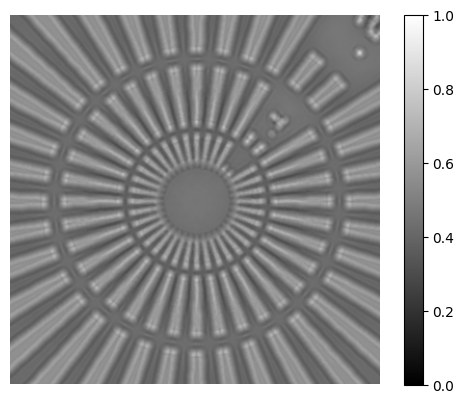

5.999999999999999e-05
0.019848921763761747
平均0.022856455046639898
標準偏差0.019848921763761747
コントラスト0.46914960058654664


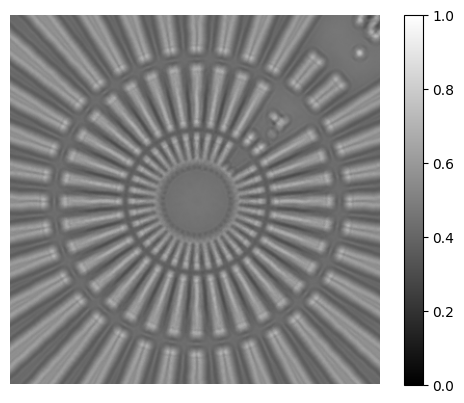

7e-05
0.019665293049505095
平均0.02274117417584259
標準偏差0.019665293049505095
コントラスト0.4435243873018371


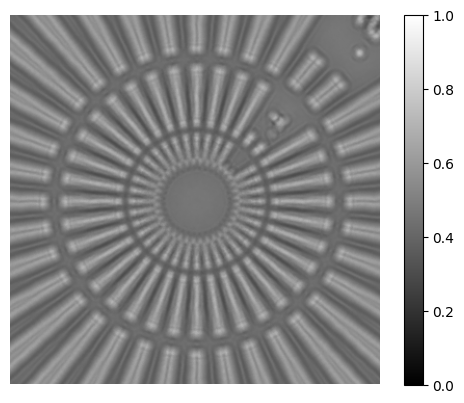

7.999999999999999e-05
0.019475747250692052
平均0.022455919176326673
標準偏差0.019475747250692052
コントラスト0.43856754367353656


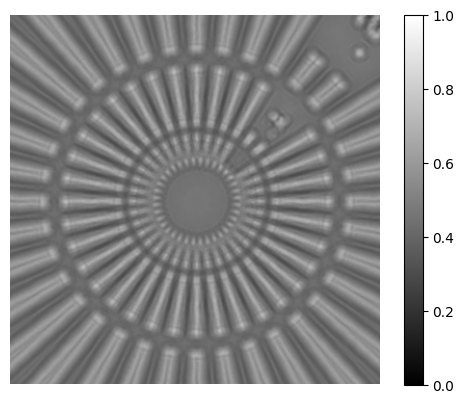

8.999999999999999e-05
0.019371335578854662
平均0.02240542182864091
標準偏差0.019371335578854662
コントラスト0.45104716170733433


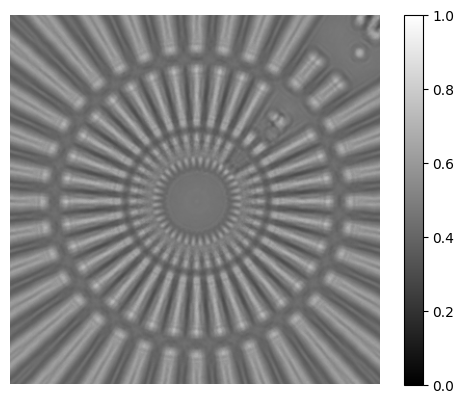

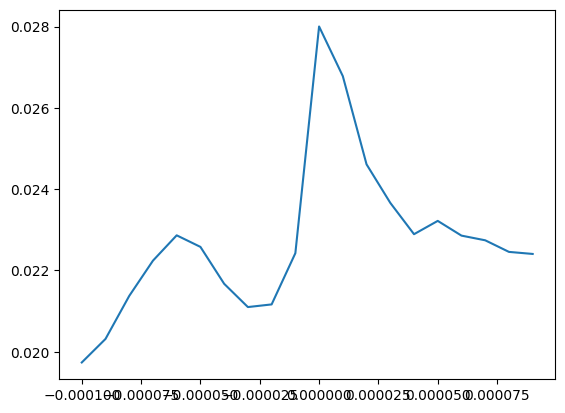

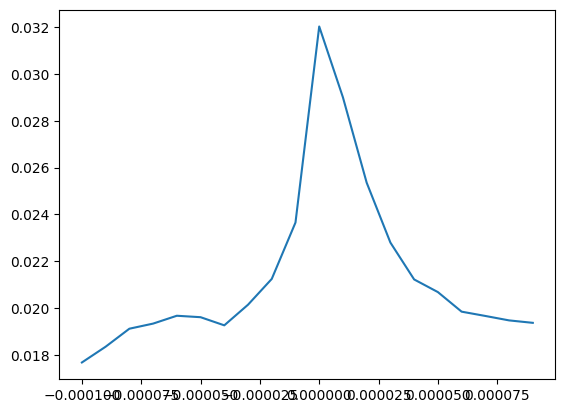

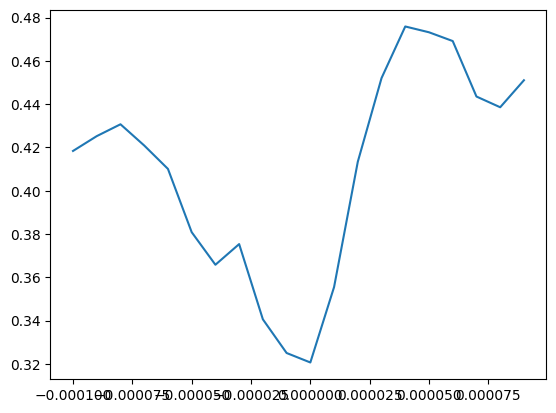

In [ ]:
defocus = -100e-6
for i in range(20):
  print(defocus)
  d_list.append(defocus)
  score_avg, score_std,img_total = score(coef, theta_x, theta_y, defocus = defocus, rot_angle = 8,crop_size=256)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
  img_dif = np.abs(img_dif)
  std = np.std(img_dif)
  avg = np.average(img_dif)
  print(std)
  print(f'平均{avg}')
  print(f'標準偏差{std}')
  print(f'コントラスト{cont}')
  plt.imshow(img_total, cmap="gray",vmax=1.0, vmin=0.0)
  plt.colorbar()
  plt.axis('off')
  plt.show()
  c_list.append(cont)
  ave_list.append(avg)
  std_list.append(std)
  defocus += 10e-6
plt.plot(d_list, ave_list)
plt.show()
plt.plot(d_list, std_list)
plt.show()
plt.plot(d_list, c_list)
plt.show()

-0.0001
0.02508120950601785
平均0.029479093118630575
標準偏差0.02508120950601785
コントラスト0.4162998546110078


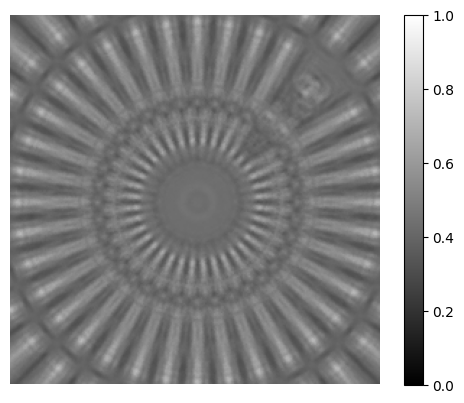

-9e-05
0.024783199706194078
平均0.028859042787731822
標準偏差0.024783199706194078
コントラスト0.4281402083677148


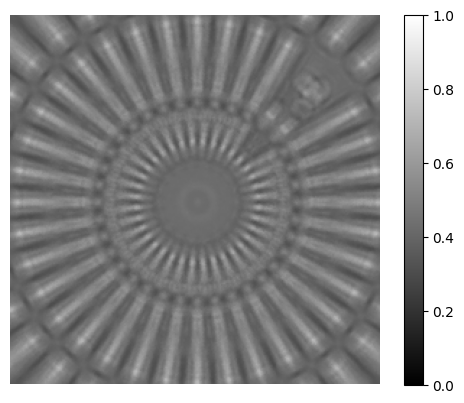

-8e-05
0.024421682288076733
平均0.028192322496172158
標準偏差0.024421682288076733
コントラスト0.42816002064109315


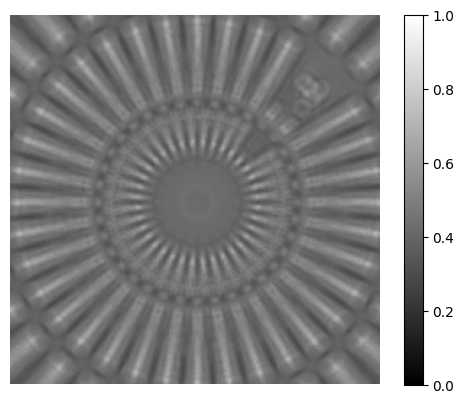

-7.000000000000001e-05
0.024433660021980913
平均0.02853484773258778
標準偏差0.024433660021980913
コントラスト0.42707955043512846


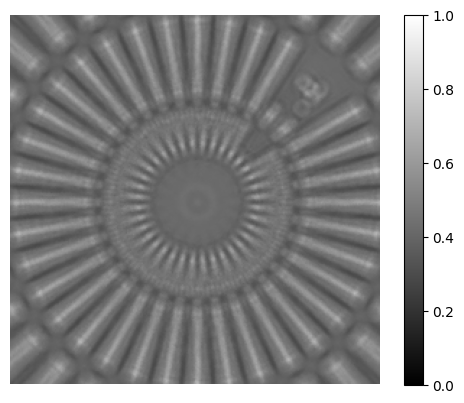

-6.000000000000001e-05
0.025242401260434404
平均0.02963407622482657
標準偏差0.025242401260434404
コントラスト0.43009153522003807


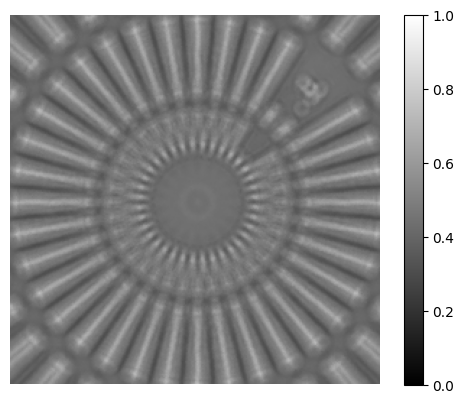

-5.000000000000001e-05
0.02603443626642186
平均0.02994884766522849
標準偏差0.02603443626642186
コントラスト0.40290322973742043


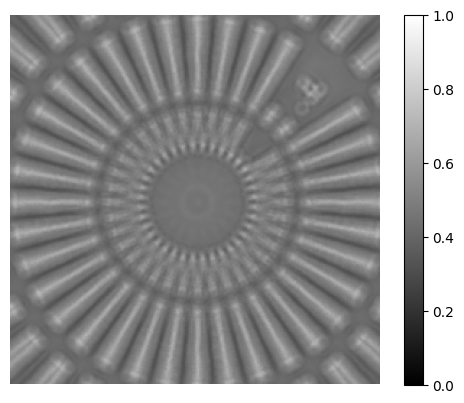

-4.000000000000001e-05
0.027198699985313022
平均0.031026135302309493
標準偏差0.027198699985313022
コントラスト0.39733840623316546


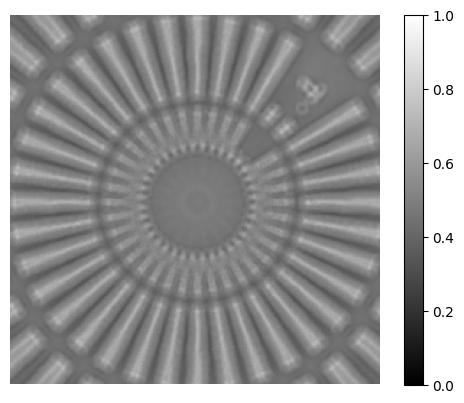

-3.000000000000001e-05
0.027582726432099493
平均0.031310613455551486
標準偏差0.027582726432099493
コントラスト0.38840615248395083


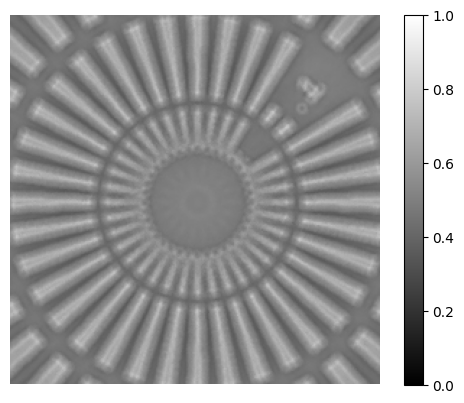

-2.0000000000000012e-05
0.028493855667957996
平均0.03220318711887203
標準偏差0.028493855667957996
コントラスト0.3491998076379656


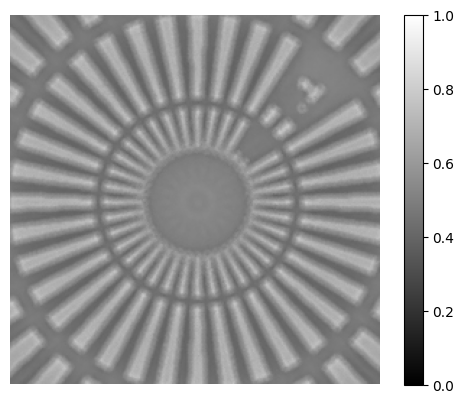

-1.0000000000000011e-05
0.028796234362429042
平均0.030876554498953355
標準偏差0.028796234362429042
コントラスト0.3465997664622544


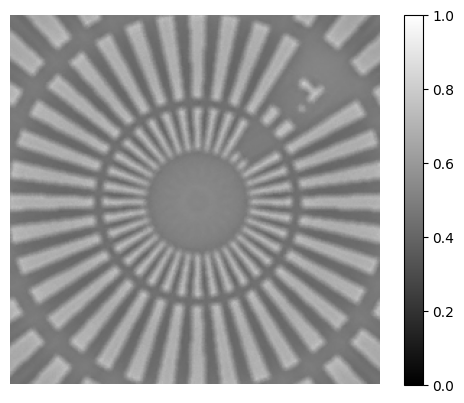

-1.0164395367051604e-20
0.0348122067668615
平均0.03480685250617165
標準偏差0.0348122067668615
コントラスト0.3370414600999057


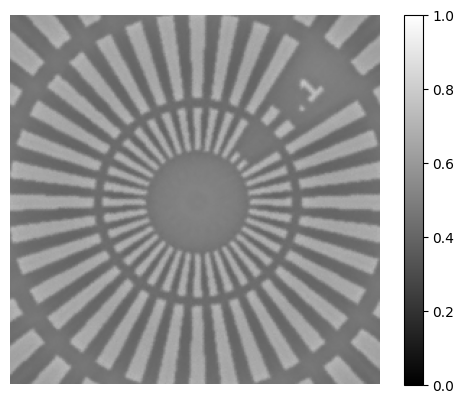

9.99999999999999e-06
0.038592288930546795
平均0.03788840939080936
標準偏差0.038592288930546795
コントラスト0.361584686495641


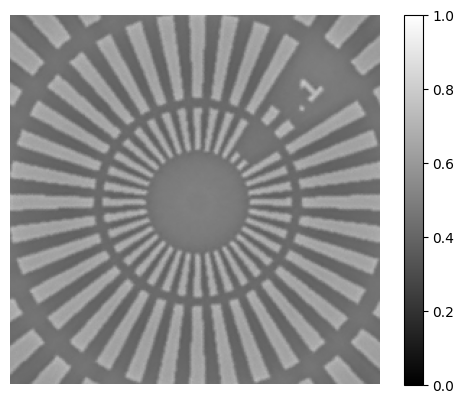

1.999999999999999e-05
0.03432112517938778
平均0.03629054816438751
標準偏差0.03432112517938778
コントラスト0.4081658313201676


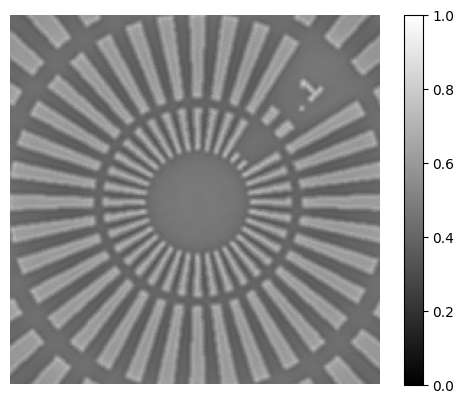

2.999999999999999e-05
0.03071532166619163
平均0.034063319466171464
標準偏差0.03071532166619163
コントラスト0.43291715889389243


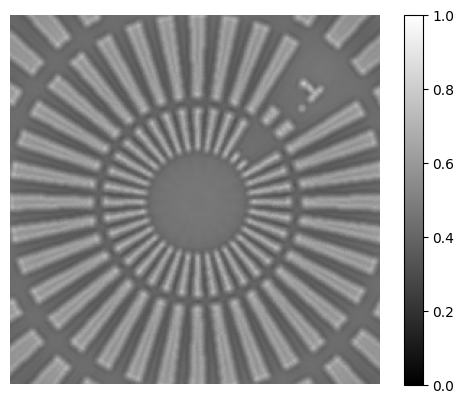

3.999999999999999e-05
0.028802745463212587
平均0.03266927722562917
標準偏差0.028802745463212587
コントラスト0.42764742487734364


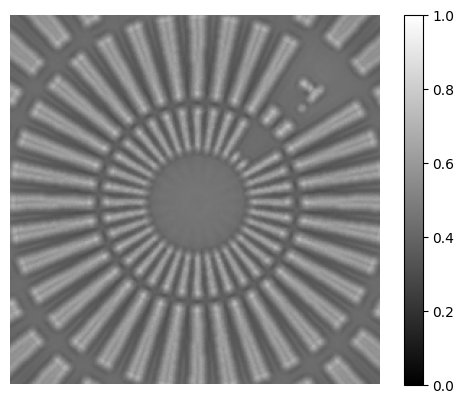

4.999999999999999e-05
0.02785245110244285
平均0.03155095459088408
標準偏差0.02785245110244285
コントラスト0.4403772871444427


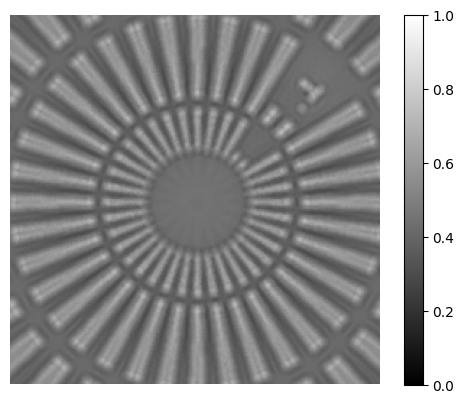

5.999999999999999e-05
0.026819248208433438
平均0.030920855998928572
標準偏差0.026819248208433438
コントラスト0.4624728753150023


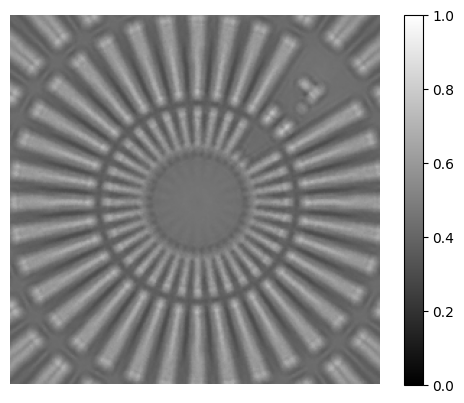

7e-05
0.02584780675554182
平均0.030290915562105305
標準偏差0.02584780675554182
コントラスト0.44608165645307174


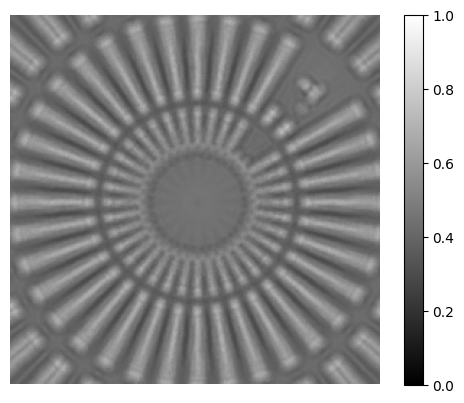

7.999999999999999e-05
0.025569218388420488
平均0.03025208540369735
標準偏差0.025569218388420488
コントラスト0.45122967330898905


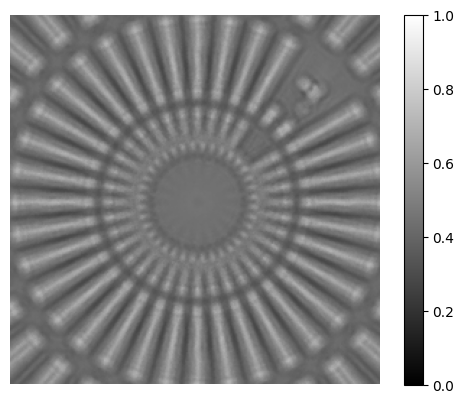

8.999999999999999e-05
0.025924978026580475
平均0.030688142717183887
標準偏差0.025924978026580475
コントラスト0.44468043929302237


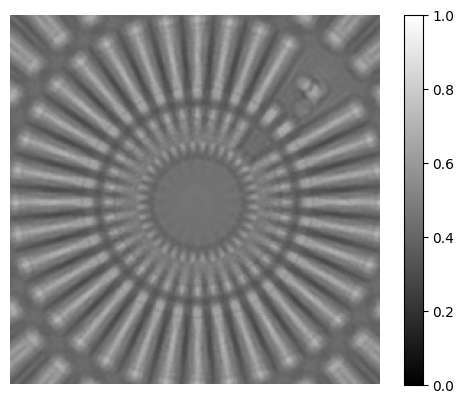

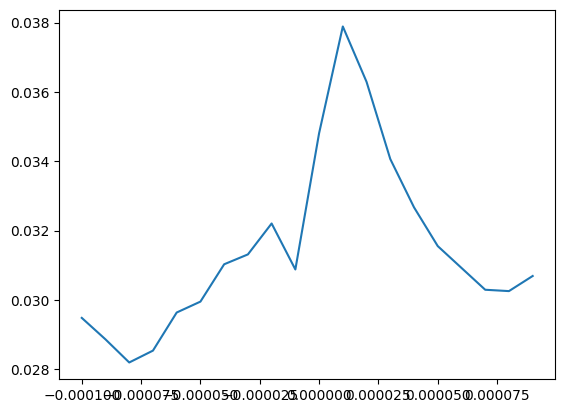

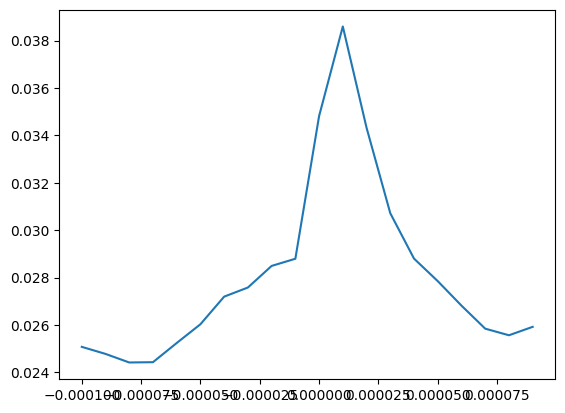

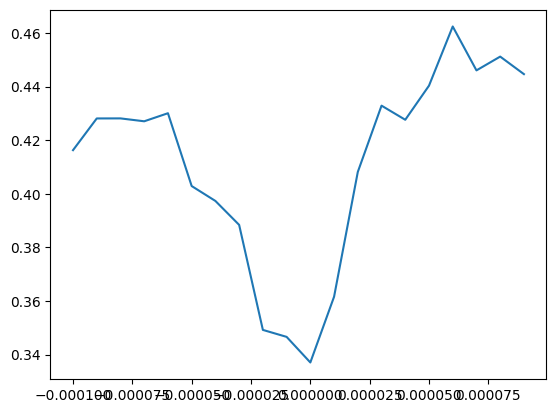

In [ ]:
defocus = -100e-6
for i in range(20):
  print(defocus)
  d_list.append(defocus)
  score_avg, score_std,img_total = score(coef, theta_x, theta_y, defocus = defocus, rot_angle = 20,crop_size=256)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
  img_dif = np.abs(img_dif)
  std = np.std(img_dif)
  avg = np.average(img_dif)
  print(std)
  print(f'平均{avg}')
  print(f'標準偏差{std}')
  print(f'コントラスト{cont}')
  plt.imshow(img_total, cmap="gray",vmax=1.0, vmin=0.0)
  plt.colorbar()
  plt.axis('off')
  plt.show()
  c_list.append(cont)
  ave_list.append(avg)
  std_list.append(std)
  defocus += 10e-6
plt.plot(d_list, ave_list)
plt.show()
plt.plot(d_list, std_list)
plt.show()
plt.plot(d_list, c_list)
plt.show()

In [ ]:
rms_list2=[]
ave_list2 = []
std_list2 = []
d_list2 = []
c_list2 = []

0


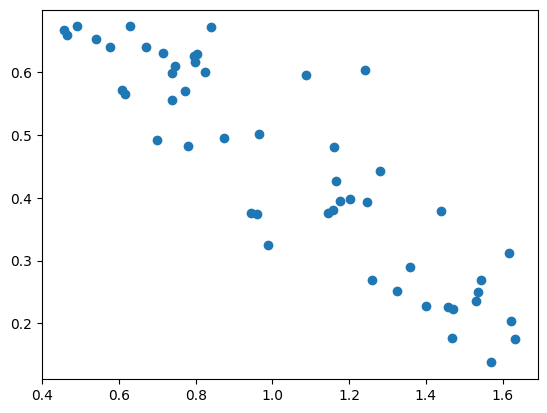

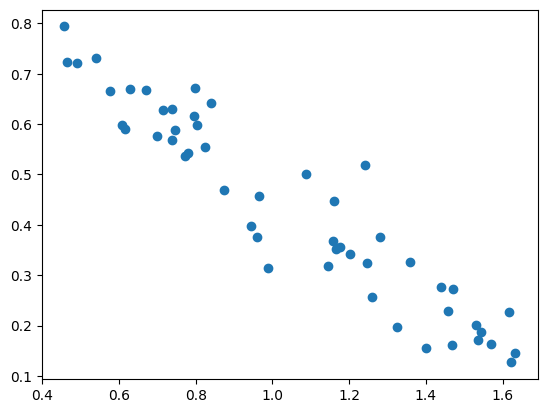

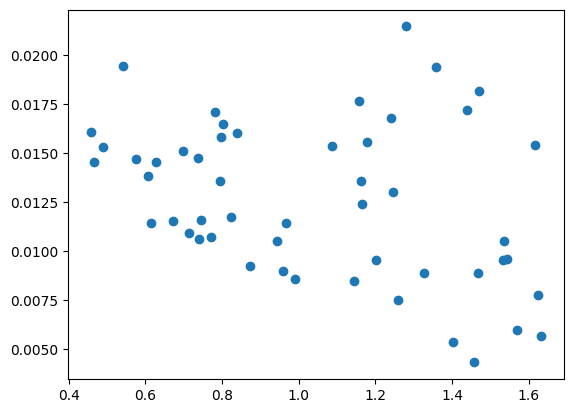

In [ ]:
coef_w = 1.5
for i in range(10):
  print(i)
  target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(6)]
  coef = [0.0] * 28
  coef[3], coef[5], coef[10], coef[14], coef[21], coef[27] = target
  pupil = make_wavefront_oblique(coef, theta_x, theta_y)
  rms = rms_calculate(pupil)
  rms_list2.append(rms)
  # score_avg, score_std = score(coef, theta_x, theta_y, defocus=25e-6, rot_angle = 8,crop_size=356)
  score_avg, score_std,img_total = score(coef, theta_x, theta_y, defocus = defocus, rot_angle = 8,crop_size=356)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  c_list2.append(cont)
  ave_list2.append(score_avg)
  std_list2.append(score_std)

plt.scatter(rms_list2, c_list2)
plt.show()
plt.scatter(rms_list2, ave_list2)
plt.show()
plt.scatter(rms_list2, std_list2)
plt.show()


In [35]:
rms_list=[]
ave_list = []
std_list = []
c_list = []
d_list = []

0
1
2
3
4
5
6
7
8
9


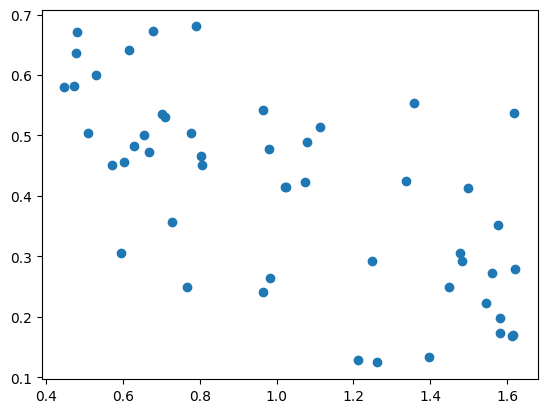

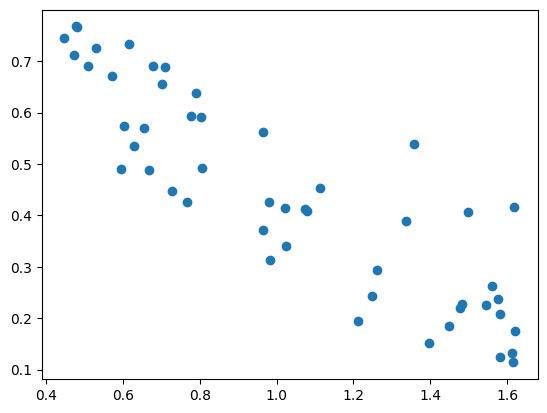

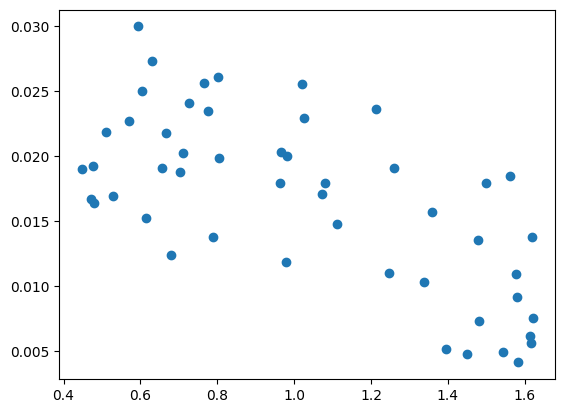

In [ ]:
coef_w = 0.8
theta_x = 1.73e-4
theta_y = 1.73e-4
for i in range(10):
  print(i)
  target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(10)]
  coef = [0.0] * 28
  coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target
  pupil = make_wavefront_oblique(coef, theta_x, theta_y)
  rms = rms_calculate(pupil)
  rms_list.append(rms)
  score_avg, score_std, img_total = score(coef, theta_x, theta_y, defocus=25e-6, rot_angle = 8,crop_size=356)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  ave_list.append(score_avg)
  std_list.append(score_std)
  c_list.append(cont)

plt.scatter(rms_list, c_list)
plt.show()
plt.scatter(rms_list, ave_list)
plt.show()
plt.scatter(rms_list, std_list)
plt.show()



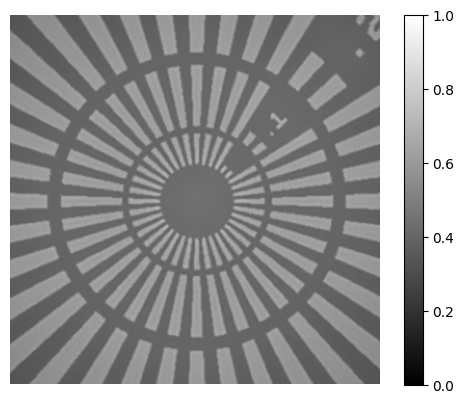

[0.0, 0.0, 0.0, -0.1692903563278626, 0.0, -0.0774832483681624, 0.0, 0.0, 0.0, 0.0, -0.123564951079156, 0.0, 0.0, 0.0, 0.3348169422510009, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.15589706363251374, 0.0, 0.0, 0.0, 0.0, 0.0, 0.2205208957563799]
0.3916716637308423
0.03633836920465344


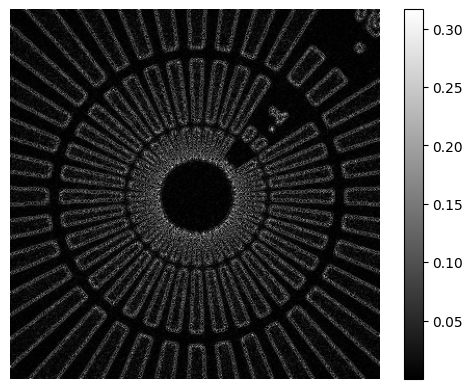

In [ ]:
score_avg, score_std, img_total = score(coef, 7.5e-4, theta_y, defocus=0e-6, rot_angle = 20,crop_size=356)
plt.imshow(img_total, cmap="gray",vmax=1.0, vmin=0.0)
plt.colorbar()
plt.axis('off')
plt.show()
cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
print(coef)
print(cont)

img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
img_dif = np.abs(img_dif)
std = np.std(img_dif)
print(std)
plt.imshow(img_dif, cmap="gray")
plt.colorbar()
plt.axis('off')
plt.show()

In [ ]:
coef = [0.0, 0.0, 0.0, -0.9055980866082185, 0.0, -0.18355831451347648, 1.2878147119032866, 0.0, 0.0, 0.5721207212931922, 1.052516729896864, 0.0, 0.0, 0.0, -1.001034314232653, 0.9799552025292835, 0.0, 0.0, 0.0, 0.0, 1.0266932943390712, -0.09635096122632825, 0.0, 0.0, 0.0, 0.0, 0.0, -0.064710760799924]
coef = [0.0, 0.0, 0.0, 0.6859425724987562, 0.0, -1.175189523910113, 1.171830380580257, 0.0, 0.0, -0.6189936731294906, -0.6897090196036303, 0.0, 0.0, 0.0, 0.43053345018065237, -0.08211242657700613, 0.0, 0.0, 0.0, 0.0, -1.0490995819470568, 1.4726622175164987, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5399535308604824]
coef = [0.0, 0.0, 0.0, -1.680503771678805, 0.0, 0.6713933719274054, 1.6351488936453353, 0.0, 0.0, -0.790211964363365, -0.949955920178731, 0.0, 0.0, 0.0, 1.5032412591053852, -1.2306687574565507, 0.0, 0.0, 0.0, 0.0, 1.238745426686177, -0.39215164554944504, 0.0, 0.0, 0.0, 0.0, 0.0, -0.539616175283201]

In [56]:
coef = [0.0, 0.0, 0.0, -0.03657730458015396, 0.0, 0.07476940765700424, -0.11003388789813243, 0.0, 0.0, 0.02285332608338908, 0.07604976932075946, 0.0, 0.0, 0.0, -0.08609675280341089, 0.09837740182385785, 0.0, 0.0, 0.0, 0.0, -0.22642899379463183, 0.1617941578318564, 0.0, 0.0, 0.0, 0.0, 0.0, 0.018381562704333165]
# coef = [0.0]*28
coef = [0.0, 0.0, 0.0, 0.18972485199858236, 0.0, 0.3328594850901523, 0.27089932799021843, 0.0, 0.0, 0.21791679676751752, -0.14645107371659538, 0.0, 0.0, 0.0, 0.0398695129967751, -0.014035341694805026, 0.0, 0.0, 0.0, 0.0, -0.1289112018252172, 0.04506360403396492, 0.0, 0.0, 0.0, 0.0, 0.0, 0.27698780028819225]
coef = [0.0, 0.0, 0.0, 0.008293095407671092, 0.0, -0.054927577436978764, 0.09382918794320949, 0.0, 0.0, -0.11094026674275206, -0.2282686159034458, 0.0, 0.0, 0.0, 0.20235287417955033, 0.06746606375478015, 0.0, 0.0, 0.0, 0.0, -0.06595076574962758, 0.16331812453785816, 0.0, 0.0, 0.0, 0.0, 0.0, 0.17330572850390452]
coef = [0.0, 0.0, 0.0, 0.18262882804806357, 0.0, -0.2283655976614266, -0.005073491550213194, 0.0, 0.0, 0.0312643074097515, 0.035621702376861575, 0.0, 0.0, 0.0, -0.01378226304341168, -0.24517194132160783, 0.0, 0.0, 0.0, 0.0, 0.17736334941776116, 0.11673725894914155, 0.0, 0.0, 0.0, 0.0, 0.0, -0.15770479494002523]
coef = [0.0, 0.0, 0.0, -0.004309648269405997, 0.0, -0.21355349430124942, -0.10393599832621153, 0.0, 0.0, 0.16875145366285038, 0.16652754079280235, 0.0, 0.0, 0.0, -0.10070725682527665, 0.18701357951090997, 0.0, 0.0, 0.0, 0.0, 0.19724661186560666, -0.10805284903553453, 0.0, 0.0, 0.0, 0.0, 0.0, 0.06389768616526942]
coef = [0.0, 0.0, 0.0, -0.2377578324678945, 0.0, -0.16259120933984786, -0.14773462004864057, 0.0, 0.0, 0.09340523808211681, 0.0681384055680615, 0.0, 0.0, 0.0, 0.16004991932691015, 0.2241182533256169, 0.0, 0.0, 0.0, 0.0, -0.17805824380345164, 0.05137376959896911, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08370435307466723]


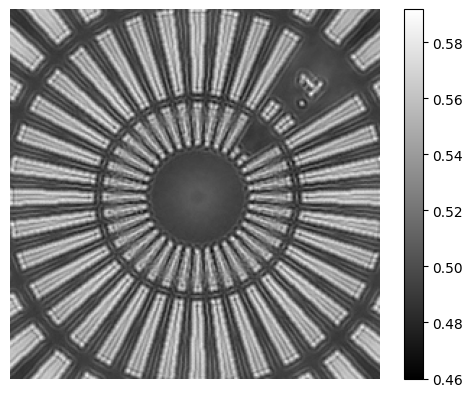

[0.0, 0.0, 0.0, -0.2377578324678945, 0.0, -0.16259120933984786, -0.14773462004864057, 0.0, 0.0, 0.09340523808211681, 0.0681384055680615, 0.0, 0.0, 0.0, 0.16004991932691015, 0.2241182533256169, 0.0, 0.0, 0.0, 0.0, -0.17805824380345164, 0.05137376959896911, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08370435307466723]
0.12549357071020237
0.016469233665294288


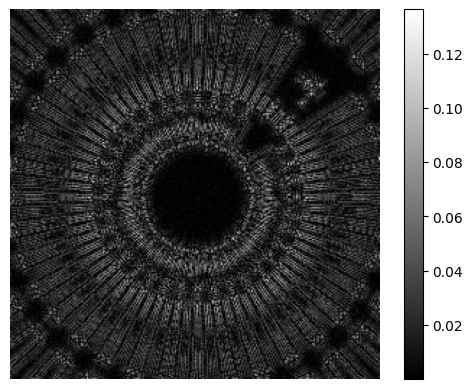

In [59]:
score_avg, score_std, img_total = score(coef, 7.0e-4, 7.0e-4, defocus=25e-6, rot_angle = 2,crop_size=256)
plt.imshow(img_total, cmap="gray")
plt.colorbar()
plt.axis('off')
plt.show()
cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
print(coef)
print(cont)

img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
img_dif = np.abs(img_dif)
std = np.std(img_dif)
print(std)
plt.imshow(img_dif, cmap="gray")
plt.colorbar()
plt.axis('off')
plt.show()

In [35]:
theta_x = 0.0e-4
totalList = []
xlist = []
for j in range(16):
    theta_y = 0.0e-4
    ylist = []
    xlist.append(theta_x)
    for i in range(16):
        print(f'theta_x:{theta_x} theta_y:{theta_y}')
        score_avg, score_std, img_total = score(coef, theta_x, theta_y, defocus=25e-6, rot_angle = 20,crop_size=256)
        img_total /= np.max(img_total)
        plt.imshow(img_total, cmap="gray")
        plt.colorbar()
        plt.axis('off')
        plt.show()
        cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
        print(coef)
        print(cont)

        img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
        img_dif = np.abs(img_dif)
        std = np.std(img_dif)
        print(std)
        plt.imshow(img_dif, cmap="gray")
        plt.colorbar()
        plt.axis('off')
        plt.show()
        theta_y += 0.5e-4
        ylist.append(std)
    theta_x += 0.5e-4
    totalList.append(ylist)


Output hidden; open in https://colab.research.google.com to view.

theta_x:0.0007 theta_y:0.0007


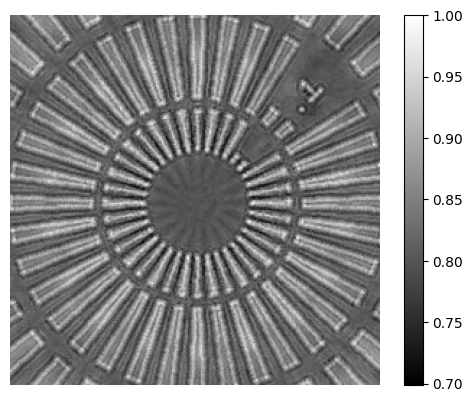

[0.0, 0.0, 0.0, 0.18262882804806357, 0.0, -0.2283655976614266, -0.005073491550213194, 0.0, 0.0, 0.0312643074097515, 0.035621702376861575, 0.0, 0.0, 0.0, -0.01378226304341168, -0.24517194132160783, 0.0, 0.0, 0.0, 0.0, 0.17736334941776116, 0.11673725894914155, 0.0, 0.0, 0.0, 0.0, 0.0, -0.15770479494002523]
0.1772228612575798
0.038006279140097396


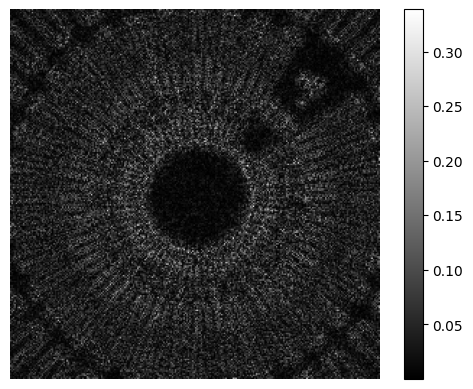

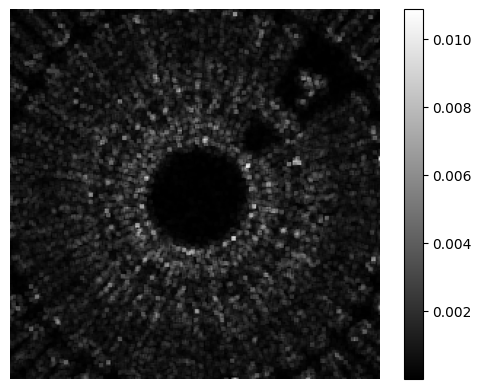

In [33]:
theta_x = 7.0e-4
theta_y = 7.0e-4
print(f'theta_x:{theta_x} theta_y:{theta_y}')
score_avg, score_std, img_total = score(coef, theta_x, theta_y, defocus=25e-6, rot_angle = 20,crop_size=256)
img_total /= np.max(img_total)
plt.imshow(img_total, cmap="gray")
plt.colorbar()
plt.axis('off')
plt.show()
cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
print(coef)
print(cont)
img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
img_dif = np.abs(img_dif)
std = np.std(img_dif)
print(std)
plt.imshow(img_dif, cmap="gray")
plt.colorbar()
plt.axis('off')
plt.show()

var_map = sliding_variance(img_dif, (3,3))
plt.imshow(var_map, cmap="gray")
plt.colorbar()
plt.axis('off')
plt.show()

0.44301752999175475


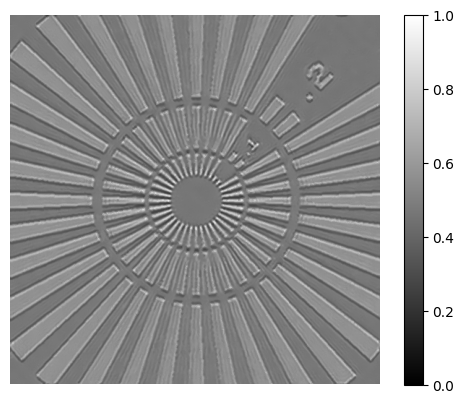

In [66]:
pupil = make_wavefront_oblique(coef, 0.0e-4, 0)
rms = rms_calculate(pupil)
print(rms)
img = img_coherent(pupil, defocus=25e-6)
plt.imshow(img, cmap="gray",vmax=1.0, vmin=0.0)
plt.colorbar()
plt.axis('off')
plt.show()

0
1
[0.0, 0.0, 0.0, 0.2419944561364547, 0.0, 0.0760589584254211, -0.12848826625537876, 0.0, 0.0, 0.1494717551921031, -0.06398725326847984, 0.0, 0.0, 0.0, 0.059897736870118234, -0.2416966807943215, 0.0, 0.0, 0.0, 0.0, -0.2395770943260141, 0.1302477921893348, 0.0, 0.0, 0.0, 0.0, 0.0, -0.004207256591682307]
0.18591656271546017


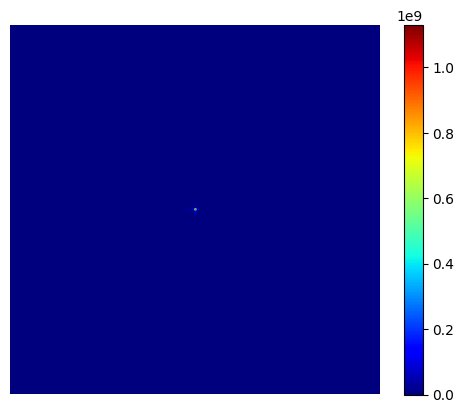

2
3
4
[0.0, 0.0, 0.0, -0.15590399658699375, 0.0, -0.04431676594158013, -0.1859333279219617, 0.0, 0.0, -0.023991456125212418, -0.22080705481214907, 0.0, 0.0, 0.0, 0.04828523702408272, -0.07079891253507037, 0.0, 0.0, 0.0, 0.0, 0.20558760715907837, -0.02149080123721986, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1974941158625127]
0.10712578186015828


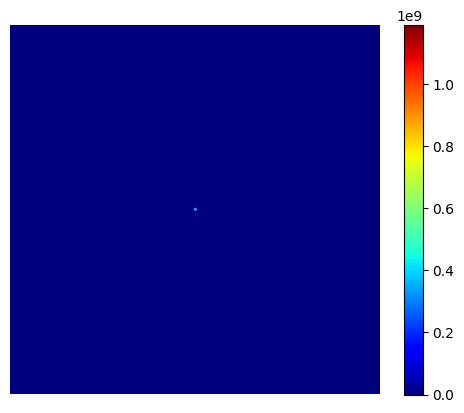

5
[0.0, 0.0, 0.0, 0.1251592175020474, 0.0, 0.1230334159276924, -0.05905173346090864, 0.0, 0.0, 0.24813847774429426, -0.1825478948835424, 0.0, 0.0, 0.0, -0.12699363615286027, -0.008248382964473666, 0.0, 0.0, 0.0, 0.0, 0.17297162443301967, -0.11060883108744371, 0.0, 0.0, 0.0, 0.0, 0.0, -0.25162314274810155]
0.29998919502114557


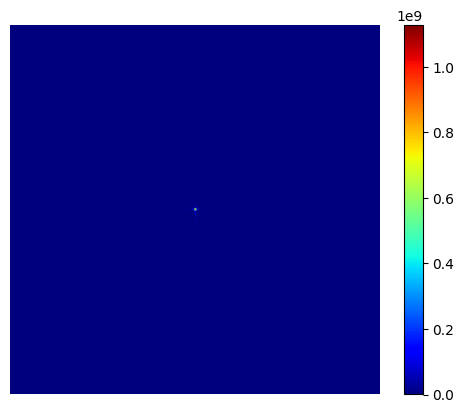

6
7
8
9
[0.0, 0.0, 0.0, 0.008293095407671092, 0.0, -0.054927577436978764, 0.09382918794320949, 0.0, 0.0, -0.11094026674275206, -0.2282686159034458, 0.0, 0.0, 0.0, 0.20235287417955033, 0.06746606375478015, 0.0, 0.0, 0.0, 0.0, -0.06595076574962758, 0.16331812453785816, 0.0, 0.0, 0.0, 0.0, 0.0, 0.17330572850390452]
0.23309496772490693


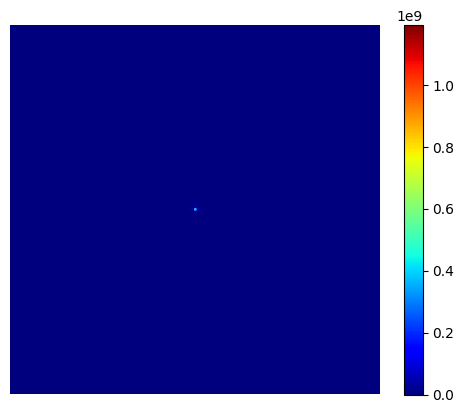

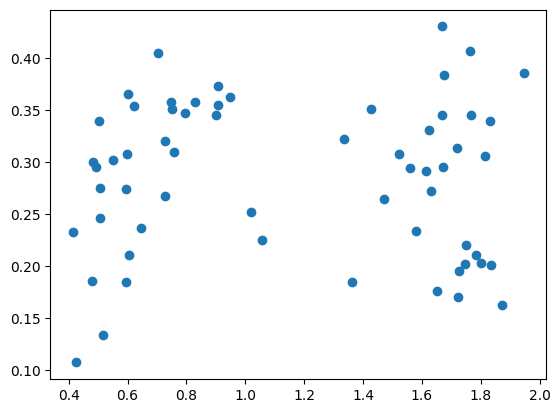

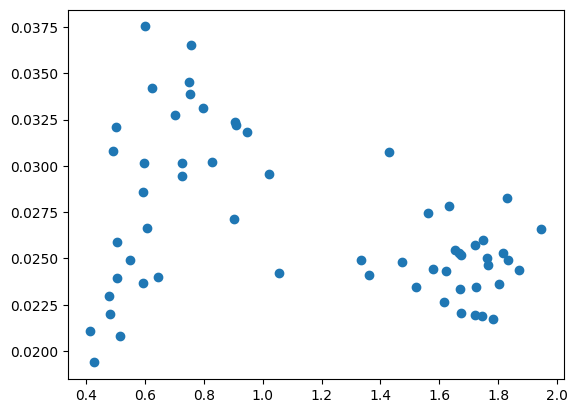

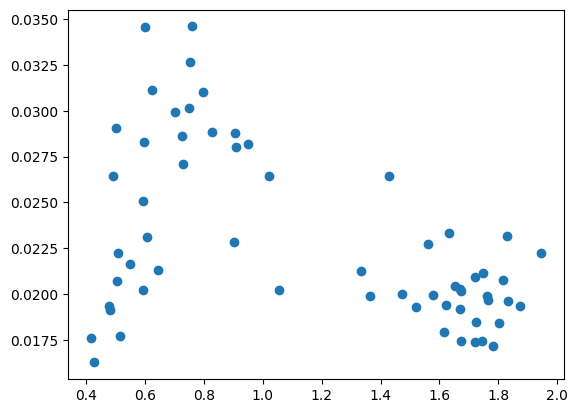

In [44]:
coef_w = 0.6
theta_x = 7.0e-4
theta_y = 0.0e-4
for i in range(10):
  print(i)
  target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(10)]
  coef = [0.0] * 28
  coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target
  pupil = make_wavefront_oblique(coef, theta_x, theta_y)
  pupil0 = make_wavefront(coef)
  rms = rms_calculate(pupil0)
  rms_list.append(rms)
  score_avg, score_std, img_total = score(coef, theta_x, theta_y, defocus=0e-6, rot_angle = 20,crop_size=256)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
  img_dif = np.abs(img_dif)
  std = np.std(img_dif)
  avg = np.average(img_dif)
  ave_list.append(avg)
  std_list.append(std)
  c_list.append(cont)
  if rms < 0.5:
    print(coef)
    print(cont)
    print(std)
    psf0 = psf(pupil)
    plt.imshow(psf0, cmap="jet")
    plt.colorbar()
    plt.axis('off')
    plt.show()

plt.scatter(rms_list, c_list)
plt.show()
plt.scatter(rms_list, ave_list)
plt.show()
plt.scatter(rms_list, std_list)
plt.show()



0
[0.0, 0.0, 0.0, 0.18262882804806357, 0.0, -0.2283655976614266, -0.005073491550213194, 0.0, 0.0, 0.0312643074097515, 0.035621702376861575, 0.0, 0.0, 0.0, -0.01378226304341168, -0.24517194132160783, 0.0, 0.0, 0.0, 0.0, 0.17736334941776116, 0.11673725894914155, 0.0, 0.0, 0.0, 0.0, 0.0, -0.15770479494002523]
0.24312170807075684
0.021358440116257458


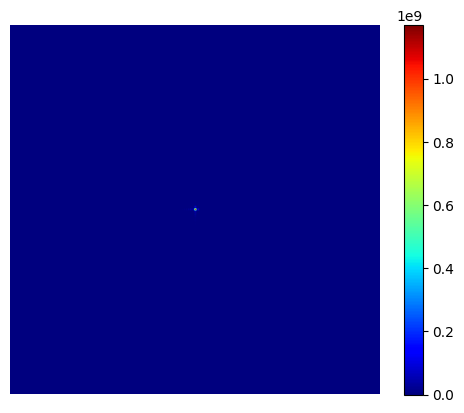

1
2
[0.0, 0.0, 0.0, -0.022111247626323882, 0.0, 0.11563718252345034, -0.22898878472982787, 0.0, 0.0, -0.25819378487058225, -0.2157476366942892, 0.0, 0.0, 0.0, -0.1634937752405569, 0.05256772949027433, 0.0, 0.0, 0.0, 0.0, -0.13239818837528422, -0.1193416889624769, 0.0, 0.0, 0.0, 0.0, 0.0, -0.06363021676626979]
0.35393447366203795
0.030530851973350714


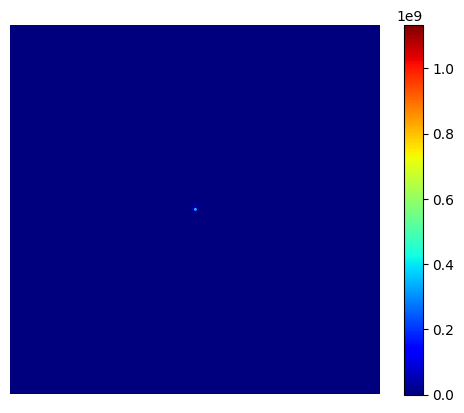

3
[0.0, 0.0, 0.0, 0.18449377258923255, 0.0, -0.1774528708263119, -0.10387765440473806, 0.0, 0.0, -0.13128924859894028, -0.00352224277210772, 0.0, 0.0, 0.0, 0.028523199019452605, -0.1195521406596868, 0.0, 0.0, 0.0, 0.0, 0.08135330567145038, -0.1702105085298897, 0.0, 0.0, 0.0, 0.0, 0.0, -0.042858063904995414]
0.326172365284197
0.028762516319310625


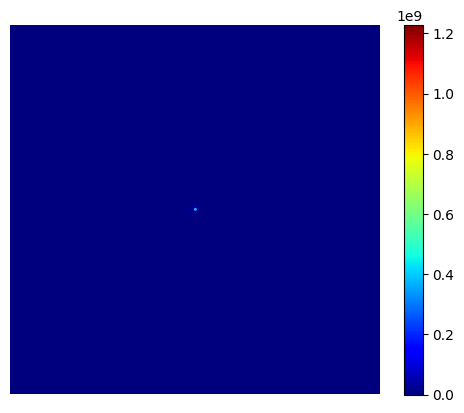

4
[0.0, 0.0, 0.0, -0.018093651305503333, 0.0, 0.2169787624396327, 0.1585145412621184, 0.0, 0.0, -0.17451363651944546, -0.1109354903330515, 0.0, 0.0, 0.0, -0.2457387227344188, 0.1861408223454188, 0.0, 0.0, 0.0, 0.0, 0.021625062512206472, -0.03370882759192617, 0.0, 0.0, 0.0, 0.0, 0.0, 0.16383273520684621]
0.32476859422539756
0.027083446388813527


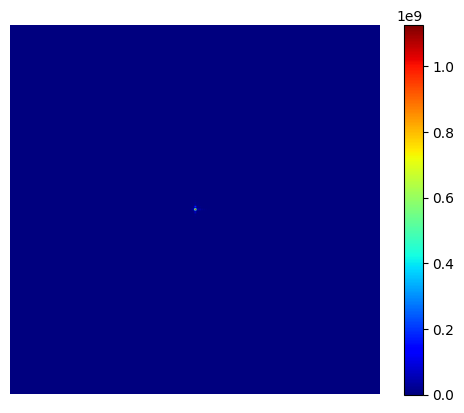

5
[0.0, 0.0, 0.0, -0.17612557864722028, 0.0, -0.03668220787623355, 0.17868733390433905, 0.0, 0.0, 0.15077102478208743, 0.2630723970069044, 0.0, 0.0, 0.0, 0.14177733488238065, -0.0029807124146676856, 0.0, 0.0, 0.0, 0.0, 0.04510085718491719, 0.23705439105492615, 0.0, 0.0, 0.0, 0.0, 0.0, 0.12732721162815402]
0.3134663220755506
0.027402272748957877


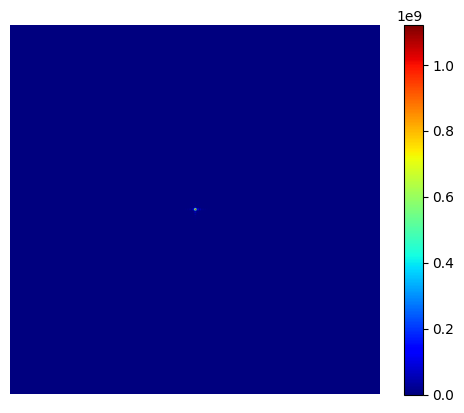

6
7
8
9


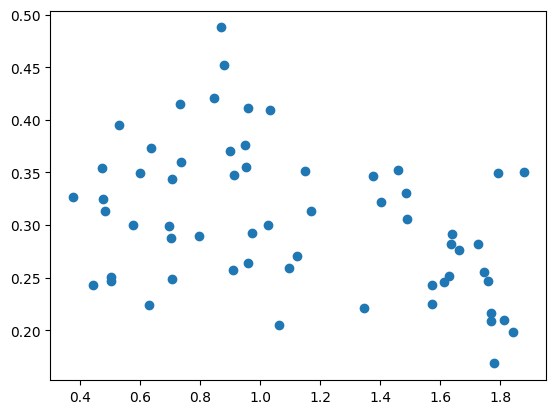

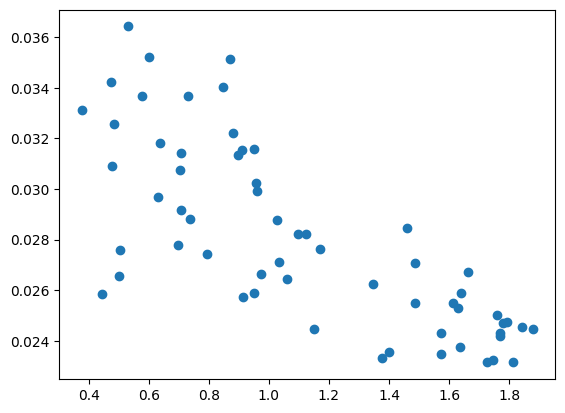

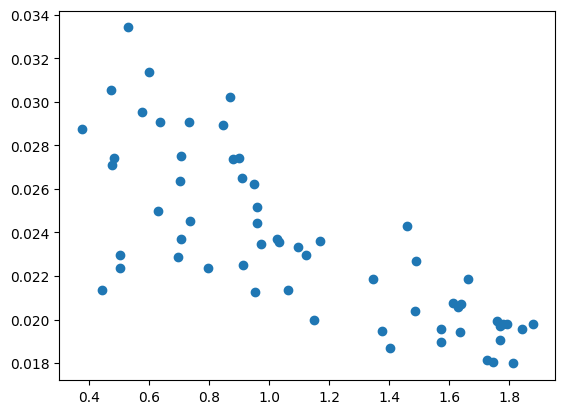

In [60]:
coef_w = 0.6
theta_x = 7.0e-4
theta_y = 0.0e-4
for i in range(10):
  print(i)
  target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(10)]
  coef = [0.0] * 28
  coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target
  pupil = make_wavefront_oblique(coef, theta_x, theta_y)
  pupil0 = make_wavefront(coef)
  rms = rms_calculate(pupil0)
  rms_list.append(rms)
  score_avg, score_std, img_total = score(coef, theta_x, theta_y, defocus=25e-6, rot_angle = 20,crop_size=256)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
  img_dif = np.abs(img_dif)
  std = np.std(img_dif)
  avg = np.average(img_dif)
  ave_list.append(avg)
  std_list.append(std)
  c_list.append(cont)
  if rms < 0.5:
    print(coef)
    print(cont)
    print(std)
    psf0 = psf(pupil)
    plt.imshow(psf0, cmap="jet")
    plt.colorbar()
    plt.axis('off')
    plt.show()

plt.scatter(rms_list, c_list)
plt.show()
plt.scatter(rms_list, ave_list)
plt.show()
plt.scatter(rms_list, std_list)
plt.show()



0
1
[0.0, 0.0, 0.0, 0.009490539782140817, 0.0, 0.017284442310195658, -0.03830727010398893, 0.0, 0.0, 0.12966085256018622, 0.051442504080208784, 0.0, 0.0, 0.0, 0.07977669588587388, -0.05521719751873866, 0.0, 0.0, 0.0, 0.0, 0.26133769195038253, 0.20307525782487296, 0.0, 0.0, 0.0, 0.0, 0.0, -0.029013201495701857]
0.08858441052260843
0.014122314859196593


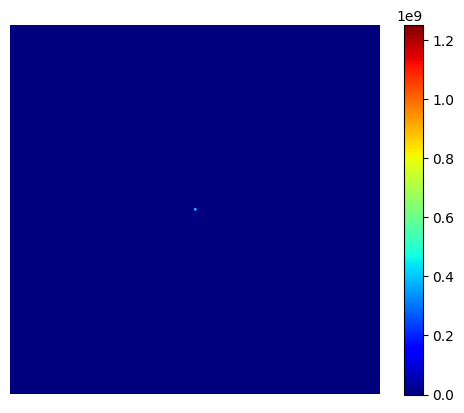

2
3
4
5
6
[0.0, 0.0, 0.0, -0.08041057469012261, 0.0, 0.1602164693329287, 0.07941291442211201, 0.0, 0.0, 0.006025170898533716, 0.06320387582152043, 0.0, 0.0, 0.0, 0.21991185041418787, -0.17228388336912473, 0.0, 0.0, 0.0, 0.0, 0.2014805095520505, -0.028715321709763486, 0.0, 0.0, 0.0, 0.0, 0.0, -0.07650903249130406]
0.13695335127789815
0.02147199299518884


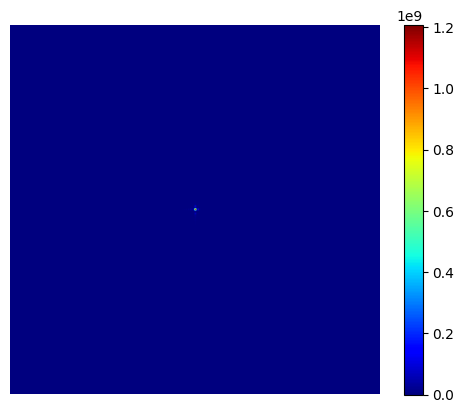

7
8
[0.0, 0.0, 0.0, -0.2377578324678945, 0.0, -0.16259120933984786, -0.14773462004864057, 0.0, 0.0, 0.09340523808211681, 0.0681384055680615, 0.0, 0.0, 0.0, 0.16004991932691015, 0.2241182533256169, 0.0, 0.0, 0.0, 0.0, -0.17805824380345164, 0.05137376959896911, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08370435307466723]
0.11526189786974884
0.016971828841509568


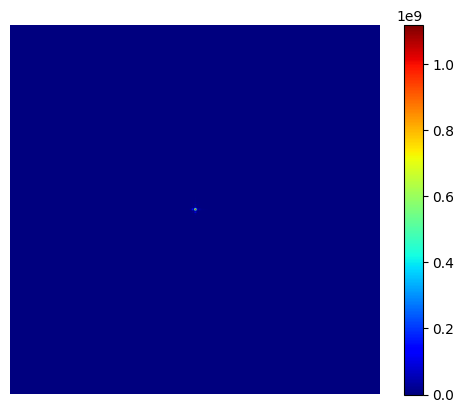

9


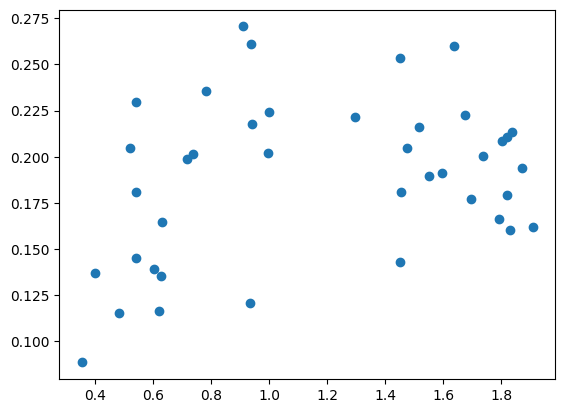

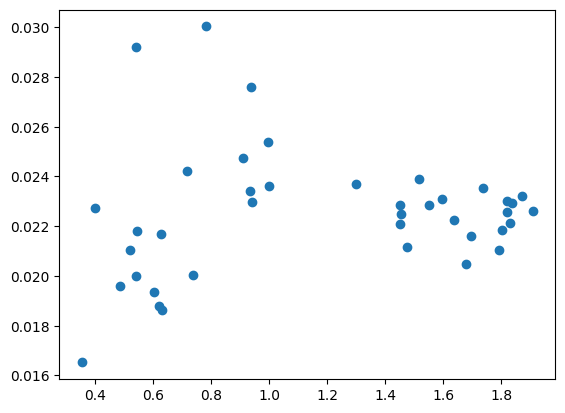

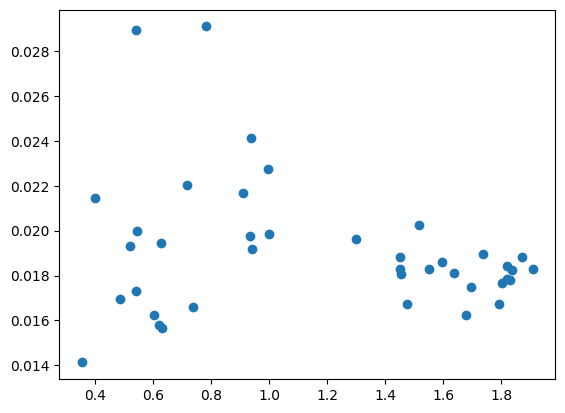

In [39]:
coef_w = 0.6
theta_x = 7.0e-4
theta_y = 7.0e-4
for i in range(10):
  print(i)
  target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(10)]
  coef = [0.0] * 28
  coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target
  pupil = make_wavefront_oblique(coef, theta_x, theta_y)
  pupil0 = make_wavefront(coef)
  rms = rms_calculate(pupil0)
  rms_list.append(rms)
  score_avg, score_std, img_total = score(coef, theta_x, theta_y, defocus=0e-6, rot_angle = 20,crop_size=256)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
  img_dif = np.abs(img_dif)
  std = np.std(img_dif)
  avg = np.average(img_dif)
  ave_list.append(avg)
  std_list.append(std)
  c_list.append(cont)
  if rms < 0.5:
    print(coef)
    print(cont)
    print(std)
    psf0 = psf(pupil)
    plt.imshow(psf0, cmap="jet")
    plt.colorbar()
    plt.axis('off')
    plt.show()

plt.scatter(rms_list, c_list)
plt.show()
plt.scatter(rms_list, ave_list)
plt.show()
plt.scatter(rms_list, std_list)
plt.show()



In [ ]:
rms_arr = np.array(rms_list)
std_arr = np.array(std_list)
print(np.corrcoef(rms_arr, std_arr))

0
[0.0, 0.0, 0.0, 0.0006879016487712497, 0.0, 0.20311466597936867, 0.08053231152644008, 0.0, 0.0, -0.11052244491113516, 0.003892337902040577, 0.0, 0.0, 0.0, -0.1841326337184434, -0.18684275917129411, 0.0, 0.0, 0.0, 0.0, 0.21552209213890378, 0.15014463174237164, 0.0, 0.0, 0.0, 0.0, 0.0, 0.24220266432227483]
0.17827589499856444
0.022672879957333008


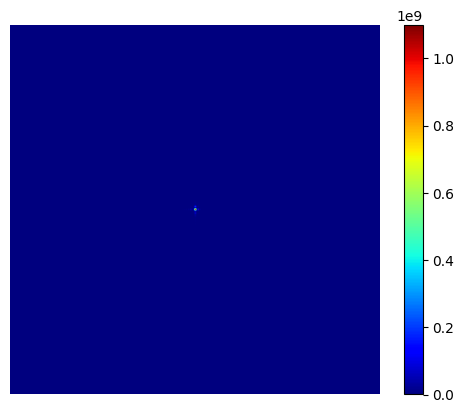

1
[0.0, 0.0, 0.0, 0.1837099725299799, 0.0, 0.18391277386340982, -0.2250503440495496, 0.0, 0.0, -0.012233424218852984, 0.0558136443690061, 0.0, 0.0, 0.0, 0.2011901273218905, -0.009075977400110569, 0.0, 0.0, 0.0, 0.0, -0.20622070823631783, 0.010325322807999193, 0.0, 0.0, 0.0, 0.0, 0.0, -0.034256732061064665]
0.2550127182987898
0.024547558872762963


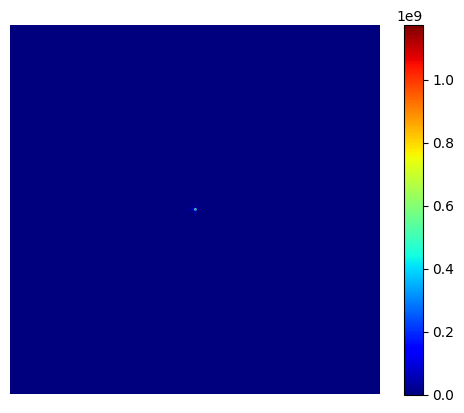

2
[0.0, 0.0, 0.0, 0.23226776025611234, 0.0, 0.14589277397515288, 0.16849662924789544, 0.0, 0.0, -0.01270316592828713, 0.02055729387537414, 0.0, 0.0, 0.0, 0.1569619416797307, -0.2271218903717902, 0.0, 0.0, 0.0, 0.0, -0.17995743799039243, 0.10238418286649387, 0.0, 0.0, 0.0, 0.0, 0.0, -0.1439840035173489]
0.2510920736764655
0.026985859838205953


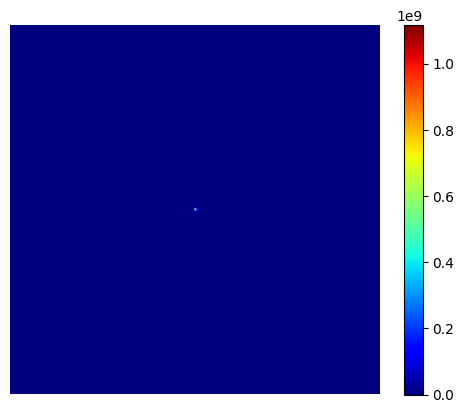

3
[0.0, 0.0, 0.0, -0.12195801753090829, 0.0, -0.20833034877871265, -0.09142346178568034, 0.0, 0.0, 0.24596199415727166, 0.14873133018448348, 0.0, 0.0, 0.0, 0.11905166435993958, 0.12084866160468577, 0.0, 0.0, 0.0, 0.0, 0.09263896337832833, -0.16737144994055891, 0.0, 0.0, 0.0, 0.0, 0.0, -0.04926489071530449]
0.16153557978940075
0.021891781827924835


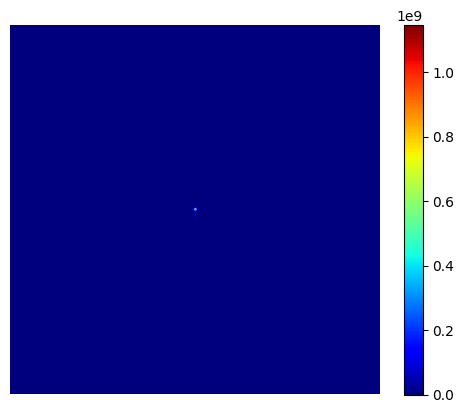

4
[0.0, 0.0, 0.0, -0.004309648269405997, 0.0, -0.21355349430124942, -0.10393599832621153, 0.0, 0.0, 0.16875145366285038, 0.16652754079280235, 0.0, 0.0, 0.0, -0.10070725682527665, 0.18701357951090997, 0.0, 0.0, 0.0, 0.0, 0.19724661186560666, -0.10805284903553453, 0.0, 0.0, 0.0, 0.0, 0.0, 0.06389768616526942]
0.19274982771022617
0.022359483214986816


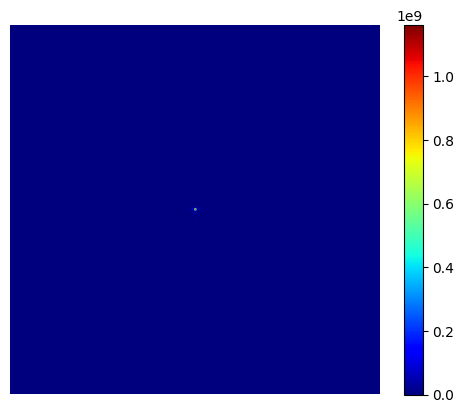

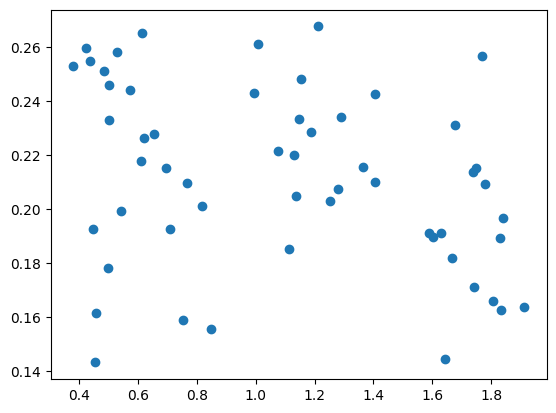

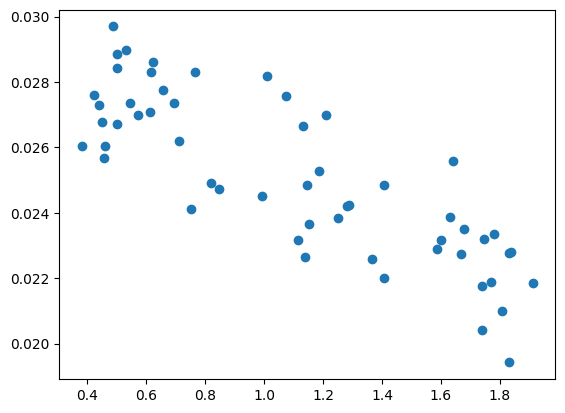

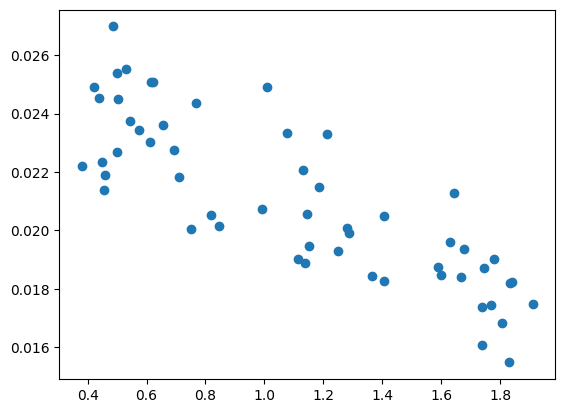

In [18]:
coef_w = 0.5
theta_x = 7.0e-4
theta_y = 7.0e-4
for i in range(5):
  print(i)
  target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(10)]
  coef = [0.0] * 28
  coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target
  pupil = make_wavefront_oblique(coef, theta_x, theta_y)
  pupil0 = make_wavefront(coef)
  rms = rms_calculate(pupil0)
  rms_list.append(rms)
  score_avg, score_std, img_total = score(coef, theta_x, theta_y, defocus=25e-6, rot_angle = 20,crop_size=256)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
  img_dif = np.abs(img_dif)
  std = np.std(img_dif)
  avg = np.average(img_dif)
  ave_list.append(avg)
  std_list.append(std)
  c_list.append(cont)
  if rms < 0.5:
    print(coef)
    print(cont)
    print(std)
    psf0 = psf(pupil)
    plt.imshow(psf0, cmap="jet")
    plt.colorbar()
    plt.axis('off')
    plt.show()

plt.scatter(rms_list, c_list)
plt.show()
plt.scatter(rms_list, ave_list)
plt.show()
plt.scatter(rms_list, std_list)
plt.show()



In [19]:
rms_arr = np.array(rms_list)
std_arr = np.array(std_list)
print(np.corrcoef(rms_arr, std_arr))

[[ 1.         -0.83167582]
 [-0.83167582  1.        ]]


0
1
2
3
4
5
6
7
8
9


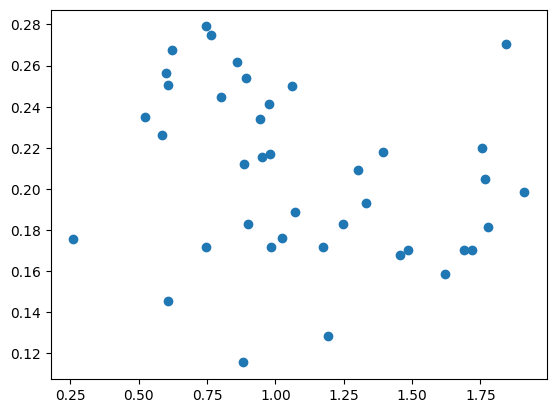

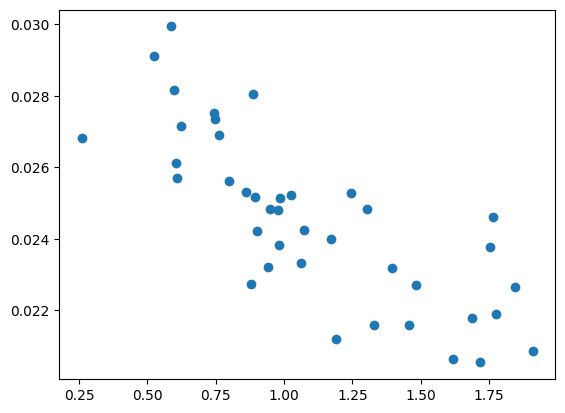

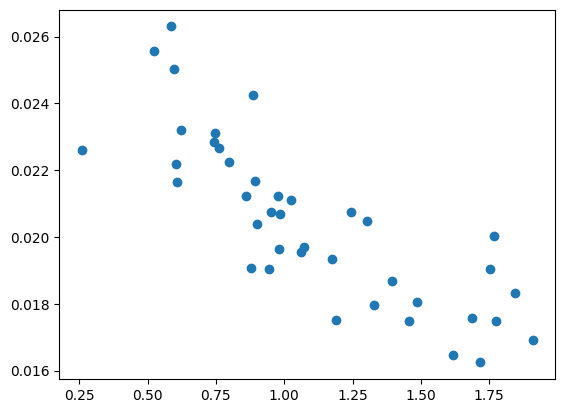

In [24]:
coef_w = 1.0
theta_x = 7.0e-4
theta_y = 7.0e-4
for i in range(10):
  print(i)
  target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(6)]
  coef = [0.0] * 28
  coef[3], coef[5], coef[10], coef[14], coef[21], coef[27] = target
  pupil = make_wavefront_oblique(coef, theta_x, theta_y)
  pupil0 = make_wavefront(coef)
  rms = rms_calculate(pupil0)
  rms_list.append(rms)
  score_avg, score_std, img_total = score(coef, theta_x, theta_y, defocus=25e-6, rot_angle = 20,crop_size=256)
  cont = (np.max(img_total) - np.min(img_total)) / (np.max(img_total) + np.min(img_total))
  img_dif = cv2.Laplacian(img_total, cv2.CV_64F)
  img_dif = np.abs(img_dif)
  std = np.std(img_dif)
  avg = np.average(img_dif)
  ave_list.append(avg)
  std_list.append(std)
  c_list.append(cont)
  # if cont > 0.4:
  #   print(coef)
  #   print(cont)

plt.scatter(rms_list, c_list)
plt.show()
plt.scatter(rms_list, ave_list)
plt.show()
plt.scatter(rms_list, std_list)
plt.show()



In [25]:
rms_arr2 = np.array(rms_list)
std_arr2 = np.array(std_list)
print(np.corrcoef(rms_arr2, std_arr2))

[[ 1.         -0.81556527]
 [-0.81556527  1.        ]]


In [ ]:
coef = [0.0]*28
pupil = make_wavefront(coef)
defocus = -100e-6
c_list = []
d_list = []
for i in range(21):
  print(defocus)
  d_list.append(defocus)
  img = img_coherent(pupil, defocus=defocus)
  img_diff = cv2.Laplacian(img, cv2.CV_64F)
  img_diff = np.abs(img_diff)
  cont = (np.max(img) - np.min(img)) / (np.max(img) + np.min(img))
  print(f'コントラスト{cont}')
  plt.imshow(img, cmap="gray",vmax=1.0, vmin=0.0)
  plt.colorbar()
  plt.axis('off')
  plt.show()
  plt.imshow(img_diff, cmap="gray", vmin=0.0)
  plt.colorbar()
  plt.axis('off')
  plt.show()
  c_list.append(cont)
  defocus += 10e-6
plt.plot(d_list, c_list)
plt.show()


Output hidden; open in https://colab.research.google.com to view.

[0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
1.7895459751602683


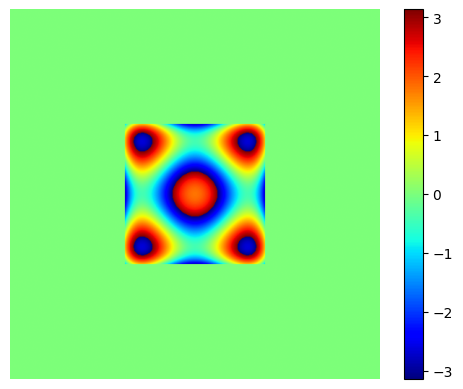

-0.0001
コントラスト0.8712310621957916


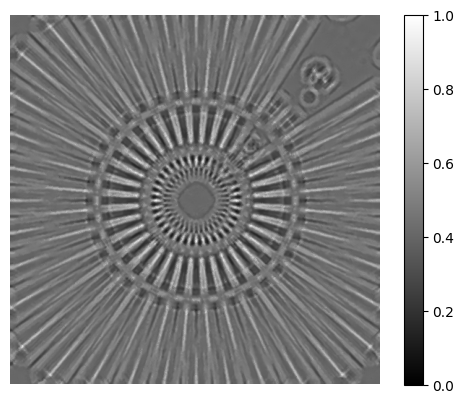

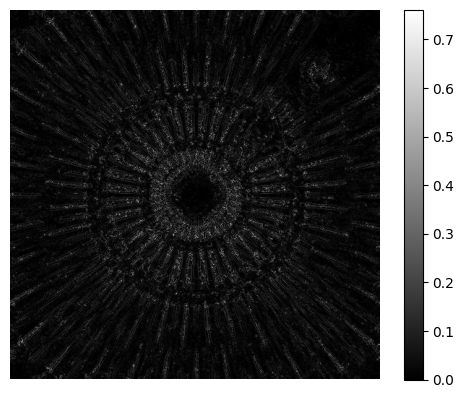

0.0
コントラスト0.8139183950075823


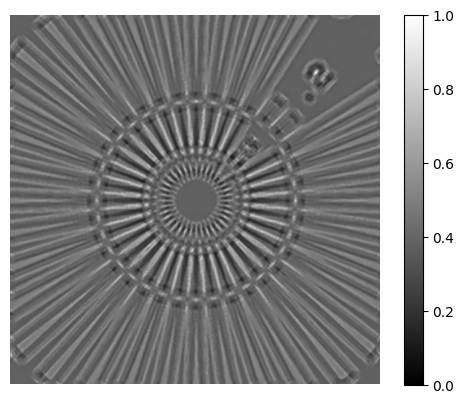

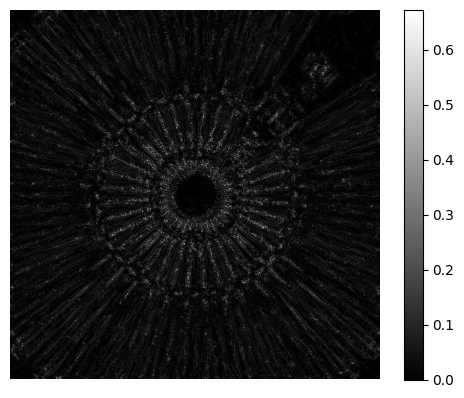

0.0001
コントラスト0.7784540138283903


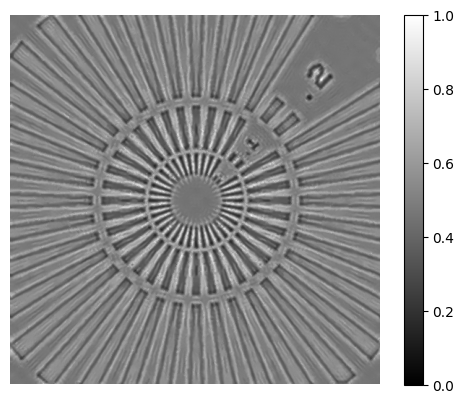

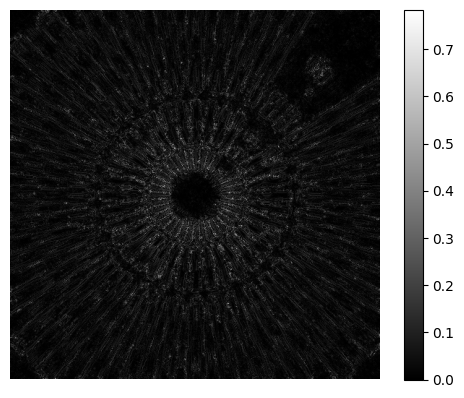

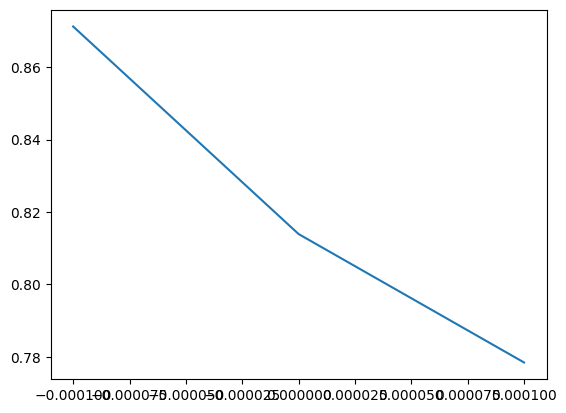

1.7895459751602683
tf.Tensor(0.2617181, shape=(), dtype=float32)
平均0.821201157010588
標準偏差0.038224548331633676


In [233]:
coef = [0.0]*28

# coef_w = 0.5
# target = [2*random.uniform(0.0, coef_w)-coef_w for i in range(4)]
# coef[10], coef[14], coef[21], coef[27] = target #  coef[3], coef[5],
# coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target
coef2 = 1.0
coef[3], coef[5] = coef2, coef2
coef4 = -1.0
coef[10], coef[14] = coef4, coef4
# coef[10] = 1.5
# coef[14] = -0.5
# coef6 = -0.5
# coef[21], coef[27] = coef6, coef6
# coef = [0.0, 0.0, 0.0, 0.4376058824186489, 0.0, -0.012849335138233995, 0.04603822522855872, 0.0, 0.0, 0.027912012860407915, 0.033569102976004475, 0.0, 0.0, 0.0, -0.5238987196559376, 0.0589858679588625, 0.0, 0.0, 0.0, 0.0, 0.05018417794930456, -0.6699811044457995, 0.0, 0.0, 0.0, 0.0, 0.0, -0.9580094350125389]


print(coef)
pupil = make_wavefront(coef)
print(rms_calculate(pupil))
plt.imshow(np.angle(pupil), cmap="jet")
plt.colorbar()
plt.axis('off')
plt.show()
defocus = -100e-6
c_list = []
d_list = []
i_list = []
id_list = []
for i in range(3):
  print(defocus)
  d_list.append(defocus)
  img = img_coherent(pupil, defocus=defocus)
  img_diff = cv2.Laplacian(img, cv2.CV_64F)
  img_diff = np.abs(img_diff)
  cont = (np.max(img) - np.min(img)) / (np.max(img) + np.min(img))
  print(f'コントラスト{cont}')
  plt.imshow(img, cmap="gray",vmax=1.0, vmin=0.0)
  plt.colorbar()
  plt.axis('off')
  plt.show()
  plt.imshow(img_diff, cmap="gray", vmin=0.0)
  plt.colorbar()
  plt.axis('off')
  plt.show()
  c_list.append(cont)
  i_list.append(img)
  id_list.append(img_diff)
  defocus += 100e-6
plt.plot(d_list, c_list)
plt.show()


print(rms_calculate(pupil))

img_culc1 = tf.expand_dims(id_list[0], axis=-1)
img_culc2 = tf.expand_dims(id_list[1], axis=-1)
img_culc3 = tf.expand_dims(id_list[2], axis=-1)

ssim = tf.image.ssim(img_culc1, img_culc3, max_val=1, filter_size=11, filter_sigma=1.5, k1=0.01, k2=0.03)
print(ssim)

c_array = np.array(c_list)
print(f"平均{np.average(c_array)}")
print(f"標準偏差{np.std(c_array)}")


In [234]:
coef_array = np.array(coef)
coef_array /= 5
print(coef_array)

[ 0.   0.   0.   0.2  0.   0.2  0.   0.   0.   0.  -0.2  0.   0.   0.
 -0.2  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0. ]


In [235]:
score = ssim_culc2_8_filter(pupil)
print(score)

0.7719453


0.8065823
1.5773214764520083


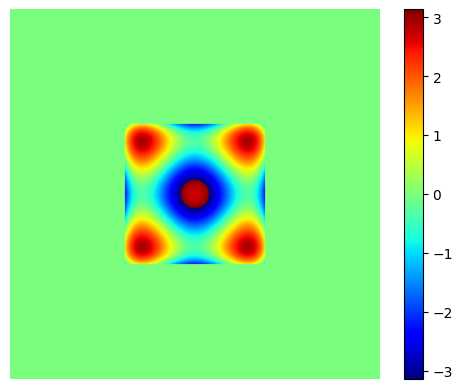

In [236]:
coef_or = np.array(coef)
coef_culc = coef_or - coef_array
coef2 = coef_culc.tolist()

pupil = make_wavefront(coef2)

score = ssim_culc2_8_filter(pupil)
print(score)

print(rms_calculate(pupil))
plt.imshow(np.angle(pupil), cmap="jet")
plt.colorbar()
plt.axis('off')
plt.show()

0.83483565
0.2583507015564902


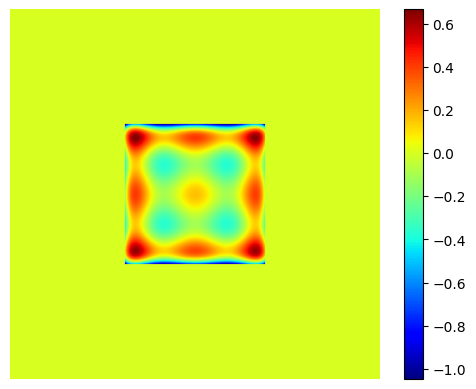

In [231]:
coef_or = np.array(coef2)
coef_culc = coef_or - coef_array
coef2 = coef_culc.tolist()

pupil = make_wavefront(coef2)

score = ssim_culc2_8_filter(pupil)
print(score)

print(rms_calculate(pupil))
plt.imshow(np.angle(pupil), cmap="jet")
plt.colorbar()
plt.axis('off')
plt.show()

0.84500647
1.203573244233594


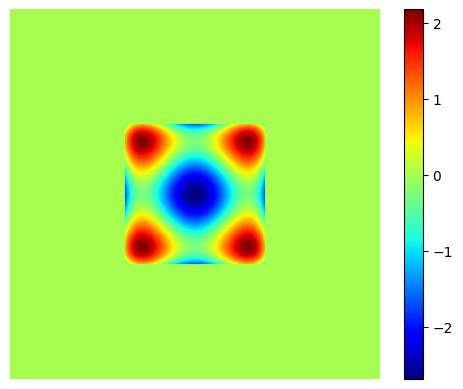

0.80039376
0.8023821628223962


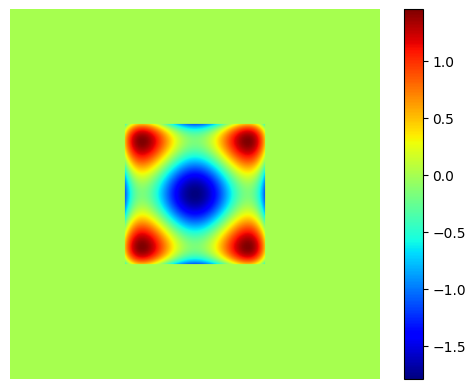

0.8572697
0.40119108141119814


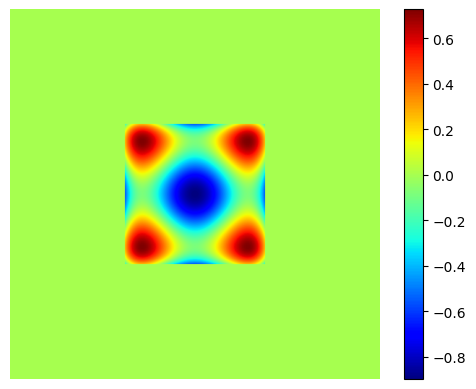

0.8733766
1.1135289396424441e-16


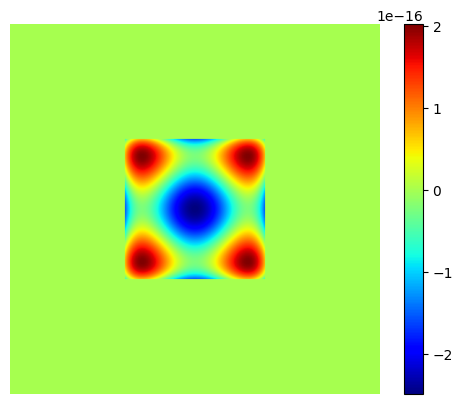

In [237]:
for i in range(4):
    coef_or = np.array(coef2)
    coef_culc = coef_or - coef_array
    coef2 = coef_culc.tolist()

    pupil = make_wavefront(coef2)

    score = ssim_culc2_8_filter(pupil)
    print(score)

    print(rms_calculate(pupil))
    plt.imshow(np.angle(pupil), cmap="jet")
    plt.colorbar()
    plt.axis('off')
    plt.show()

1.1135289396424441e-16


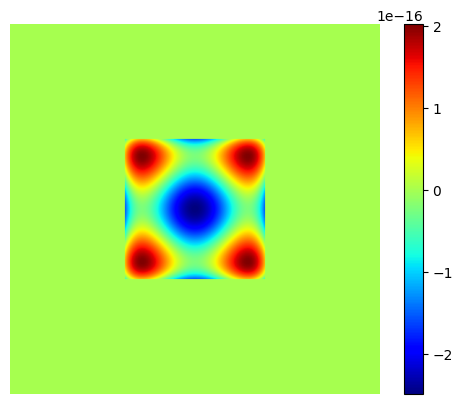

-0.0001
コントラスト0.7849392089824779


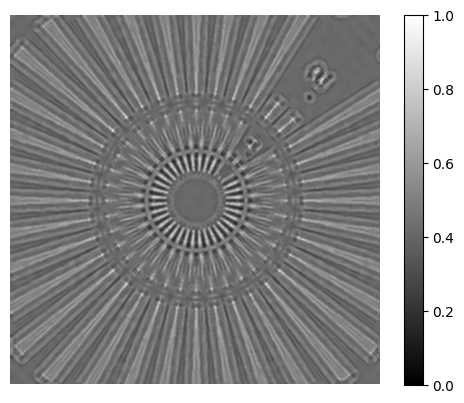

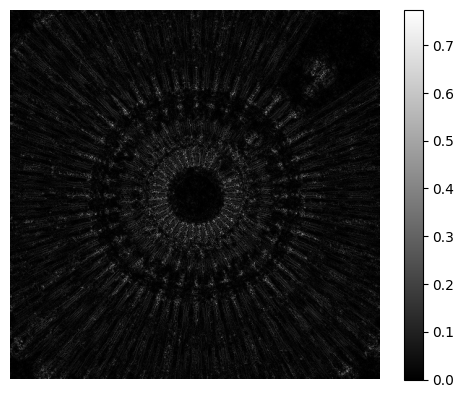

0.0
コントラスト0.29144503086388895


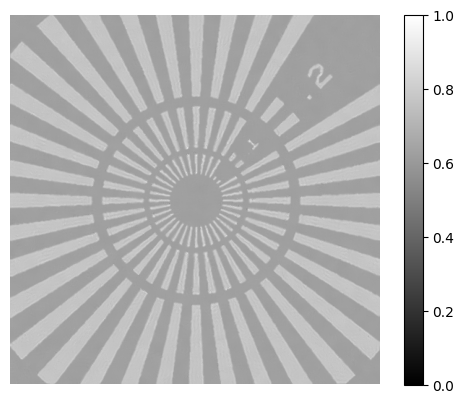

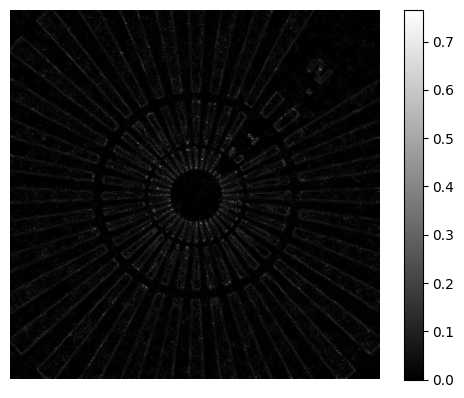

0.0001
コントラスト0.7782162306618068


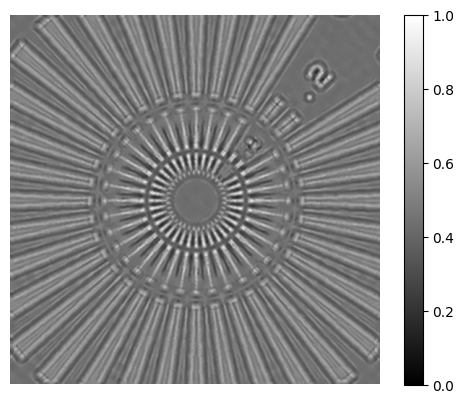

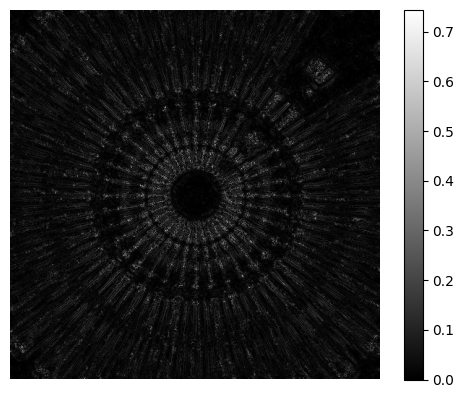

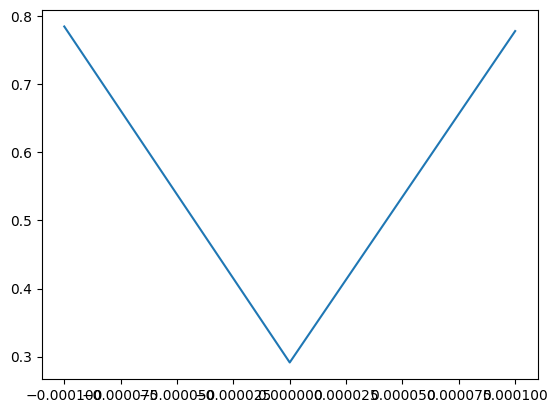

1.1135289396424441e-16
tf.Tensor(0.38220817, shape=(), dtype=float32)
平均0.6182001568360579
標準偏差0.2310670665574406


In [238]:

print(rms_calculate(pupil))
plt.imshow(np.angle(pupil), cmap="jet")
plt.colorbar()
plt.axis('off')
plt.show()
defocus = -100e-6
c_list = []
d_list = []
i_list = []
id_list = []
for i in range(3):
  print(defocus)
  d_list.append(defocus)
  img = img_coherent(pupil, defocus=defocus)
  img_diff = cv2.Laplacian(img, cv2.CV_64F)
  img_diff = np.abs(img_diff)
  cont = (np.max(img) - np.min(img)) / (np.max(img) + np.min(img))
  print(f'コントラスト{cont}')
  plt.imshow(img, cmap="gray",vmax=1.0, vmin=0.0)
  plt.colorbar()
  plt.axis('off')
  plt.show()
  plt.imshow(img_diff, cmap="gray", vmin=0.0)
  plt.colorbar()
  plt.axis('off')
  plt.show()
  c_list.append(cont)
  i_list.append(img)
  id_list.append(img_diff)
  defocus += 100e-6
plt.plot(d_list, c_list)
plt.show()


print(rms_calculate(pupil))

img_culc1 = tf.expand_dims(id_list[0], axis=-1)
img_culc2 = tf.expand_dims(id_list[1], axis=-1)
img_culc3 = tf.expand_dims(id_list[2], axis=-1)

ssim = tf.image.ssim(img_culc1, img_culc3, max_val=1, filter_size=11, filter_sigma=1.5, k1=0.01, k2=0.03)
print(ssim)

c_array = np.array(c_list)
print(f"平均{np.average(c_array)}")
print(f"標準偏差{np.std(c_array)}")


In [ ]:
print(rms_calculate(pupil))

img_culc1 = tf.expand_dims(id_list[0], axis=-1)
img_culc2 = tf.expand_dims(id_list[1], axis=-1)
img_culc3 = tf.expand_dims(id_list[2], axis=-1)

ssim = tf.image.ssim(img_culc1, img_culc3, max_val=1, filter_size=11, filter_sigma=1.5, k1=0.01, k2=0.03)
print(ssim)

c_array = np.array(c_list)
print(f"平均{np.average(c_array)}")
print(f"標準偏差{np.std(c_array)}")

0.0
tf.Tensor(0.41481027, shape=(), dtype=float32)
平均0.5639104364144135
標準偏差0.23463877273533554


In [ ]:
# physics_model
def physics_model(in_A, in_Aber, y_ture):
    loss_sum = 0
    in_Aber = tf.cast(tf.squeeze(in_Aber), dtype=float)
    pupiltest = Zernike_aberration(in_Aber,x,y)
    # pupiltest = tf.complex(tf.cos(pupiltest), tf.sin(pupiltest)) * CTF

    est_list = []
    true_list = []
    for tt in range(0, step_num):
        pupiltest_ = tf.complex(tf.cos(pupiltest), tf.sin(pupiltest)) * CTF
        pupilFT = tf.signal.fftshift(tf.signal.fft2d(tf.signal.ifftshift(pupiltest_)))

        in_A_ = tf.squeeze(in_A)
        object1 = tf.cast(tf.abs(in_A_)**2,tf.complex128)

        objectFT = tf.signal.fftshift(tf.signal.fft2d(tf.signal.ifftshift(object1)))

        pupilFT_H = ASM_tf(pupilFT, pixel_size, ((tt*defocus_step)-defocus_length)*1e-6, xlambda)

        psftest = tf.cast(tf.abs(pupilFT_H)**2,tf.complex128)
        psftest_FT = tf.signal.ifftshift(tf.signal.ifft2d(tf.signal.fftshift(psftest))) #逆フーリエに

        OTF_A_ = tf.abs(psftest_FT)
        OTF_A = OTF_A_/tf.math.reduce_max(OTF_A_)
        OTF_P = tf.math.angle(psftest_FT)
        OTF = tf.complex(OTF_A*tf.cos(OTF_P), OTF_A*tf.sin(OTF_P))

        temp = objectFT
        temp_x = tf.math.real(temp)
        temp_y = tf.math.imag(temp)
        OTF_x = tf.math.real(OTF)
        OTF_y = tf.math.imag(OTF)

        ims = tf.complex(temp_x * OTF_x - temp_y * OTF_y, temp_x * OTF_y + temp_y * OTF_x)
        est_field = tf.signal.ifftshift(tf.signal.ifft2d(tf.signal.fftshift(ims)))
        est_field = tf.abs(est_field)/tf.math.reduce_max(tf.math.abs(est_field))
        # imSeqLowFT = ims * CTF
        dddd = tf.abs(est_field) *loss_mask_list[tt]

In [ ]:
# physics_model
def physics_model(in_A, coef, defocus=50e-6):
    loss_sum = 0
    # in_Aber = tf.cast(tf.squeeze(in_Aber), dtype=float)
    pupiltest = make_wavefront(coef)
    # pupiltest = tf.complex(tf.cos(pupiltest), tf.sin(pupiltest)) * CTF

    est_list = []
    true_list = []

    pupiltest_ = tf.complex(tf.cos(pupiltest), tf.sin(pupiltest)) * CTF
    pupilFT = tf.signal.fftshift(tf.signal.fft2d(tf.signal.ifftshift(pupiltest_)))

    in_A_ = tf.squeeze(in_A)
    object1 = tf.cast(tf.abs(in_A_)**2,tf.complex128)

    objectFT = tf.signal.fftshift(tf.signal.fft2d(tf.signal.ifftshift(object1)))

    pupilFT_H = ASM_tf(pupilFT, pixel_size, defocus, xlambda)

    psftest = tf.cast(tf.abs(pupilFT_H)**2,tf.complex128)
    psftest_FT = tf.signal.ifftshift(tf.signal.ifft2d(tf.signal.fftshift(psftest))) #逆フーリエに

    OTF_A_ = tf.abs(psftest_FT)
    OTF_A = OTF_A_/tf.math.reduce_max(OTF_A_)
    OTF_P = tf.math.angle(psftest_FT)
    OTF = tf.complex(OTF_A*tf.cos(OTF_P), OTF_A*tf.sin(OTF_P))

    temp = objectFT
    temp_x = tf.math.real(temp)
    temp_y = tf.math.imag(temp)
    OTF_x = tf.math.real(OTF)
    OTF_y = tf.math.imag(OTF)

    ims = tf.complex(temp_x * OTF_x - temp_y * OTF_y, temp_x * OTF_y + temp_y * OTF_x)
    est_field = tf.signal.ifftshift(tf.signal.ifft2d(tf.signal.fftshift(ims)))
    est_field = tf.abs(est_field)/tf.math.reduce_max(tf.math.abs(est_field))
    plt.imshow(est_field, cmap="gray",vmax=2.0, vmin=0.0)
    plt.colorbar()
    plt.axis('off')
    plt.show()
    # imSeqLowFT = ims * CTF
    dddd = tf.abs(est_field) *loss_mask_list[tt]

In [ ]:
coef = [0.0, 0.0, 0.0, -0.3031265159748233, 0.0, 0.7806994379010377, 1.548464858189961, 0.0, 0.0, -0.4217797091298186, 1.0479532455760954, 0.0, 0.0, 0.0, 0.38436350267429814, 0.4640245337771528, 0.0, 0.0, 0.0, 0.0, -1.1251267803313867, 0.17229470109724468, 0.0, 0.0, 0.0, 0.0, 0.0, -0.04219170862779768]

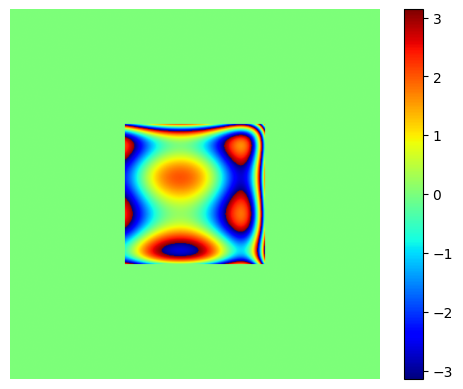

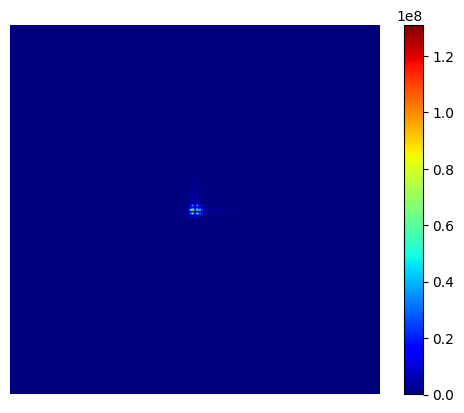

In [ ]:
pupil = make_wavefront(coef)
defocus = 0.0e-6
plt.imshow(np.angle(pupil),cmap="jet",vmax=np.pi, vmin=-np.pi)
plt.colorbar()
plt.axis('off')
plt.show()

psf2 = psf(pupil)
plt.imshow(np.abs(psf2),cmap="jet")
plt.colorbar()
plt.axis('off')
plt.show()

[0.0, 0.0, 0.0, -0.3031265159748233, 0.0, 0.7806994379010377, 1.548464858189961, 0.0, 0.0, -0.4217797091298186, 1.0479532455760954, 0.0, 0.0, 0.0, 0.38436350267429814, 0.4640245337771528, 0.0, 0.0, 0.0, 0.0, -1.1251267803313867, 0.17229470109724468, 0.0, 0.0, 0.0, 0.0, 0.0, -0.04219170862779768]


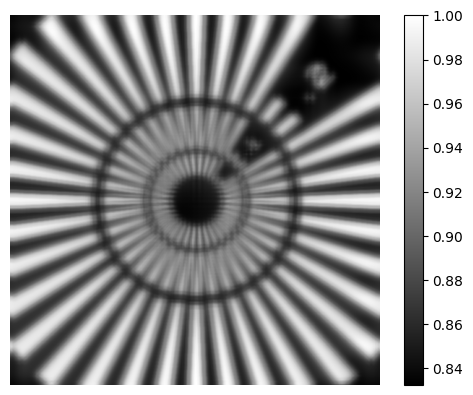

0.09139910593501072
0.8325102055920994


In [ ]:
# coef = [0.0]*28
print(coef)

pupil = make_wavefront(coef)
pupilFT = np.fft.fftshift(np.fft.fft2(pupil))

object_in = (np.abs(obA)**2).astype(np.complex128)
object_in_FT = np.fft.fftshift(np.fft.fft2(object_in))

pupilFT_H = ASM_tf(pupilFT, pixel_size, defocus, xlambda)

psfTest = (np.abs(pupilFT_H)**2).astype(np.complex128)
psfTest_FT = np.fft.ifftshift(np.fft.ifft2(np.fft.fftshift(psfTest)))
# psfTest_FT = np.fft.ifftshift(np.fft.ifft2(np.fft.fftshift(psfTest)))

OTF_A = np.abs(psfTest_FT)
OTF_A = OTF_A/np.max(OTF_A)
OTF_P = np.angle(psfTest_FT)
OTF = OTF_A*np.cos(OTF_P) + 1.0j*OTF_A*np.sin(OTF_P)

temp = object_in_FT
temp_x = np.real(temp)
temp_y = np.imag(temp)
OTF_x = np.real(OTF)
OTF_y = np.imag(OTF)

ims = (temp_x * OTF_x - temp_y * OTF_y) + 1.0j*(temp_x * OTF_y + temp_y * OTF_x)
est_field = np.fft.ifft2(ims)
# est_field = np.fft.ifftshift(np.fft.ifft2(np.fft.fftshift(ims)))
est_field = np.abs(est_field)/np.max(np.abs(est_field))
plt.imshow(np.abs(est_field), cmap="gray",vmax=1.0)
plt.colorbar()
plt.axis('off')
plt.show()
print((np.max(np.abs(est_field))-np.min(np.abs(est_field)))/(np.max(np.abs(est_field))+np.min(np.abs(est_field))))
print(np.min(np.abs(est_field)))



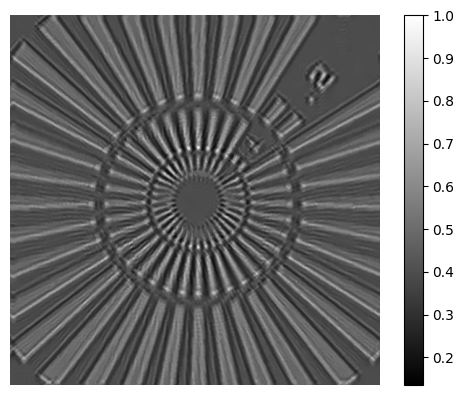

0.7616758266186666


In [ ]:
pupil = make_wavefront(coef)

rot_A = np.array(tfa.rotate(obA, tf.constant(-1.0 * 0.0)))
rot_P = np.array(tfa.rotate(obP, tf.constant(-1.0 * 0.0)))
# コヒーレント結像
object_img = rot_A * np.exp(rot_P * 1j)
object_imgFT = np.fft.fftshift(np.fft.fft2(object_img))
imSeqLowFT = object_imgFT * pupil
exp_field = np.fft.ifft2(np.fft.ifftshift(imSeqLowFT))


# 面ブレを考慮したデフォーカスを与える．
dz = defocus
exp_field = ASM_tf(exp_field, pixel_size, dz, xlambda)


exp_intensity = np.abs(exp_field)**2
exp_intensity = np.abs(exp_field)**2
scale = np.max(exp_intensity)
exp_intensity = photon * exp_intensity/scale
exp_intensity = np.abs(addGaussianNoise(exp_intensity))
exp_intensity = exp_intensity/photon*scale
#ノイズ除去
exp_intensity = np.expand_dims(exp_intensity, axis=-1)
sigma_est = np.mean(estimate_sigma(exp_intensity, channel_axis=-1))
patch_kw = dict(
    patch_size=5,  # 5x5 patches
    patch_distance=6,  # 13x13 search area
    channel_axis=-1,
)
# fast algorithm, sigma provided
exp_intensity = denoise_nl_means(
    exp_intensity, h=0.6 * sigma_est, sigma=sigma_est, fast_mode=True, **patch_kw
)
exp_intensity = np.array(tfa.rotate(exp_intensity, tf.constant(0.0)))
exp_intensity /= np.max(exp_intensity)
plt.imshow(exp_intensity, cmap="gray",vmax=1.0)
plt.colorbar()
plt.axis('off')
plt.show()
#

contrast = (np.max(exp_intensity) - np.min(exp_intensity))/(np.max(exp_intensity)+ np.min(exp_intensity))
print(contrast)

# シミュレーション条件の設定

In [ ]:
m = 512                 # 画像サイズ（横）
n = 512                 # 画像サイズ（縦）
rot_angle = 2*np.pi/90   # 1step回転角度
noise_flag = True       # ノイズを付与するかどうかのflag

xlambda = (12.4/9.884)*1e-10               # 波長. [m]
pixel_size = 16*1e-9                       # ピクセルサイズ. [m]
NA = 1.5e-3
thickness = 500.0e-9                       # スターチャート厚み. [m]
refraction = -1.96838E-05+4.074499E-06j    # 屈折率．Ta:9.884keV
coef_w = 6     # Legendre多項式の係数幅

photon = 500      # 光子数
max_shift = 6     # 位置ズレ最大. [pixel]
max_defocus = 50  # 最大面ブレ量. [um]

maxD    = 6                    # Legendre多項式の最大次数
mode = (maxD+1)*(maxD+2)//2     # Legendre modeの数
print("Legendre dimension, mode : ", str(maxD) + ", " + str(mode))

target = [random.uniform(0.0, coef_w)-coef_w/2 for i in range(10)]   # Legendre多項式の係数

coef = [0.0] * mode
coef[3], coef[5], coef[6], coef[9], coef[10], coef[14], coef[15], coef[20], coef[21], coef[27] = target
# coef[21], coef[27] = 2.0, 2.0

epoch = 3000    # 学習エポック数
tp = 100        # 描画エポック数
lr = 0.1        # 学習率

Legendre dimension, mode :  6, 28


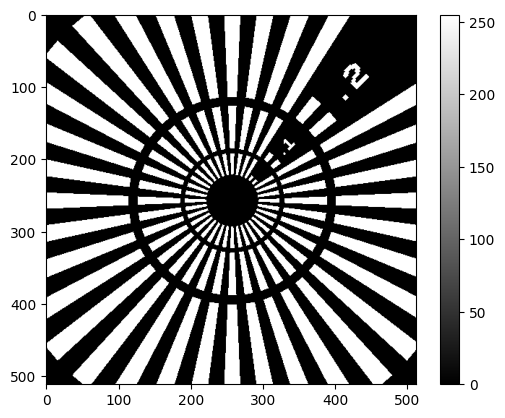

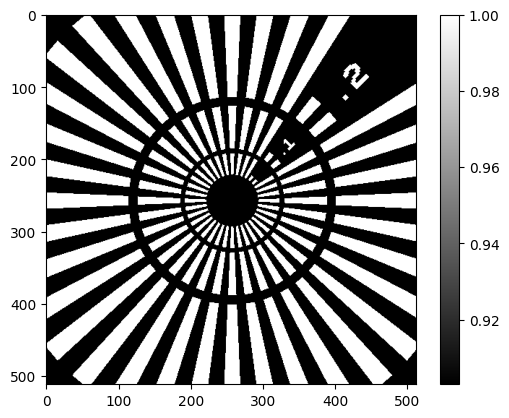

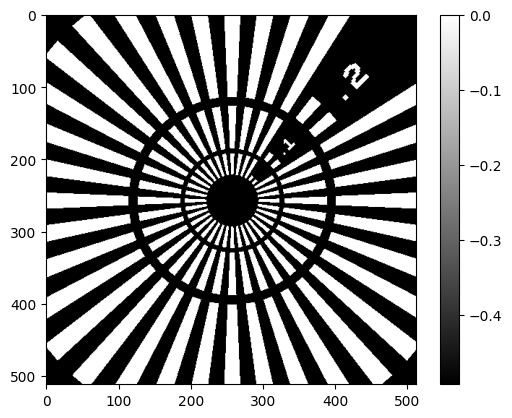

aperture [pix] :  195


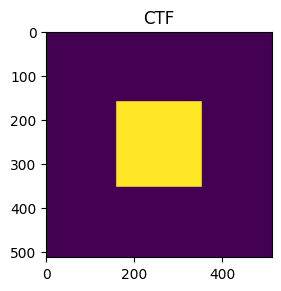

In [ ]:
# スターチャート画像の読み込み
img = np.array(Image.open("./image/50nm_star_512pix.tif"))
plt.imshow(img, cmap="gray")
plt.colorbar()
plt.show()
imax, jmax = img.shape
object_img = (img) / np.max(img)
object_img = np.where(object_img==0 , np.exp(1.0j * 2.0 * np.pi / xlambda * refraction * thickness), 1.0)
obA = np.abs(object_img)
obP = np.angle(object_img)
plt.imshow(obA,cmap="gray")
plt.colorbar()
plt.show()
plt.imshow(obP,cmap="gray")
plt.colorbar()
plt.show()

# 開口サイズの計算
aperture = pixel_size * m * 2.0 * np.tan(NA)/xlambda     # [pixel]
print("aperture [pix] : ", int(aperture))
seq = np.linspace(-1.0*n/aperture, 1.0*n/aperture, int(n))
# print(seq)


# 開口マスク作成
CTF = np.zeros((n,m))
CTF[n//2-int(aperture//2) : n//2+int(aperture//2),
    m//2-int(aperture//2) : m//2+int(aperture//2)] = 1.0
plt.subplot(1,2,1)
plt.title("CTF")
plt.imshow(CTF)
plt.show()



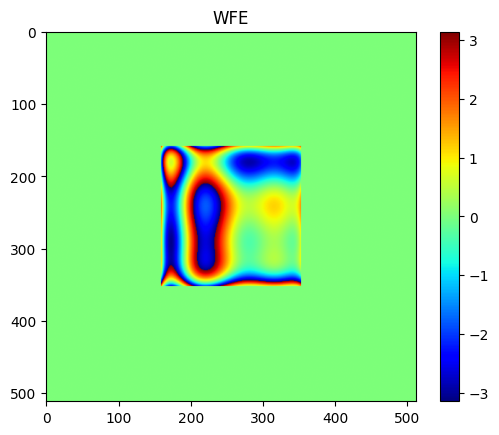

In [ ]:
# Legendre波面作成用メッシュグリッド
[x, y] = np.meshgrid(np.linspace(-1.0*n/aperture, 1.0*n/aperture, int(n)), np.linspace(-1.0*m/aperture, 1.0*m/aperture, int(m)))

# Legendre多項式の基底関数
B = legendreBasis2D(maxD, x, y)
# B = Legendre_basis(x,y)

# 瞳関数の作成
pupil = np.array(polyEval2D(coef, B)) * CTF
pupil = (np.cos(pupil) + 1.0j*np.sin(pupil)) * CTF
plt.title("WFE")
plt.imshow(np.angle(pupil),cmap="jet")
plt.colorbar()
plt.show()

# 平面波展開用メッシュグリッド（解析時）
dfx = 1.0 / (pixel_size * m)
dfy = 1.0 / (pixel_size * n)
fx = np.arange(-m/2, m/2) * dfx
fy = np.arange(-n/2, n/2) * dfy
fx = tf.constant(fx, dtype=tf.float32)
fy = tf.constant(fy, dtype=tf.float32)
fx_mesh, fy_mesh = tf.meshgrid(fx, fy)
fz2 = 1.0 / xlambda ** 2 - fx_mesh ** 2 - fy_mesh ** 2
fz2 = tf.where(fz2 > 0.0, fz2, 0.0)
fz = tf.sqrt(fz2)

B = Legendre_basis_6(x, y)

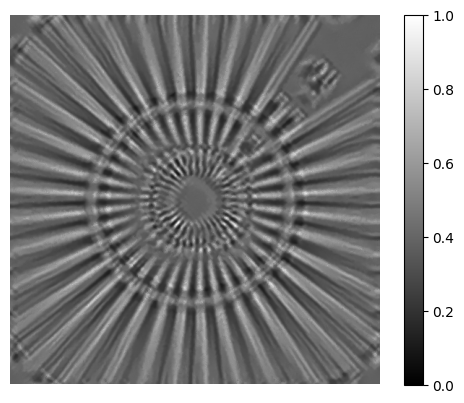

In [ ]:
img = img_coherent(pupil)

plt.imshow(img, cmap="gray",vmax=1.0, vmin=0.0)
plt.colorbar()
plt.axis('off')
plt.show()

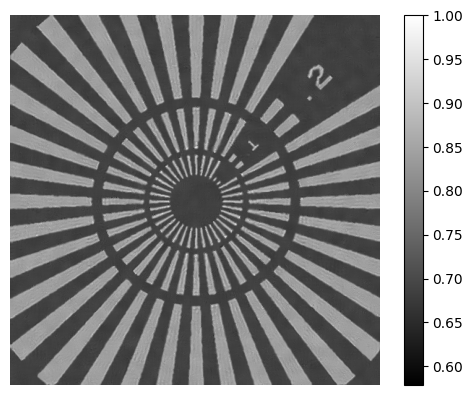

In [ ]:
coef = [0.0]*28
pupil = make_wavefront(coef)

img = img_coherent(pupil)

plt.imshow(img, cmap="gray")
plt.colorbar()
plt.axis('off')
plt.show()


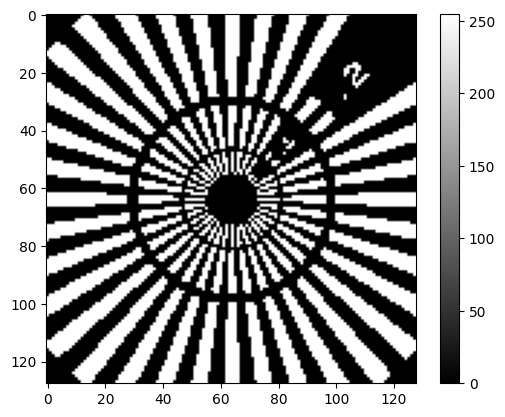

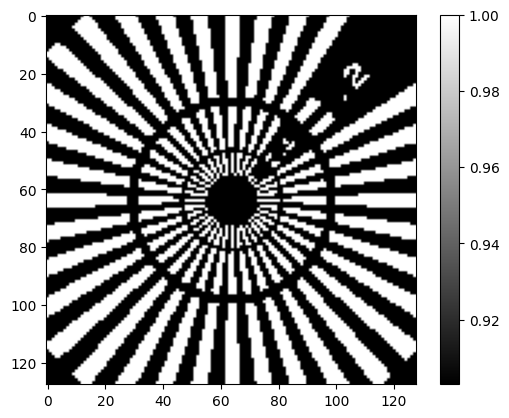

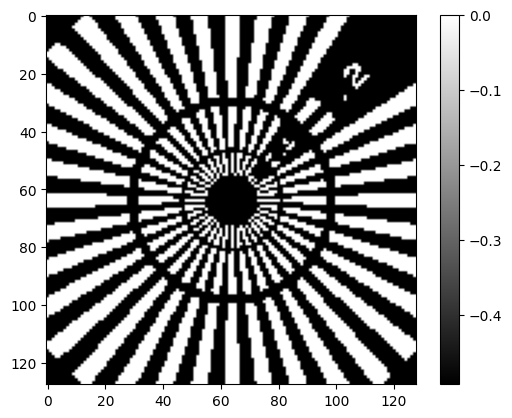

aperture [pix] :  48


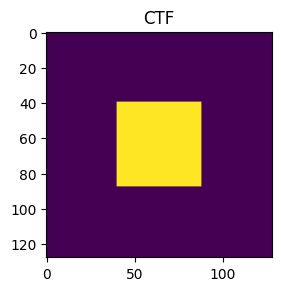

In [ ]:
# スターチャート画像の読み込み
img = Image.open("./image/50nm_star_512pix.tif")
img = img.resize((128, 128))
img = np.array(img)
plt.imshow(img, cmap="gray")
plt.colorbar()
plt.show()
imax, jmax = img.shape
object_img = (img) / np.max(img)
object_img = np.where(object_img==0 , np.exp(1.0j * 2.0 * np.pi / xlambda * refraction * thickness), 1.0)
obA = np.abs(object_img)
obP = np.angle(object_img)
plt.imshow(obA,cmap="gray")
plt.colorbar()
plt.show()
plt.imshow(obP,cmap="gray")
plt.colorbar()
plt.show()

# 開口サイズの計算
aperture = pixel_size * imax * 2.0 * np.tan(NA)/xlambda     # [pixel]
print("aperture [pix] : ", int(aperture))
seq = np.linspace(-1.0*jmax/aperture, 1.0*jmax/aperture, int(jmax))
# print(seq)


# 開口マスク作成
CTF = np.zeros((imax,jmax))
CTF[jmax//2-int(aperture//2) : jmax//2+int(aperture//2),
    imax//2-int(aperture//2) : imax//2+int(aperture//2)] = 1.0
plt.subplot(1,2,1)
plt.title("CTF")
plt.imshow(CTF)
plt.show()

